<a name='T'></a>

<p style="background-image: linear-gradient(to right, rgba(0, 0, 0, 0.5), rgba(0, 0, 0, 0.25)),
    url(https://cms.iqair.com/sites/default/files/blog/2021-01/CostofAir21_Desk_a.jpg);
    background-size: cover; 
    font-family: 'computermodern';
    font-size: 450%;
    color: #b9f7fa;
    text-align: center;
    border-radius: 10px 10px;
    padding: 30px; 
    box-shadow: 5px 5px 5px #333;
    line-height: 1.2;">
    Ozone (O3) AQI Trends in<br>
    High-Impact U.S. Regions <br>
    <small>Data From: 2000-2023</small>
    <br>
    <small style="font-size: 50%; line-height: 0;">
        Author: Math & Physics Fun With Gus $\qquad\qquad\qquad\qquad$ Date: December 18, 2023</small>
</p>
<div style="text-align: left; margin-top: -30px;">


# $\nabla$ <span style='border-left: 4px solid #A4D4D6; padding-left: 10px;'> Table of Contents </span>
1. [`Introduction`](#ES)
   * 1.1 [`Study Importance`](#studyimportance)
   * 1.2 [`Problem Statement`](#problemstatement)
   * 1.3 [`Focus & Objectives`](#focus)
   * 1.4 [`Summary & Main Findings`](#summaryfindings)
2. [`About The Data`](#data)
   * 2.1 [`Column Descriptions`](#columndescriptions)
   * 2.2 [`Monitoring Air Quality`](#sigmon)
   * 2.3 [`Focus & Objectives`](#focus)
   * 2.4 [`Health Impact of Pollutants`](#healthimpace)
3. [`Imports & Setup`](#imports)
    * 3.1 [`Data Manipulation Functions`](#DMF)
    * 3.2 [`Data Visualization Functions`](#DVF)
    * 3.3 [`Time Series Visualization Functions`](#TSAF)
    * 3.4 [`Machine Learning Model Functions`](#MLF)
    * 3.5 [`Importing Data`](#gettingdata)
4. [`Polution Slope Analysis`](#SA)
5. [`Address-Specific Data Analysis`](#ASEDA)
    * 5.1 [`Correlation on Addresses`](#coradd)
    * 5.2 [` Distributions of Pollutants at Addresse`](#distpopadd)
6. [`Exploratory Data Analysis By Year`](#EDAYEAR)
    * 6.1 [`Max USA Heatmap`](#usaheatmap)
7. [`Time Series Analysis`](#TS)
    * 7.1 [`Time Series Missing Recorded Values`](#missvalues)
    * 7.2 [`Time Series Analysis of Transformation`](#transformation)
    * 7.3 [`Decomposition - Time Frame Weekly`](#weekly)
    * 7.4 [`Stationarity Test on Columns`](#stationarity)
8. [`Time Series Modeling CO`](#TSCO)
    * 8.1 [`Modeling on All Data`](#sarimaxallco)
    * 8.2 [`Forecasting`](#coforecast)
    * 8.3 [`Forecast Against New Data`](#conewdata)
9. [`Time Series Modeling DC`](#TSDC)
    * 9.1 [`Modeling on All Data`](#alldc)
    * 9.2 [`Forecasting`](#dcforecast)
    * 9.3 [`Forecast Against New Data`](#dcnewdata)
10. [`Holt-Winters Verification`](#HW)
11. [`Conclusions`](#C)
    * 11.1 [`Summary of Findings`](#findings)
    * 11.2 [`Comparative Analysis`](#compare)
    * 11.3 [`Overall Project Impact`](#oimpact)
12. [`Bottom`](#B)

Author: [Math & Physics Fun with Gus](https://mathphysicsfunwithgus.square.site)


---

<a name='ES'>

# 1 <span style='border-left: 4px solid #A4D4D6; padding-left: 10px;'> Introduction </span>

Air pollution is a pressing public health concern that demands immediate action. Among various pollutants, Ground-level Ozone (O3) plays a pivotal role in this crisis. Elevated O3 levels contribute not only to acute respiratory conditions but also to long-term environmental degradation, such as harm to ecosystems and climate change. Ground-level O3 pollution is particularly concerning in the United States, where it affects the air quality across the country. In recent years, O3 pollution has been exacerbated by various factors, including wildfires that cause simultaneous increases in fine particulate matter and ground-level O3 through the direct emission of ozone precursor compounds in smoke plumes, particularly in the western United States[1]. Changes in regional climate and globally enhanced ozone are projected to increase ground-level ozone over most of the United States, with predictions indicating that the 95th percentile for daily 8-h maximum ozone would rise from 79 ppb in 2012 to 87 ppb in 2050 [2]. Timely monitoring and prediction of O3 levels are critical for targeted policy interventions to mitigate the adverse impacts on public health and the environment[3, 4].

***Note: I completed the notebook before the 2023 dataset was released, so I added a fun part using this update at the end.***

<a name='studyimportance'>
    
## 1.1 <span style='border-left: 4px solid #A4D4D6; padding-left: 10px;'> Importance of the Study </span> 

The urgency of tackling O3 pollution is highlighted by its rapid changes due to factors like temperature and sunlight. This study is designed to provide actionable insights by focusing on specific geographic locations that have experienced notable increases in O3 levels recently, such as `4545 Navajo St., CO` and `2500 1ST STREET, N.W. WASHINGTON DC`. This targeted strategy allows for more effective and immediate policy actions.

<a name='problemstatement'>
    
## 1.2 <span style='border-left: 4px solid #A4D4D6; padding-left: 10px;'> Problem Statement & Methodology </span>

### 1.2.1 <span style='border-left: 4px solid #A4D4D6; padding-left: 10px;'> Problem Statement </span>
Air pollution is an urgent and escalating public health issue, with Ground-level Ozone (O3) being a primary contributor to this crisis. Elevated levels of O3 not only exacerbate respiratory conditions but also contribute to long-term environmental degradation, including harm to ecosystems and climate change. Effective monitoring and prediction of O3 levels are critical for timely interventions by policymakers.

### 1.2.2 <span style='border-left: 4px solid #A4D4D6; padding-left: 10px;'> Proposal </span>

To combat the multi-faceted issue of O3 pollution, our project aims to analyze, model, and predict changes in AQI (Air Quality Index) levels of O3 at specific geographic locations that have experienced notable increases in O3 levels recently. This targeted approach will provide actionable insights for immediate policy reform.

### 1.2.3 <span style='border-left: 4px solid #A4D4D6; padding-left: 10px;'> Methodology </span>

Our goal is to analyze, model, and forecast changes in AQI (Air Quality Index) levels of O3 at the specific addresses mentioned earlier. We intend to employ a train-test split methodology to select the most effective time-series model for forecasting. The following models will be considered:

- **ARIMA (Autoregressive Integrated Moving Average)**: ARIMA is a widely-used statistical method for time series forecasting that can capture various patterns in temporal data. It's composed of three parts: autoregressive (AR), which uses the relationship between an observation and a number of lagged observations; integrated (I), which involves differencing the data to make it stationary; and moving average (MA), which uses the dependency between an observation and a residual error from a moving average model applied to lagged observations. ARIMA is best suited for data sets that show a clear trend or pattern over time, making it effective for long-term forecasting without seasonality.

- **SARIMAX (Seasonal Autoregressive Integrated Moving-Average with Exogenous Variables)**: This model extends ARIMA by adding support for seasonality and external variables. The seasonal part of the model accounts for seasonal variations or patterns that repeat at regular intervals, making it more applicable to data with clear seasonal trends. The exogenous component allows the model to incorporate the influence of external factors or independent variables that might affect the forecast variable. SARIMAX is highly useful in scenarios where both seasonal patterns and external influences play a significant role in the observed time series data.

- **Holt-Winters**: Also known as Triple Exponential Smoothing, this technique is well-suited for data with trends and seasonal patterns. Holt-Winters method decomposes the time series into three components: level (the average value in the series), trend (the increasing or decreasing value in the series), and seasonality (the repeating short-term cycle in the series). It then applies exponential smoothing to each of these components. The model is particularly effective for short-term forecasts where seasonality is a significant factor, and it can be adjusted to capture both additive and multiplicative seasonality, making it flexible for different types of seasonal patterns.


Through detailed modeling of O3 levels, we aim to develop a reliable forecasting tool. This tool will help understand and predict future O3 levels at targeted addresses, providing a data-driven basis for policy reforms. By pinpointing peak pollution times, our models aspire to facilitate timely interventions, contributing to the broader goal of mitigating the health and environmental impacts of O3 pollution.

<a name='focus'>
    
## 1.3 <span style='border-left: 4px solid #A4D4D6; padding-left: 10px;'> Focus & Objectives </span>
- **Public Health Impact**: O3, or ground-level ozone, is harmful to breathe and is especially a concern for certain vulnerable groups, including children, the elderly, and those with certain health conditions. An "F" grade from the American Lung Association signifies that the air quality in a particular area is poor due to high levels of ozone pollution. In recent years, over 100 million Americans have been living in areas with such poor air quality, marked by an "F" grade for ozone smog, which emphasizes the serious public health impact of O3 pollution[5][4].
- **Ease of Interpretation**: AQI serves as an easily interpretable and standardized metric[6].
- **Scientific Rigor**: Despite its simplicity, AQI is grounded in scientific research, offering a balance between comprehensibility and scientific accuracy[7].

### 1.3.1 <span style='border-left: 4px solid #A4D4D6; padding-left: 10px;'> Objectives and Expected Outcomes </span>

We aim to undertake the following steps to achieve a comprehensive understanding and forecasting capability of O3 levels at the specified addresses:

- **Comprehensive Exploratory Data Analysis (EDA)**:
    - **Data Distributions**: Conduct a comprehensive Exploratory Data Analysis (EDA) on AQI trends at these locations.
    - **Seasonal and Temporal Trend Evaluation**: Assess how pollution levels vary across different times of the day and year.
- **Modeling Objectives**: Employ a train-test split methodology to identify the most effective model for forecasting future O3 levels.
- **Forecasting and Intervention Recommendations**: Utilize the selected model to project future O3 levels at the targeted addresses, thereby informing potential regulatory interventions.

We expect the insights derived from this analysis to significantly aid policymakers, environmental agencies, and the general public in making informed and timely decisions to mitigate the adverse impacts of O3 pollution.

<a name='summaryfindings'>
    
## 1.4 <span style='border-left: 4px solid #A4D4D6; padding-left: 10px;'> Project Summary & Main Findings </span>

This project has provided a comprehensive analysis of ground-level Ozone (O3) Air Quality Index (AQI) levels at two specific locations: `4545 Navajo St., CO` and `2500 1ST STREET, N.W. WASHINGTON DC`. The study has utilized SARIMA modeling techniques to predict future O3 levels, yielding several key findings:

- **Colorado - `4545 Navajo St.`**: The SARIMA model indicated a clear seasonal pattern in O3 AQI levels, with peaks during warmer months. The model fitting suggested a good fit, capturing these seasonal effects accurately. Despite some volatility in ozone levels, the forecasts did not show a concerning long-term increase in O3 AQI levels.

- **Washington D.C. - `2500 1ST STREET, N.W.`**: In Washington D.C., the SARIMA model revealed a pattern of stability in O3 AQI levels with occasional seasonal peaks. The model was effective in predicting these fluctuations, although it also highlighted some unpredictability in ozone levels.

The comparative analysis of the SARIMAX models for both locations showed similar coefficient values, suggesting that similar atmospheric processes influence O3 levels at both sites. The stronger seasonal autoregressive terms in the D.C. model pointed to a more pronounced seasonal impact on O3 AQI in that area.

These findings have important implications for air quality management and policy-making. While the data does not suggest a need for immediate drastic changes in regulations, it underscores the importance of continuous monitoring and targeted interventions during peak pollution periods. This approach will be crucial for maintaining air quality and protecting public health, particularly in light of the identified seasonal trends and potential unpredictability in ozone levels.

---

<a name='data'>

# <b> 2 <span style='border-left: 4px solid #A4D4D6; padding-left: 10px;'> Overview of Data </b>
    
This dataset initially comprised approximately 665,414 observations across 21 columns. It has since been expanded to incorporate data up to the year 2023, offering a thorough historical overview of air quality in the United States. Collected from various sources such as the U.S. Environmental Protection Agency (EPA) and community contributors like Kaggler sogun3 and ANGELA KIM, this dataset continues to be updated. It covers the period from 2000 to 2023, making it an invaluable asset for ongoing research and analysis.

<a name='columndescriptions'>
    
## <b> 2.1 | Column Descriptions </b>

The dataset contains the following columns:

| Column Name       | Description  |
| ----------------- | ------------ |
| Date              | The date the data was collected. |
| Address           | The specific location where data was collected. |
| State             | The U.S. state where the data was collected. |
| County            | The county within the state where the data was collected. |
| City              | The city within the county where the data was collected. |
| O3 Mean           | The average Ozone (O3) level measured for that day. |
| O3 1st Max Value  | The highest Ozone level recorded in a single measurement for that day. |
| O3 1st Max Hour   | The hour when the highest Ozone level was recorded. |
| O3 AQI            | The Air Quality Index (AQI) for Ozone, which quantifies the level of pollution. |
| CO Mean           | The average Carbon Monoxide (CO) level measured for that day. |
| CO 1st Max Value  | The highest Carbon Monoxide level recorded in a single measurement for that day. |
| CO 1st Max Hour   | The hour when the highest Carbon Monoxide level was recorded. |
| CO AQI            | The Air Quality Index (AQI) for Carbon Monoxide, which quantifies the level of pollution. |
| SO2 Mean          | The average Sulphur Dioxide (SO2) level measured for that day. |
| SO2 1st Max Value | The highest Sulphur Dioxide level recorded in a single measurement for that day. |
| SO2 1st Max Hour  | The hour when the highest Sulphur Dioxide level was recorded. |
| SO2 AQI           | The Air Quality Index (AQI) for Sulphur Dioxide, which quantifies the level of pollution. |
| NO2 Mean          | The average Nitrogen Dioxide (NO2) level measured for that day. |
| NO2 1st Max Value | The highest Nitrogen Dioxide level recorded in a single measurement for that day. |
| NO2 1st Max Hour  | The hour when the highest Nitrogen Dioxide level was recorded. |
| NO2 AQI           | The Air Quality Index (AQI) for Nitrogen Dioxide, which quantifies the level of pollution. |

Each of these columns plays a role in understanding the air quality for specific locations and times.

<a name='sigmon'>

## <b> 2.2 <span style='border-left: 4px solid #A4D4D6; padding-left: 10px;'> Significance of Monitoring Air Quality </b>

Air quality pollution involves the presence of harmful substances in the atmosphere, which adversely affect human health and the environment. This dataset focuses on four primary pollutants: Nitrogen Dioxide (NO2), Sulphur Dioxide (SO2), Carbon Monoxide (CO), and Ozone (O3). Effective monitoring of air quality is paramount for both public health and environmental conservation. Accurate data empowers policy formulation, facilitates the understanding of temporal and spatial trends, and raises public awareness.

<a name='healthimpace'>
    
## <b> 2.3 <span style='border-left: 4px solid #A4D4D6; padding-left: 10px;'> Health and Environmental Impact of Pollutants </b>

- **Nitrogen Dioxide (NO2):** Elevated concentrations of NO2 can irritate the human respiratory system and are especially risky for individuals with asthma or other respiratory ailments. Chronic exposure may result in long-term respiratory diseases.

- **Sulphur Dioxide (SO2):** SO2 can chemically react in the atmosphere to produce fine particulate matter, which, when inhaled, can pose significant health risks. It disproportionately affects vulnerable populations such as young children, the elderly, and individuals with pre-existing heart or lung conditions.

- **Carbon Monoxide (CO):** High levels of CO can become life-threatening as they disrupt the blood's ability to transport oxygen, thus worsening pre-existing cardiovascular conditions.

- **Ozone (O3):** Although Ozone in the upper atmosphere shields us from harmful ultraviolet rays, its presence at ground level can lead to respiratory issues and compound existing chronic respiratory diseases like asthma[3].

The dataset can be accessed and downloaded from the following link: [`US Air Quality Data on Kaggle`](https://www.kaggle.com/datasets/guslovesmath/us-pollution-data-200-to-2022).


**References**<br>
[1]: Impact of wildfires on O3 pollution. [Science.org](https://www.science.org/doi/10.1126/sciadv.abi4892)  
[2]: Predicted changes in ground-level ozone in the US. [PubMed Central](https://www.ncbi.nlm.nih.gov/pmc/)  
[3]: Source: U.S. Environmental Protection Agency. "National Ambient Air Quality Standards (NAAQS)." [Ambient Air Quality](https://www.epa.gov/criteria-air-pollutants/naaqs-table)  
[4]: Health effects of ozone in the general population. [Health effects of ozone](https://www.epa.gov/ozone-pollution-and-your-patients-health/health-effects-ozone-general-population)  
[5]: Ozone Pollution Trends. [American Lung Association](https://www.lung.org/research/sota/city-rankings/most-polluted-cities)  
[6]: Ground-level Ozone Basics. [Ground-level Ozone](https://www.epa.gov/ground-level-ozone-pollution/ground-level-ozone-basics)  
[7]: AQI Basics. [AirNow.gov](https://www.airnow.gov/aqi/aqi-basics/) 


***

<a name='imports'>
    
# <b> 3 <span style='border-left: 4px solid #A4D4D6; padding-left: 10px;'>  Importing & Setup <b>

- The versions used for each library are listed below.
| Pandas | Numpy | Scikit-learn | Statsmodels | SciPy | Matplotlib | Plotly | Seaborn |
|--------|-------|--------------|-------------|-------|------------|--------|---------|
| 2.1.1  | 1.26.2| 1.3.1        | 0.14.0      | 1.11.3| 3.8.0      | 5.18.0 | 0.13.0  |




In [5]:
# Data Manipulation Imports
import pandas as pd
import numpy as np
import us # !pip install us

# Data Tests and Analysis
from sklearn.metrics import mean_squared_error
from statsmodels.tsa.seasonal import seasonal_decompose
from statsmodels.graphics.tsaplots import plot_acf, plot_pacf 
from statsmodels.tsa.stattools import adfuller

# Machine Leaning Models
from statsmodels.tsa.arima.model import ARIMA
from statsmodels.tsa.holtwinters import ExponentialSmoothing
import scipy.stats as ss

# Data visualization
import matplotlib.pyplot as plt
import plotly.express as px
import seaborn as sns 

In [6]:
# Global variables
FIGSIZE = (18, 10)
SEED = 123

# Seed for consistent results
np.random.seed(SEED)

# Data Visualization updates
plt.rcParams["figure.figsize"] = FIGSIZE
plt.rcParams.update({'font.size': 14})

pd.set_option('display.max_columns', None)
pd.set_option('display.precision', 4)

%config InlineBackend.figure_format = 'retina'

<a name='DMF'>
    
## <b> 3.1 <span style='border-left: 4px solid #A4D4D6; padding-left: 10px;'> Data Manipulation Functions <b>

- Below are functions built for data manipulation.

In [8]:
def compute_aggregations(df: pd.DataFrame, value_columns: list, time_column='Date', group_by_column='State', time_frame='Y', aggregation_func='mean'):
    """
    Parameters:
        df: DataFrame containing the data
        value_columns: the columns for which to compute the statistic
        time_column: the column containing datetime data
        group_by_column: the column by which to group data ('State', 'Address', etc.)
        time_frame: time frame to group by ('Y' for year, 'M' for month, etc.)
        aggregation_func: custom aggregation function (default is 'mean' as a string)

    Returns:
        grouped_df: DataFrame containing the aggregated values for each group
    """
    # Group by time frame and chosen column
    grouped_df = df.groupby([pd.Grouper(key=time_column, freq=time_frame), group_by_column])
    
    # Apply custom aggregation function
    grouped_df = grouped_df[value_columns].agg(aggregation_func).reset_index()
    return grouped_df

def create_address_dataframe(df: pd.DataFrame, n_values_column='Address'):
    """
    Create a DataFrame with three columns: 'state', 'n_addresses', and 'addresses'.

    Parameters:
        df (pd.DataFrame): The input DataFrame containing data.

    Returns:
        pd.DataFrame: A DataFrame with the specified columns.
    """
    state_addresses = []
    for state in df['State'].unique():
        only_state_data = df[df['State'] == state]
        unique_addresses = only_state_data[n_values_column].unique()
        state_addresses.append(unique_addresses)
    
    result_df = pd.DataFrame({'State': df['State'].unique(), 
                              f'N_{n_values_column}': [len(addrs) for addrs in state_addresses],
                              f'{n_values_column}': state_addresses})
    return result_df


def test_stationarity(df: pd.DataFrame, significance_level=0.05):
    """
    Performs the Augmented Dickey-Fuller test on each column of the dataframe
    to test for stationarity.

    Parameters:
        dataframe (DataFrame): The DataFrame on which to perform the test.
        significance_level (float): The significance level to determine stationarity.

    Returns:
        DataFrame: A DataFrame containing the results of the stationarity tests.
    """
    stationarity_results = {}

    for column in df.columns:
        if pd.api.types.is_numeric_dtype(df[column]):     # Ignoring non-numeric columns
            test_result = adfuller(df[column].dropna())
            
            # Extracting p-value & test statistic
            p_value = test_result[1]
            test_statistic = test_result[0]
            is_stationary = 'Yes' if p_value < significance_level else 'No'
            
            # Getting critical values
            critical_values = test_result[4]
            
            # Storing results
            stationarity_results[column] = {'Test Statistic': test_statistic,
                                            'p-value': p_value,
                                            'Is Stationary': is_stationary,
                                            'Critical Value 1%': critical_values['1%'],
                                            'Critical Value 5%': critical_values['5%'],
                                            'Critical Value 10%': critical_values['10%']}
    
    return pd.DataFrame(stationarity_results).transpose()

def missing_measurements(df: pd.DataFrame, col_time='Date', freq='D'):
    """
    Identify missing measurements in a DataFrame for a given time frequency.
    
    Parameters:
        df (DataFrame): The DataFrame to analyze.
        col_time (str): The name of the column containing the datetime information.
        freq (str): The frequency string representing the period of aggregation (e.g., 'D' for daily, 'W' for weekly).
    
    Returns:
        missing_periods (DatetimeIndex): A list of the starting dates of missing periods according to the specified frequency.
    """
    # Convert the col_time column to datetime if it's not already
    df[col_time] = pd.to_datetime(df[col_time])

    # Sort the DataFrame by the time column
    df_sorted = df.sort_values(col_time)

    # Group the data by the specified frequency
    df_grouped = df_sorted.set_index(col_time).groupby(pd.Grouper(freq=freq))

    # Getting first occurrence in each group to ensure group is not empty
    df_grouped = df_grouped.first()

    # Creating complete date range for specified frequency from start -> end of dataset
    full_range = pd.date_range(start=df_sorted[col_time].min(), end=df_sorted[col_time].max(), freq=freq)

    # Identify which periods from the range do not have any entries in  df's index
    missing_periods = full_range.difference(df_grouped.dropna().index)
    return missing_periods


def fill_dates_interpolate(df: pd.DataFrame, value_cols: list, date_col='Date', method='linear'):
    """
    Fills in missing dates in a DataFrame and interpolates the values for specified columns using a given method.
    
    Parameters:
        data (DataFrame): The input DataFrame with a date column and value columns to interpolate.
        date_col (str): The name of the date column in the DataFrame.
        value_cols (list): A list of column names for which to interpolate values.
        method (str): The interpolation method to use (default is 'linear').
    
    Returns:
        missing_dates (DataFrame): A DataFrame of the missing dates.
        updated_data (DataFrame, optional): The original DataFrame with missing dates filled in.
    """
    # Full date range
    full_date_range = pd.date_range(start=df[date_col].min(), end=df[date_col].max())
    
    # df with all dates in range
    complete_dates = pd.DataFrame(full_date_range, columns=[date_col])
    
    # Merging complete dates with original data
    complete_data = complete_dates.merge(df, on=date_col, how='left')
    
    # Identify missing dates
    missing_dates = complete_dates[ ~ complete_dates[date_col].isin(df[date_col])]
    
    # Fill in the missing values for the specified columns using the specified interpolation method
    for col in value_cols:
            complete_data[col] = complete_data[col].interpolate(method=method)
    # Returning missing dates & updated DataFrame
    return missing_dates, complete_data
    

<a name='DVF'>
    
## <b> 3.2 <span style='border-left: 4px solid #A4D4D6; padding-left: 10px;'> Data Visualization Functions <b>

- Below are functions built for data visualization.

In [10]:
def histo_plotter(df: pd.DataFrame, columns: list, nrow_cols=(4, 4),  bins=30, title='', fontsize=11, figsize=(18, 13)):
    """
    Plot histograms for each column in the DataFrame.

    Parameters:
        df (pd.DataFrame): The DataFrame containing the data.
        columns (list): The list of columns to plot.
        bins (int, optional): Number of bins. Defaults to 30.
        nrow_cols (int, optional): Number of rows and columns in the plot grid. Defaults to (4, 4).
    """
    colors = ['blue', 'orange', 'green', 'red', 'purple', 'brown', 'pink', 'gray', 'olive', 'cyan']
    
    # Plotting subplots
    fig, ax = plt.subplots(nrow_cols[0], nrow_cols[1], figsize=figsize)
    ax = ax.flatten()

    for i, column in enumerate(columns):
        # Colors for each histogram
        color = colors[i % len(colors)]
        data = df[column]
        
        # Calculate mean & standard deviation
        mean_value = data.mean()
        std_value = data.std()
        
        # Plotting histogram
        sns.histplot(data, bins=bins, kde=True, ax=ax[i], color=color)
        ax[i].set_title(f'{title} Distribution {column}', fontsize=fontsize)
        ax[i].legend([f'$\\mu$: {mean_value:.2f}\n$\\sigma$: {std_value:.2f}'], fontsize=9)
        
        # Mean & standard deviation
        ax[i].axvline(mean_value, color='k', linestyle='--')
        ax[i].axvline(mean_value + std_value, color='r', linestyle='--')
        ax[i].axvline(mean_value - std_value, color='r', linestyle='--')
        ax[i].set_xlabel(column, fontsize=fontsize*0.8)
        ax[i].set_ylabel('Count', fontsize=fontsize*0.8)
        ax[i].grid(alpha=0.2)

def plot_violinplots(df: pd.DataFrame, columns: list, nrow_cols=(4, 4), violin=False, title='', fontsize=10, figsize=(18, 13)):
    """
    Create violin plots for each column in the DataFrame.

    Parameters:
        df (pd.DataFrame): The DataFrame containing the data.
        columns (list): The list of columns to plot.
        single_plot (bool, optional): Whether to display all plots in a single figure. Defaults to False.
        nrow_cols (int, optional): Number of rows and columns in the plot grid. Defaults to (4, 4).
    """
    # List of colors for the plots
    colors = sns.color_palette("husl", len(columns))

    fig, ax = plt.subplots(nrow_cols[0], nrow_cols[1], figsize=figsize)
    ax = ax.flatten()
    for i, column in enumerate(columns):

        if violin:
            sns.violinplot(x=column, data=df, ax=ax[i], color=colors[i % len(colors)])
        else:
            sns.boxplot(x=column, data=df, ax=ax[i], color=colors[i % len(colors)])
        ax[i].set_title(f"{title}: {column}", fontsize=fontsize)
        ax[i].set_xlabel(column, fontsize=0.8*fontsize)
        ax[i].tick_params(axis='x', rotation=0, labelsize=0.8*fontsize)
        ax[i].grid(alpha=0.1)
    plt.tight_layout()
    plt.show()

def time_frame_plotter(df: pd.DataFrame, columns: list, aggregation_func='mean', 
                       title='', time_frames={'Weekly': 'W', 'Monthly': 'M'}, figsize=(24, 20)):
    """
    Plots time-based aggregations of specified columns from a given DataFrame.
    
    Parameters:
        df (DataFrame): The DataFrame containing the data.
        columns (list): List of columns for which to plot the data.
        aggregation_func (str, optional): Aggregation function to use. Default is 'mean'.
        time_frames (dict, optional): Dictionary containing time frame names and their Pandas frequency strings.
    
    Returns:
        None: The function displays the plots but does not return any value.
    """
    colors = ['C0', 'C1', 'C3', 'C4', 'C5', 'C6', 'C7', 'C8', 'C9']
    # Time frame names
    time_frame_name = list(time_frames.keys())
    time_frame_list = list(time_frames.values())

    # N_cols and N_rows
    ncols = len(time_frame_name) + 1
    nrows = len(columns)
    
    # Getting grouped by time data
    df_time_frame = {}
    for time_frame in time_frame_list:
        df_time_frame[time_frame] = compute_aggregations(df, value_columns=columns, time_frame=time_frame, aggregation_func=aggregation_func)
    
    if nrows == 1:
        fig, ax = plt.subplots(nrows=nrows, ncols=ncols, figsize=figsize, squeeze=False) # Only one row, make sure ax is 2D
    else:
        fig, ax = plt.subplots(nrows=nrows, ncols=ncols, figsize=figsize)

    # Plotting
    for i, col in enumerate(columns):
        # Data Steps
        ax[i, 0].plot(df['Date'], df[col], color='C2', marker='.', alpha=0.3, label='Daily Data')
        ax[i, 0].set_title(f'Daily {col} Levels {title}')
        ax[i, 0].set_xlabel('Date')
        ax[i, 0].set_ylabel(f'{col}')
        ax[i, 0].grid(alpha=0.25)
        ax[i, 0].legend()
        
        # Time Frame aggregation plotter
        j = 1
        for name, frame in zip(time_frame_name, time_frame_list):
            ax[i, j].plot(df_time_frame[frame]['Date'], df_time_frame[frame][col], color=colors[j], marker='.', alpha=0.5, label=f'{name} Data')
            ax[i, j].set_title(f'{name} {col} Levels {title}')
            ax[i, j].set_xlabel('Date')
            ax[i, j].set_ylabel(f'{col}')
            ax[i, j].grid(alpha=0.25)
            ax[i, j].legend()
            j += 1 
    plt.tight_layout()
    plt.show()

def model_error_analysis(data, predicted, title='', color='C0'):
    """
    Perform error analysis on a model's predictions by plotting a histogram of residuals, 
    a QQ-normal plot, and scatter plots of residuals against predicted values and index.
    
    Parameters:
        data (Series or ndarray): The actual observed values.
        predicted (Series or ndarray): The predicted values generated by the model.
    
    Returns:
        rmse (float): The root mean square error of the model's predictions.
    """
    # Calculate residuals
    residuals = data - predicted
    index = data.index
    rmse = np.sqrt(np.mean(residuals**2))
    
    # Plot for histogram, QQ-Normal, residuals vs. predicted, & residuals vs. index
    fig, ax = plt.subplots(1, 4, figsize=(24, 6))  # Adjust for 4 subplots
    
    # Histogram of residuals
    sns.histplot(residuals, bins=20, kde=True, color=color, ax=ax[0])
    ax[0].set_title(f'Histogram of Residuals {title}')
    ax[0].set_xlabel('Residuals')
    ax[0].set_ylabel('Frequency')
    
    # QQ-Normal of residuals
    ss.probplot(residuals, dist="norm", plot=ax[1])
    ax[1].set_title(f'QQ-Normal Plot {title}')
    
    # Residuals vs. predicted values
    sns.scatterplot(x=predicted, y=residuals, ax=ax[2], color=color)
    ax[2].set_title(f'Residuals vs. Predicted {title}')
    ax[2].axhline(2*rmse, color='r', linestyle='--')
    ax[2].axhline(-2*rmse, color='r', linestyle='--')
    ax[2].set_xlabel('Predicted Values')
    ax[2].set_ylabel('Residuals')
    ax[2].axhline(y=0, color='r')
    
    # Residuals vs. index (time or sequence)
    sns.scatterplot(x=index, y=residuals, ax=ax[3], color=color)
    ax[3].set_title(f'Residuals over Index {title}')
    ax[3].axhline(2*rmse, color='r', linestyle='--')
    ax[3].axhline(-2*rmse, color='r', linestyle='--')
    ax[3].set_xlabel('Index')
    ax[3].set_ylabel('Residuals')
    ax[3].axhline(y=0, color='r')
    plt.tight_layout()
    plt.show()
    return rmse
    

<a name='TSAF'>
    
## <b> 3.3 <span style='border-left: 4px solid #A4D4D6; padding-left: 10px;'> Time Series Visualization Analysis Functions <b>

- Below are functions built for time series data analysis and visualization.

In [12]:
def transform_data(df, predicted, index_start=0, transformation=np.square, 
                   val_col='O3 AQI', date_col='Date',
                   title='', xlabel='time', ylabel='observation', figsize=(15, 6.5), lags=0):
    """
    Apply a transformation to predicted values, calculate residuals and mean squared error, 
    and plot the original and predicted values with the option to plot ACF and PACF for residuals.

    Parameters:
        df (DataFrame): The original dataset containing the observed values.
        predicted (array): Predicted values from the model before transformation.
        index_start (int): The starting index from which to calculate residuals and plot predictions.
        transformation (function): The function to apply to the predicted values (default is np.square).
        val_col (str): The name of the column in 'df' that contains the observed values (default is 'O3 AQI').
        date_col (str): The name of the column in 'df' that contains the date information (default is 'Date').
        lags (int): The number of lags for which to plot the ACF and PACF (default is 0, which skips plotting).

    Returns:
        mse (float): The mean squared error of the residuals.
        transformed_predicted (array): The predicted values after applying the transformation.
    """
    transformed_predicted = transformation(predicted)
    residuals = df[val_col][index_start:] - transformed_predicted
    mse = np.mean(residuals**2)
    plt.figure(figsize=figsize)
    plt.plot(df[date_col], df[val_col], color='C9', label=f'{val_col}')
    plt.plot(df[date_col][index_start:], transformed_predicted, color='C3', label=f'Predicted {val_col}\nMSE={mse:0.2f}')
    plt.title(title)
    plt.ylabel(ylabel)
    plt.xlabel(xlabel)
    plt.legend(fontsize=10)
    plt.grid(alpha=0.25)
    plt.show()

    # Plot ACF & PACF of residuals
    if lags > 0:
        fig, ax = plt.subplots(ncols=2, figsize=(15, 5))
        plot_acf(residuals, lags=lags, color='red', ax=ax[0])
        ax[0].set_title('Autocorrelation Function of Residuals')
        ax[0].grid(alpha=0.2)
        
        plot_pacf(residuals, lags=lags, color='blue', ax=ax[1])
        ax[1].set_title('Partial Autocorrelation Function of Residuals')
        ax[1].grid(alpha=0.2)
        plt.tight_layout()
    return mse, transformed_predicted
    
def ACF_frame_plotter(df: pd.DataFrame, columns: list, lags=40, aggregation_func='mean', title='', time_frames={'Daily': 'D'}, figsize=(18, 5)):
    """
    Plots time-based aggregations of specified columns from a given DataFrame.
    
    Parameters:
        df (DataFrame): The DataFrame containing the data.
        columns (list): List of columns for which to plot the data.
        aggregation_func (str, optional): Aggregation function to use. Default is 'mean'.
        title (str, optional): Title to include in the plots. Default is an empty string.
        time_frames (dict, optional): Dictionary containing time frame names and their Pandas frequency strings.
    
    Returns:
        None: The function displays the plots but does not return any value.
    """
    time_frame_name = list(time_frames.keys())
    time_frame_list = list(time_frames.values())
    
    # Getting grouped by time data
    df_time = compute_aggregations(df, value_columns=columns, time_frame=time_frame_list[0], aggregation_func=aggregation_func)
    
    # Create subplots
    nrows = len(columns)
    ncols = 2
    
    if nrows == 1:
        fig, ax = plt.subplots(nrows=nrows, ncols=ncols, figsize=figsize, squeeze=False) # Only one row, make sure ax is 2D  
    else:
        fig, ax = plt.subplots(nrows=nrows, ncols=ncols, figsize=figsize)
    
    for i, col in enumerate(columns):
        # ACF
        plot_acf(df_time[col], color='blue', lags=lags, ax=ax[i, 0])
        ax[i, 0].set_title(f'ACF {time_frame_name[0]} {col} Levels {title}')
        ax[i, 0].grid(alpha=0.25)
        # PACF
        plot_pacf(df_time[col], color='green', lags=lags, ax=ax[i, 1])
        ax[i, 1].set_title(f'PACF {time_frame_name[0]} {col} Levels {title}')
        ax[i, 1].grid(alpha=0.25)  
    plt.tight_layout()
    plt.show()

def seasonal_decompose_plotter(df: pd.DataFrame, col='sqrt(O3 AQI)', date_col='Date', title='', period=12, figsize=(20, 12)):
    """
    Perform and plot seasonal decomposition of a time series.

    Parameters:
        df: DataFrame with time series data.
        col: Column name for data to decompose. Default is 'sqrt(O3 AQI)'.
        date_col: Column name for datetime values. Default is 'Date'.
        period: Seasonality period. Default is 12.

    Returns:
        A DecomposeResult object with seasonal, trend, and residual components.
    """
    # Decompostion
    decomposition = seasonal_decompose(df[col], period=period)
    de_season = decomposition.seasonal
    de_resid = decomposition.resid
    de_trend = decomposition.trend

    fig, ax = plt.subplots(4, sharex=True, figsize=figsize)
    ax[0].set_title(title)
    ax[0].plot(df[date_col], df[col], color='C3')
    ax[0].set_ylabel(col)
    ax[0].grid(alpha=0.25)
    
    ax[1].plot(df[date_col], de_trend, color='C1')
    ax[1].set_ylabel('Trend')
    ax[1].grid(alpha=0.25)
    
    ax[2].plot(df[date_col], de_season, color='C2')
    ax[2].set_ylabel('Seasonal')
    ax[2].grid(alpha=0.25)

    ax[3].axhline(y=0, color='k', linewidth=1)
    ax[3].scatter(df[date_col], de_resid, color='C0', s=10)
    ax[3].set_ylabel('Resid')
    ax[3].grid(alpha=0.25)
    plt.tight_layout(h_pad=0)
    plt.show()
    return decomposition

def forcast_SARIMAX(model_fit, data, transformation=np.square, steps=10, val_col='O3 AQI', date_col='Date', 
                    title='', xlabel='time', ylabel='O3 AQI', figsize=(15, 6)):
    """
    Forecast future values using a fitted SARIMAX model and plot the results with confidence intervals.

    Parameters:
        model_fit (SARIMAX.fit()): The fitted SARIMAX model object from statsmodels.
        data (DataFrame): The dataset containing the historical observations.
        transformation (function): A function to apply to the forecasted values and confidence intervals for back-transformation. Default is np.square.
        steps (int): The number of steps or periods to forecast ahead. Default is 10.
        val_col (str): The name of the column in 'data' that contains the observations. Default is 'O3 AQI'.
        date_col (str): The name of the column in 'data' that contains the date information. Default is 'Date'.

    Returns:
        data_forecast (DataFrame): A DataFrame containing the forecasted values, dates, and confidence intervals.
    """
    # Getting forecast & confidence intervals for test set
    forecast_results = model_fit.get_forecast(steps=steps)
    
    forecast_transformed = transformation(forecast_results.predicted_mean)
    conf_int = transformation(forecast_results.conf_int())
    conf_int_lower = conf_int.iloc[:, 0]
    conf_int_upper = conf_int.iloc[:, 1]
    
    # Forecast index note we need the date to start after, thus + 1 in steps and [1:] slice
    fore_index = pd.date_range(start=data[date_col].iloc[-1], periods=steps + 1, freq='W')[1:]
    
    # Plotting training, test, & predictions
    plt.figure(figsize=figsize)
    plt.plot(data[date_col], data[val_col], color='C9', marker='.', linestyle='--', label=f'{val_col} Data')
    
    plt.plot(fore_index, forecast_transformed, 'C3', marker='.', linestyle='--', label=f'Forecast')
    plt.fill_between(fore_index, conf_int_lower, conf_int_upper, color='C4', alpha=0.1)
    
    plt.title(title if title else 'SARIMA - Forecast with CI')
    plt.legend(loc='upper left', fontsize=10)
    plt.grid(alpha=0.25)
    plt.show()

    data_forecast = pd.DataFrame({
        'Date': fore_index,
        f'Forecast_{val_col}': forecast_transformed,
        'CI Lower': conf_int_lower,
        'CI Upper': conf_int_upper,
    })
    return data_forecast
    

<a name='MLF'>
    
## <b> 3.4 <span style='border-left: 4px solid #A4D4D6; padding-left: 10px;'> Machine Learning Model Functions <b>

- Below are machine learning model and anylsis functions.

In [14]:
def group_linregress(df: pd.DataFrame, date_col: str, by: list, columns: list):
    """
    Calculate the slope and y-intercept for each specified column with respect to the date column,
    grouped by the columns specified in the 'by' parameter.
    
    Parameters:
        df (pd.DataFrame): The input DataFrame containing the data.
        date_col (str): The column containing the dates.
        by (list): The list of columns by which to group the DataFrame.
        columns (list): The list of columns for which the slope and y-intercept are to be calculated.
    
    Returns:
        pd.DataFrame: A DataFrame containing the slope and y-intercept for each specified column,
                        grouped by the columns specified in the 'by' parameter.
    """
    # Copying dataframe
    df = df.copy()
    
    # Initializing list for results
    linregress_results = []
    
    # Convert date to ordinal numbers for linear regression
    df['Date_ordinal'] = pd.to_datetime(df[date_col]).apply(lambda x: x.toordinal())
    
    # Grouping dataframe
    grouped_df = df.groupby(by)
    
    for name, group in grouped_df:
        for column in columns:
            
            # linear regression
            slope, intercept, _, _, _ = ss.linregress(group['Date_ordinal'], group[column])
            
            # Dictionary of results and the group identifiers
            result = {'Column': column, 'by': name, 'Slope': slope, 'Intercept': intercept}
            
            # Appending dictionary to list
            linregress_results.append(result)
    
    # Converting to DataFrame
    linregress_df = pd.DataFrame(linregress_results)
    return linregress_df

def train_test_SARIMA_evaluate(data, 
                               order,
                               seasonal_order=(0, 0, 0, 0), 
                               train_ratio=0.9, 
                               date_col='Date', 
                               val_col='O3 AQI',
                               show_summary=False,
                               title='',
                               figsize=(15, 6.5),
                               lags=0):
    """
    Fit and evaluate a SARIMA model with train-test split and plot forecast with confidence intervals.
    
    Parameters:
        data (pandas DataFrame): Time series data
        order (tuple): ARIMA order (p, d, q)
        seasonal_order (tuple, optional): Seasonal order (P, D, Q, S)
        train_ratio (float, optional): Proportion of data used for training
        date_col (str, optional): Name of the date column in the DataFrame
        val_col (str, optional): Name of the value column in the DataFrame
        lags (int, optional): Number of lags for ACF and PACF plots
        show_summary (bool, optional): Whether to print model summary
    
    Returns:
        mse_train (float): Mean squared error of the model on training data
        mse_test (float): Mean squared error of the model on testing data
        model_fit (object): Fitted model object
    """    
    # Split data into train & test sets
    cutoff = int(len(data) * train_ratio)
    train_data = data.iloc[:cutoff]
    test_data = data.iloc[cutoff:]

    index_start = max(order[1], seasonal_order[1] * seasonal_order[3])
    
    # Fitting SARIMA model on training data
    model = ARIMA(train_data[val_col], order=order, seasonal_order=seasonal_order)
    model_fit = model.fit()
    
    # Getting predictions & MSE for training set
    predictions_train = model_fit.predict(start=train_data.index[order[1]], end=train_data.index[-1])
    residuals = train_data[val_col][index_start:] - predictions_train[index_start:]
    mse_train = np.mean(residuals**2)
    
    # Getting forecast & confidence intervals for test set
    forecast_results = model_fit.get_forecast(steps=len(test_data))
    forecast = forecast_results.predicted_mean
    conf_int = forecast_results.conf_int()
    mse_test = np.mean((test_data[val_col] - forecast)**2)
    
    # Show the model summary
    if show_summary:
        display(model_fit.summary())
    
    # Plotting training, test, & predictions
    plt.figure(figsize=figsize)
    plt.plot(train_data[date_col], train_data[val_col], color='C0', label='Training Data')
    plt.plot(test_data[date_col], test_data[val_col], color='C9', label='Test Data')
    
    plt.plot(train_data[date_col][index_start:], predictions_train[index_start:], 'C2--', label=f'Predictions Train: MSE={mse_train:.2f}')
    plt.plot(test_data[date_col], forecast, 'C3--', label=f'Forecast: MSE={mse_test:.2f}')
    plt.fill_between(test_data[date_col], conf_int.iloc[:, 0], conf_int.iloc[:, 1], color='C4', alpha=0.1)
    
    plt.title(title if title else 'SARIMA - Train, Test, & Forecast with CI')
    plt.legend(fontsize=10)
    plt.grid(alpha=0.25)
    plt.show()
    
    # Plotting ACF & PACF for residuals if lags are specified
    if lags > 0:
        fig, ax = plt.subplots(1, 2, figsize=(15, 5))
        plot_acf(residuals, color='red', lags=lags, ax=ax[0])
        ax[0].grid(alpha=0.25)
        
        plot_pacf(residuals, color='blue', lags=lags, ax=ax[1])
        ax[1].grid(alpha=0.25)
        plt.show()
    return mse_train, mse_test, model_fit

def check_causality_invertibility(model_fit):
    """
    Check the causality and invertibility of the ARIMA model.

    Parameters:
        model_fit: A fitted ARIMA model object from statsmodels.

    Returns:
        ar_causality (bool): True if the AR part is causal, False otherwise.
        ma_invertibility (bool): True if the MA part is invertible, False otherwise.
    """
    # Check for causality (AR part)
    # A causal AR process requires all roots of the characteristic polynomial to be outside the unit circle.
    ar_roots = model_fit.arroots
    ar_causality = np.all(np.abs(ar_roots) > 1)
    
    # Check for invertibility (MA part)
    # An invertible MA process requires all roots of the characteristic polynomial to be outside the unit circle.
    ma_roots = model_fit.maroots
    ma_invertibility = np.all(np.abs(ma_roots) > 1)
    
    return ar_causality, ma_invertibility

def holt_winters_forecast(data, val_col='O3 AQI', date_col='Date',
                          forecast_steps=52, figsize=(12, 6), **kwargs):
    """
    Fits a Holt-Winters model with flexible keyword arguments, calculates 
    Mean Squared Error (MSE) for the training data and forecasted values.

    Parameters:
    data (DataFrame): Time series data.
    **kwargs: Additional keyword arguments passed to ExponentialSmoothing.

    Returns:
    Tuple of (model, mse)
    """
    # Setting date as index
    data = data[[date_col, val_col]]
    
    # Fit the model with additional keyword arguments
    model = ExponentialSmoothing(data[val_col], **kwargs).fit()

    # Forecasting
    forecast = model.forecast(forecast_steps)

    # Calculate MSE for training
    train_forecast = model.fittedvalues
    train_mse = np.mean((data[val_col] - train_forecast)**2)

    forecast_index = pd.date_range(start=data[date_col].iloc[-1], periods=forecast_steps+1, freq='W')[1:]
    
    # Plot the results
    plt.figure(figsize=figsize)
    plt.plot(data['Date'], data[val_col], label='Train Data')
    plt.plot(data['Date'], train_forecast, alpha=0.75, label=f'Model Fit (MSE: {train_mse:.2f})')
    
    plt.plot(forecast_index, forecast, label=f'Forecast', color='red')
    
    plt.title('O3 AQI Forecast with Holt-Winters Model')
    plt.xlabel('Date')
    plt.ylabel('O3 AQI')
    plt.legend(fontsize=10)
    plt.grid(alpha=0.25)
    plt.show()
    return model, train_mse 

***

<a name='gettingdata'>
    
## <b> 3.5 <span style='border-left: 4px solid #A4D4D6; padding-left: 10px;'>  Importing Data <b>

- From my import of `us.states.STATES`, the District of Columbia was missing. Due to this, I manually added it to ensure that all state columns now use abbreviations rather than the full names.
    
- Note, after completing this notebook, the 2023 data was released. I updated this data and published the 2000-2023 dataset. I forecasted 52 weeks ahead from 2022, where the last data point in regards to the orignal measurements is `2022-07-31`. We will split the data at this date and save all data past this date to test how accurate my predictions actaully were.

In [16]:
# Importing data set
df_whole = pd.read_csv('pollution_2000_2023.csv', index_col=0)
df_whole.Date = pd.to_datetime(df_whole.Date)

# Remove leading and trailing spaces from string before mappings
cols_to_strip = ['Address', 'State', 'County', 'City']
df_whole[cols_to_strip] = df_whole[cols_to_strip].apply(lambda x: x.str.strip())

# Getting state to abbreviation dictionary
state_abbreviation_map = {state.name: state.abbr for state in us.states.STATES}

# Looking for missing state name
for value in df_whole.State.unique():
    if value not in state_abbreviation_map.keys():
        print(f'Missing: {value}')

# Abbrivating state names and adding D.C
state_abbreviation_map['District Of Columbia'] = 'DC' # adding washington D.C.

# Mapping stats to abbreviation
df_whole['State'] = df_whole['State'].map(state_abbreviation_map)

# Updated data split for testing
df_test = df_whole[df_whole['Date'] > '2022-07-31'].copy()

# Approximetly the original dataset
df = df_whole[df_whole['Date'] <= '2022-07-31'].copy()

# Showing updated dataframe
display(df.head())

Missing: District Of Columbia


,Date,Address,State,County,City,O3 Mean,O3 1st Max Value,O3 1st Max Hour,O3 AQI,CO Mean,CO 1st Max Value,CO 1st Max Hour,CO AQI,SO2 Mean,SO2 1st Max Value,SO2 1st Max Hour,SO2 AQI,NO2 Mean,NO2 1st Max Value,NO2 1st Max Hour,NO2 AQI
0,2000-01-01,1645 E ROOSEVELT ST-CENTRAL PHOENIX STN,AZ,Maricopa,Phoenix,0.0198,0.040,10,37,0.8789,2.2,23,25.0,3.0000,9.0,21,13.0,19.0417,49.0,19,46
1,2000-01-02,1645 E ROOSEVELT ST-CENTRAL PHOENIX STN,AZ,Maricopa,Phoenix,0.0159,0.032,10,30,1.0667,2.3,0,26.0,1.9583,3.0,22,4.0,22.9583,36.0,19,34
2,2000-01-03,1645 E ROOSEVELT ST-CENTRAL PHOENIX STN,AZ,Maricopa,Phoenix,0.0094,0.016,9,15,1.7625,2.5,8,28.0,5.2500,11.0,19,16.0,38.1250,51.0,8,48
3,2000-01-04,1645 E ROOSEVELT ST-CENTRAL PHOENIX STN,AZ,Maricopa,Phoenix,0.0159,0.033,9,31,1.8292,3.0,23,34.0,7.0833,16.0,8,23.0,40.2609,74.0,8,72
4,2000-01-05,1645 E ROOSEVELT ST-CENTRAL PHOENIX STN,AZ,Maricopa,Phoenix,0.0074,0.012,9,11,2.7000,3.7,2,42.0,8.7083,15.0,7,21.0,48.4500,61.0,22,58


In [17]:
# Getting certain columns names for EDA later
columns_of_interest = ['Date', 'State'] + list(df.columns)[5:-3]
numeric_columns = [column for column in df.columns if np.issubdtype(df[column].dtype, np.number)]
aqi_columns = list(df.columns)[0:5] + [column for column in df.columns if 'AQI' in column]

# Looking at time and states in dataset
print(f'Years in the data set:\n{set(df.Date.dt.year)}\n')
print(f'States in the data set:\n{set(df.State)}')

Years in the data set:
{2000, 2001, 2002, 2003, 2004, 2005, 2006, 2007, 2008, 2009, 2010, 2011, 2012, 2013, 2014, 2015, 2016, 2017, 2018, 2019, 2020, 2021, 2022}

States in the data set:
{'CO', 'DC', 'HI', 'AR', 'ID', 'DE', 'LA', 'WY', 'CA', 'ME', 'RI', 'NM', 'KS', 'MO', 'NY', 'UT', 'VA', 'MD', 'KY', 'FL', 'SC', 'PA', 'MN', 'AZ', 'NJ', 'OR', 'TN', 'WA', 'IA', 'AL', 'OK', 'AK', 'MS', 'NC', 'TX', 'NV', 'IN', 'CT', 'ND', 'SD', 'NH', 'WI', 'OH', 'IL', 'GA', 'MI', 'MA', 'VT'}


In [18]:
# Adding time features
df['Year'] = df['Date'].dt.year
df['Month'] = df['Date'].dt.month
df['Day'] = df['Date'].dt.day

display(df.head(3))

,Date,Address,State,County,City,O3 Mean,O3 1st Max Value,O3 1st Max Hour,O3 AQI,CO Mean,CO 1st Max Value,CO 1st Max Hour,CO AQI,SO2 Mean,SO2 1st Max Value,SO2 1st Max Hour,SO2 AQI,NO2 Mean,NO2 1st Max Value,NO2 1st Max Hour,NO2 AQI,Year,Month,Day
0,2000-01-01,1645 E ROOSEVELT ST-CENTRAL PHOENIX STN,AZ,Maricopa,Phoenix,0.0198,0.040,10,37,0.8789,2.2,23,25.0,3.0000,9.0,21,13.0,19.0417,49.0,19,46,2000,1,1
1,2000-01-02,1645 E ROOSEVELT ST-CENTRAL PHOENIX STN,AZ,Maricopa,Phoenix,0.0159,0.032,10,30,1.0667,2.3,0,26.0,1.9583,3.0,22,4.0,22.9583,36.0,19,34,2000,1,2
2,2000-01-03,1645 E ROOSEVELT ST-CENTRAL PHOENIX STN,AZ,Maricopa,Phoenix,0.0094,0.016,9,15,1.7625,2.5,8,28.0,5.2500,11.0,19,16.0,38.1250,51.0,8,48,2000,1,3



### <b> 3.2.1 <span style='border-left: 4px solid #A4D4D6; padding-left: 10px;'> Data Preparation Summary </b>

1. **Data Cleaning:**
   - Checked for missing values: No missing values were found in the dataset.

2. **Understanding the Data:**
   - Analyzed the key metrics of our pollution dataset and observed some considerable variance in the data.

3. **Data Transformation:**
   - Confirmed that the data is in units suitable for analysis.

4. **Feature Engineering:**
   - Extracted `Year`, `Month`, and `Day` from the `Date` column to capture both seasonal and long-term trends in the data.

---


<a name='SA'>
    
# <b> 4 <span style='border-left: 4px solid #A4D4D6; padding-left: 10px;'> Polution Slope Analysis <b>

- The goal is to identify the two primary locations that have experienced a significant increase in pollution emissions over the last few years. Once these regions are identified, we will conduct a more in-depth analysis as part of the main project.

### <b> 4.1.1 <span style='border-left: 4px solid #A4D4D6; padding-left: 10px;'>  Rationale for Using O3 and AQI Slopes Over Time to Identify Regions of Interest <b>


**Significance of O3 and AQI**

- **O3 (Ground-level Ozone)**: Ground-level ozone is a key component of smog and is known to have adverse health effects, including respiratory issues, especially in children and elderly people. It also has environmental impacts, including damage to crops and other vegetation [8, 9].
  
- **AQI (Air Quality Index)**: The AQI is a comprehensive metric that summarizes the overall level of air pollution in a given area. It includes a range of pollutants, offering a broader perspective on air quality. Higher AQI values signify worse air quality and potentially more severe health implications [10].

---

**Why Slopes Over Time Matter**

- **Trend Analysis**: A positive slope for O3 or AQI over time would indicate that the levels of these pollutants are increasing, signaling deteriorating air quality in the region. Conversely, a negative slope would imply improvements in air quality.
  
- **Effectiveness of Policies**: By studying the slope, one can gauge the effectiveness of air quality policies. A decreasing slope might suggest successful interventions, while an increasing slope could point to ineffective or lacking policies.
  
- **Identification of Hotspots**: Areas with the highest positive slopes for O3 and AQI could be considered as `hotspots` that require immediate attention for air quality improvement.
  
- **Resource Allocation**: For policymakers, understanding which regions have worsening air quality trends can help in better allocation of resources for air quality management.

- **Public Awareness**: Publicizing areas with negative trends in air quality (positive slope) can increase awareness and induce community actions to combat pollution. Also for individuals, knowing regions with increasing trends in O3 and AQI can guide decisions related to health, such as avoiding outdoor activities in those regions.

[8]: Impact of wildfires on O3 pollution. [Science.org](https://www.science.org/doi/10.1126/sciadv.abi4892)  
[9]: Health effects of ozone in the general population. [ Health effects of ozone](https://www.epa.gov/ozone-pollution-and-your-patients-health/health-effects-ozone-general-population)  
[10]: Ground-level Ozone Basics. [Ground-level Ozone](https://www.epa.gov/ground-level-ozone-pollution/ground-level-ozone-basics)  

---


In [21]:
# Grouping & calculate min/max years per group
year_range_df = df.groupby(['Address', 'State'])['Year'].agg(['min', 'max']).reset_index()
year_range_df = year_range_df[(year_range_df['min'] <= 2018) & (year_range_df['max'] == 2022)]
display(year_range_df.sort_values(by='min'))

,Address,State,min,max
7,"1029 ETHEL ST, CALEXICO HIGH SCHOOL",CA,2000,2022
187,MILLER AUTO SHOP 1 MESSENGER ST,PA,2000,2022
185,LFC #1-LAS FLORES CANYON,CA,2000,2022
175,GEORGE ST TROOP AND CITY OF SCRANTON,PA,2000,2022
151,9525 1/2 Clinton Dr,TX,2000,2022
...,...,...,...,...
115,533 First Street,CA,2016,2022
42,1810 N 16TH STREET,ND,2016,2022
101,4250 Karen Ave,NV,2017,2022
148,8449 S. Monroe St.,UT,2018,2022


In [22]:
# Filter df_agg_time to only include these groups
filtered_address_states = year_range_df[['Address', 'State', 'min', 'max']]
filtered_df_agg_time = pd.merge(df, filtered_address_states, on=['Address', 'State'], how='inner')

# Applying function group_linregress
linregress_by_address_df = group_linregress(filtered_df_agg_time,
                                            date_col='Date',
                                            by=['Address', 'State'],
                                            columns=numeric_columns)
# Showing function dataframe
display(linregress_by_address_df.head())

,Column,by,Slope,Intercept
0,O3 Mean,"(1029 ETHEL ST, CALEXICO HIGH SCHOOL, CA)",1.0825e-06,-0.7655
1,O3 1st Max Value,"(1029 ETHEL ST, CALEXICO HIGH SCHOOL, CA)",1.1282e-06,-0.7841
2,O3 1st Max Hour,"(1029 ETHEL ST, CALEXICO HIGH SCHOOL, CA)",5.1507e-06,5.8154
3,O3 AQI,"(1029 ETHEL ST, CALEXICO HIGH SCHOOL, CA)",1.3065e-03,-913.9866
4,CO Mean,"(1029 ETHEL ST, CALEXICO HIGH SCHOOL, CA)",-9.8631e-05,73.0316


In [23]:
# Sort by values per AQI column type
# Data objects & slope lists
slopes_list = []

# Storing slopes by addresses by each AQI
for i, n_col in enumerate(aqi_columns[5:]):
    
    df_slope = linregress_by_address_df[linregress_by_address_df['Column'] == n_col]
    df_slope_sorted = df_slope.sort_values(by='Slope', ascending=False)
    slopes_list.append(df_slope_sorted.reset_index(drop=True))

# Showing important O3 AQI data
display(slopes_list[0].head(5))

,Column,by,Slope,Intercept
0,O3 AQI,"(4545 Navajo St., CO)",0.0034,-2487.9751
1,O3 AQI,"(750 DUNDEE ROAD, IL)",0.0029,-2077.9686
2,O3 AQI,"(2105 BROADWAY, CO)",0.0028,-2005.9477
3,O3 AQI,"(400 W RIVER ROAD, AZ)",0.0015,-1050.8076
4,O3 AQI,"(2500 1ST STREET, N.W. WASHINGTON DC, DC)",0.0014,-1028.9529


### <b> 4.1.2 <span style='border-left: 4px solid #A4D4D6; padding-left: 10px;'>  Slopes of Interest <b>

- **Slope Locations:** By selecting locations with the highest O3 and AQI slopes in each state, I can concentrate on areas where ozone levels are increasing most quickly. This strategy is for identifying where and when action may be needed for both public health and environmental protection. 

- **Moving Forward:** I will proceed with two studies: one in Colorado (CO) and the other in the District of Columbia (DC). I chose these locations for two reasons. Firstly, they ranked higher in the slope computation method above. Secondly, they had minimal gaps in their AQI O3 recordings, allowing for a more accurate analysis moving forward.

Address: 4545 Navajo St., CO


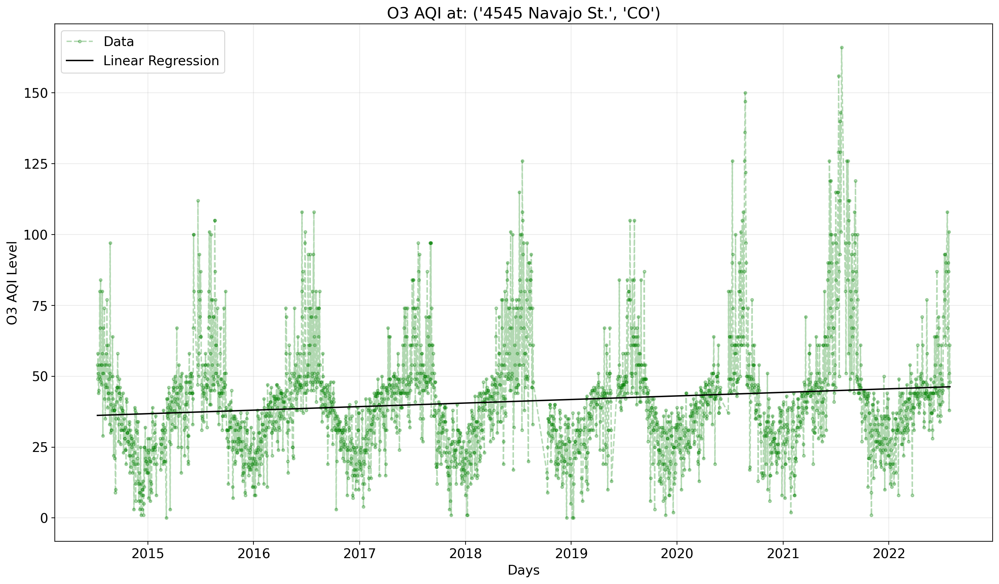

In [25]:
# 1st Study
address_A = slopes_list[0]['by'][0]
A = df['Address'] == address_A[0]
A_lm = slopes_list[0][slopes_list[0]['by'] == address_A]
print(f'Address: {address_A[0]}, {address_A[1]}')

# Converting date index to numeric
df['Date_ordinal'] = pd.to_datetime(df['Date']).apply(lambda x: x.toordinal())

# CA
lr_A_vals = df[A].Date_ordinal*A_lm['Slope'].values + A_lm['Intercept'].values
plt.plot(df[A]['Date'], df[A]['O3 AQI'], color='green', marker='.', linestyle='dashed', alpha=0.3, label='Data')
plt.plot(df[A]['Date'], lr_A_vals, color='k', label='Linear Regression')
plt.title(f'O3 AQI at: {address_A}')
plt.ylabel('O3 AQI Level')
plt.xlabel('Days')
plt.grid(alpha=0.25)
plt.legend()
plt.show()


Address: 2500 1ST STREET, N.W. WASHINGTON DC, DC


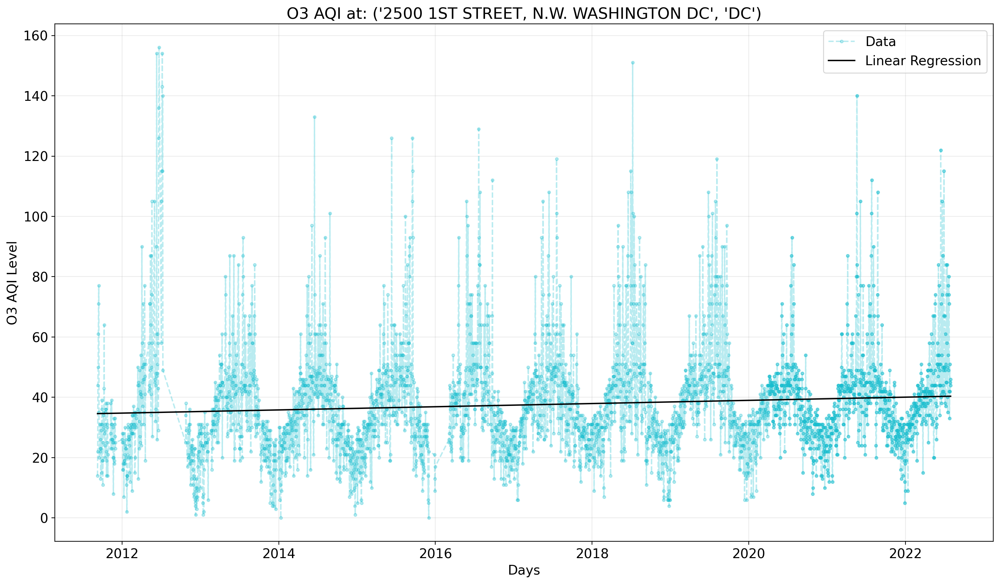

In [26]:
# 2nd Study
address_B = slopes_list[0]['by'][4]
B = df['Address'] == address_B[0]
B_lm = slopes_list[0][slopes_list[0]['by'] == address_B]
print(f'Address: {address_B[0]}, {address_B[1]}')

# PA
lr_B_vals = B_lm['Slope'].values*df[B].Date_ordinal + B_lm['Intercept'].values
plt.plot(df[B]['Date'], df[B]['O3 AQI'], color='C9', marker='.', linestyle='dashed', alpha=0.3, label='Data')
plt.plot(df[B]['Date'], lr_B_vals, color='k', label='Linear Regression')
plt.title(f'O3 AQI at: {address_B}')
plt.ylabel('O3 AQI Level')
plt.xlabel('Days')
plt.grid(alpha=0.25)
plt.legend()
plt.show()

---

<a name='ASEDA'>
    
# <b> 5 <span style='border-left: 4px solid #A4D4D6; padding-left: 10px;'> Address-Specific Data Analysis <b>

After importing the data and making necessary adjustments for state abbreviations, the next step in the data preprocessing pipeline is to create specific dataframes for the addresses under study: 
- CO street address: `4545 Navajo St.`
- DC street address: `2500 1ST STREET, N.W. WASHINGTON DC.`

In [28]:
try:
    # Storing address in variables
    co_address = '4545 Navajo St.'
    dc_address = '2500 1ST STREET, N.W. WASHINGTON DC'
    
    # Forming filter for both addresses of interest
    co_filter = df['Address'] == co_address
    dc_filter = df['Address'] == dc_address
    
    # Getting updated address dataframes
    df_co = df[co_filter].reset_index(drop=True)
    df_dc = df[dc_filter].reset_index(drop=True)

except:
    df_co = pd.read_csv('pollutions_CO_4545 Navajo St.csv')
    df_dc = pd.read_csv('pollutions_DC_500 1ST STREET, N.W. WASHINGTON DC.csv')
    
# Saving sliced data
# df_co.to_csv('pollutions_CO_4545 Navajo St.csv', index=False)
# df_dc.to_csv('pollutions_DC_500 1ST STREET, N.W. WASHINGTON DC.csv', index=False)

In [29]:
# Observing CO address
display(df_co.iloc[:, :-4].tail(4))

# State table CO
print(f'General Statistics of {co_address}') # [col for col in df_co.columns if '1st' not in col]
data_description = df_co.drop(columns=['Date']).describe().iloc[1:, :-4]
display( data_description.T.style.background_gradient(cmap='Greys') )

,Date,Address,State,County,City,O3 Mean,O3 1st Max Value,O3 1st Max Hour,O3 AQI,CO Mean,CO 1st Max Value,CO 1st Max Hour,CO AQI,SO2 Mean,SO2 1st Max Value,SO2 1st Max Hour,SO2 AQI,NO2 Mean,NO2 1st Max Value,NO2 1st Max Hour,NO2 AQI
2697,2022-07-28,4545 Navajo St.,CO,Denver,Denver,0.0346,0.041,11,38,0.1958,0.3,18,3.0,0.1391,0.3,11,0.0,10.1565,15.7,7,14
2698,2022-07-29,4545 Navajo St.,CO,Denver,Denver,0.0420,0.055,11,51,0.1917,0.2,0,2.0,0.1783,0.7,12,0.0,8.8174,16.8,6,15
2699,2022-07-30,4545 Navajo St.,CO,Denver,Denver,0.0438,0.058,10,61,0.1708,0.2,0,2.0,0.1217,0.3,8,0.0,8.2783,18.8,23,17
2700,2022-07-31,4545 Navajo St.,CO,Denver,Denver,0.0442,0.052,8,48,0.2250,0.3,1,3.0,0.1609,0.5,10,0.0,7.8783,20.2,0,19


General Statistics of 4545 Navajo St.


,mean,std,min,25%,50%,75%,max
O3 Mean,0.028937,0.013330,0.000000,0.017941,0.030118,0.039235,0.083200
O3 1st Max Value,0.041153,0.015109,0.000000,0.030000,0.042000,0.052000,0.092000
O3 1st Max Hour,10.501296,3.142495,7.000000,9.000000,10.000000,11.000000,23.000000
O3 AQI,41.162162,20.519069,0.000000,28.000000,39.000000,48.000000,166.000000
CO Mean,0.315903,0.152625,0.100000,0.216667,0.266667,0.362500,1.884615
CO 1st Max Value,0.470863,0.277687,0.100000,0.300000,0.400000,0.600000,2.800000
CO 1st Max Hour,7.028138,8.167366,0.000000,0.000000,5.000000,10.000000,23.000000
CO AQI,5.312107,3.280351,1.000000,3.000000,5.000000,7.000000,32.000000
SO2 Mean,0.739733,0.694790,-0.247826,0.313043,0.547826,0.952174,8.244444
SO2 1st Max Value,2.431285,2.608232,-0.100000,0.800000,1.600000,3.000000,32.300000


In [30]:
# Observing DC address
display(df_dc.iloc[:, :-4].tail(4))

# State table CO
print(f'General Statistics of {dc_address}')
data_description = df_dc.drop(columns=['Date']).describe().iloc[1:, :-4]
display( data_description.T.style.background_gradient(cmap='Greys') )

,Date,Address,State,County,City,O3 Mean,O3 1st Max Value,O3 1st Max Hour,O3 AQI,CO Mean,CO 1st Max Value,CO 1st Max Hour,CO AQI,SO2 Mean,SO2 1st Max Value,SO2 1st Max Hour,SO2 AQI,NO2 Mean,NO2 1st Max Value,NO2 1st Max Hour,NO2 AQI
4441,2022-07-30,"2500 1ST STREET, N.W. WASHINGTON DC",DC,District of Columbia,Washington,0.0416,0.050,11,46,0.3542,0.4,0,5.0,1.0167,1.1,7,1.0,3.4292,7.9,21,7
4442,2022-07-30,"2500 1ST STREET, N.W. WASHINGTON DC",DC,District of Columbia,Washington,0.0416,0.050,11,46,0.3542,0.4,0,5.0,1.0167,1.1,7,1.0,2.7750,7.4,21,7
4443,2022-07-31,"2500 1ST STREET, N.W. WASHINGTON DC",DC,District of Columbia,Washington,0.0369,0.048,8,44,0.4000,0.4,0,5.0,0.9958,1.1,10,1.0,5.8167,10.2,5,9
4444,2022-07-31,"2500 1ST STREET, N.W. WASHINGTON DC",DC,District of Columbia,Washington,0.0369,0.048,8,44,0.4000,0.4,0,5.0,0.9958,1.1,10,1.0,5.1958,9.5,5,8


General Statistics of 2500 1ST STREET, N.W. WASHINGTON DC


,mean,std,min,25%,50%,75%,max
O3 Mean,0.030575,0.011635,0.000000,0.022529,0.030706,0.039118,0.067059
O3 1st Max Value,0.039101,0.013511,0.000000,0.029000,0.039000,0.049000,0.088000
O3 1st Max Hour,10.855793,3.377820,7.000000,9.000000,10.000000,11.000000,23.000000
O3 AQI,38.060517,17.310623,0.000000,27.000000,36.000000,45.000000,156.000000
CO Mean,0.289106,0.140322,0.000000,0.200000,0.241667,0.341667,1.612500
CO 1st Max Value,0.384499,0.226249,0.000000,0.200000,0.300000,0.500000,2.500000
CO 1st Max Hour,5.829696,8.043873,0.000000,0.000000,0.000000,10.000000,23.000000
CO AQI,4.282790,2.724672,0.000000,2.000000,3.000000,6.000000,28.000000
SO2 Mean,0.847672,0.637680,-0.662500,0.354545,0.775000,1.178261,7.262500
SO2 1st Max Value,1.675681,1.549128,-0.200000,0.900000,1.300000,2.000000,28.200000


### <b> $\nabla$ <span style='border-left: 4px solid #A4D4D6; padding-left: 10px;'> General Statistics of `4545 Navajo St.` <b>
The descriptive statistics for the Colorado address show:
- **O3 Mean**: The average O3 levels are around 0.03, indicating typical ozone levels at this address.
- **CO Mean**: The Carbon Monoxide mean levels are approximately 0.3, which suggests relatively moderate CO concentrations.
- **SO2 Mean**: The mean value for SO2 is around 1.0, suggesting that SO2 levels are generally low.
- **NO2 Mean**: The Nitrogen Dioxide mean levels are around 20, indicating moderate NO2 concentrations.

### <b> $\nabla$ <span style='border-left: 4px solid #A4D4D6; padding-left: 10px;'> General Statistics of `2500 1ST STREET, N.W. WASHINGTON DC` <b>
The descriptive statistics for the Washington DC address show:
- **O3 Mean**: The average O3 levels are around 0.03, slightly lower than that at the Colorado address.
- **CO Mean**: The Carbon Monoxide mean levels are around 0.4, higher than the Colorado address, which suggests a more elevated presence of CO.
- **SO2 Mean**: The mean SO2 levels are nearly 1, indicating very low levels of SO2.
- **NO2 Mean**: The Nitrogen Dioxide mean levels are around 11, which is lower than that in Colorado, suggesting a relatively cleaner atmosphere in terms of NO2.

### <b> $\nabla$ <span style='border-left: 4px solid #A4D4D6; padding-left: 10px;'> Similarities and Differences <b>
- **Similarities**: Both addresses show moderate levels of O3 and have fluctuating AQI values. This suggests that both areas have air quality concerns related to O3 levels.
- **Differences**: The Washington DC address has a higher mean level of CO but lower levels of NO2 and SO2 compared to the Colorado address. This indicates that while CO is a more prominent pollutant in DC, NO2 and SO2 are of more concern in Colorado.


<a name='coradd'>

## <b> 5.2 <span style='border-left: 4px solid #A4D4D6; padding-left: 10px;'> Correlation on Addresses <b>

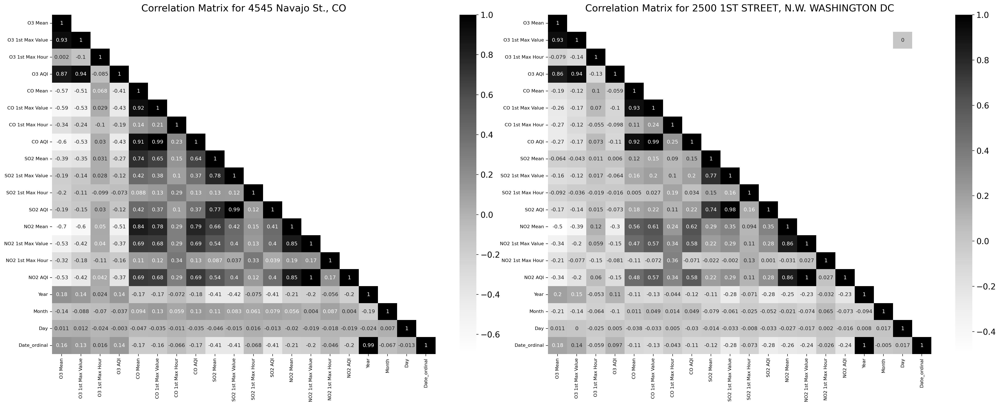

In [33]:
# Plotting correlations
fig, ax = plt.subplots(1, 2, figsize=(25, 10))

# Computing correlation matrix for each address
correlation_matrix_co = df_co.corr(numeric_only=True).round(3)
correlation_matrix_dc = df_dc.corr(numeric_only=True).round(3)

# Creating heatmaps
sns.heatmap(correlation_matrix_co, mask=np.triu(correlation_matrix_co, 1), annot=True, cmap='Greys', annot_kws={"size": 9}, ax=ax[0])
ax[0].set_title('Correlation Matrix for 4545 Navajo St., CO')
ax[0].tick_params(axis='both', which='major', labelsize=8)

sns.heatmap(correlation_matrix_dc, mask=np.triu(correlation_matrix_dc, 1), annot=True, cmap='Greys', annot_kws={"size": 9}, ax=ax[1])
ax[1].set_title('Correlation Matrix for 2500 1ST STREET, N.W. WASHINGTON DC')
ax[1].tick_params(axis='both', which='major', labelsize=8)

plt.tight_layout(w_pad=-2)
plt.show()


### <b>5.2.1 <span style='border-left: 4px solid #A4D4D6; padding-left: 10px;'>  Analysis of Correlation Tables <b>

**Common Observations**
Both correlation tables exhibit similar patterns for the pollutants AQI and their mean values. For instance, in both tables:
- `O3 Mean` shows a strong positive correlation with `O3 AQI`.
- `CO Mean` shows a moderate positive correlation with `CO AQI`.
- `NO2 Mean` shows a strong positive correlation with `NO2 AQI`.
- `SO2 Mean` shows a strong positive correlation with `SO2 AQI`.

These strong correlations between the mean pollutant levels and their corresponding AQI metrics suggest that either variable could be used in modeling as they convey similar information.

**Unique Observations**
- For the CO address, `O3 AQI` and `CO AQI` exhibit a moderate positive correlation of 0.324. 
- In contrast, for the DC address, `O3 AQI` and `CO AQI` have a weak negative correlation of -0.086.

This difference might imply that in the CO address, the presence of O3 is somewhat linked to the presence of CO, while in DC, they seem to be mostly independent of each other.

**Interesting Observations**
- The correlation value of 0.85 between `NO2 Mean` and `CO Mean` in Colorado is strong enough to be noteworthy. This strong relationship implies that an increase in NO2 levels is likely to be accompanied by an increase in CO levels. This could indicate a common source or related emission mechanisms for these pollutants in Colorado.



<a name='distpopadd'>
    
## <b> 5.3 <span style='border-left: 4px solid #A4D4D6; padding-left: 10px;'> Distributions of Pollutants at Addresses <b>

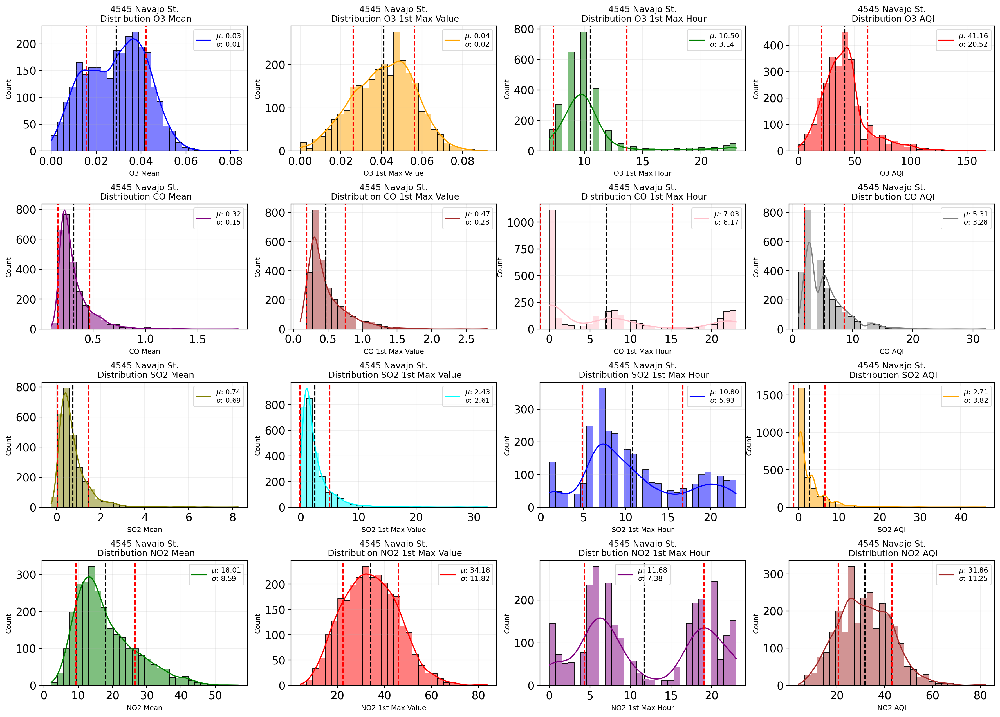

In [36]:
# CO distributions of gases
histo_plotter(df_co, numeric_columns, title=f'{co_address}\n')
plt.tight_layout(h_pad=0.5, w_pad=0)
plt.show()

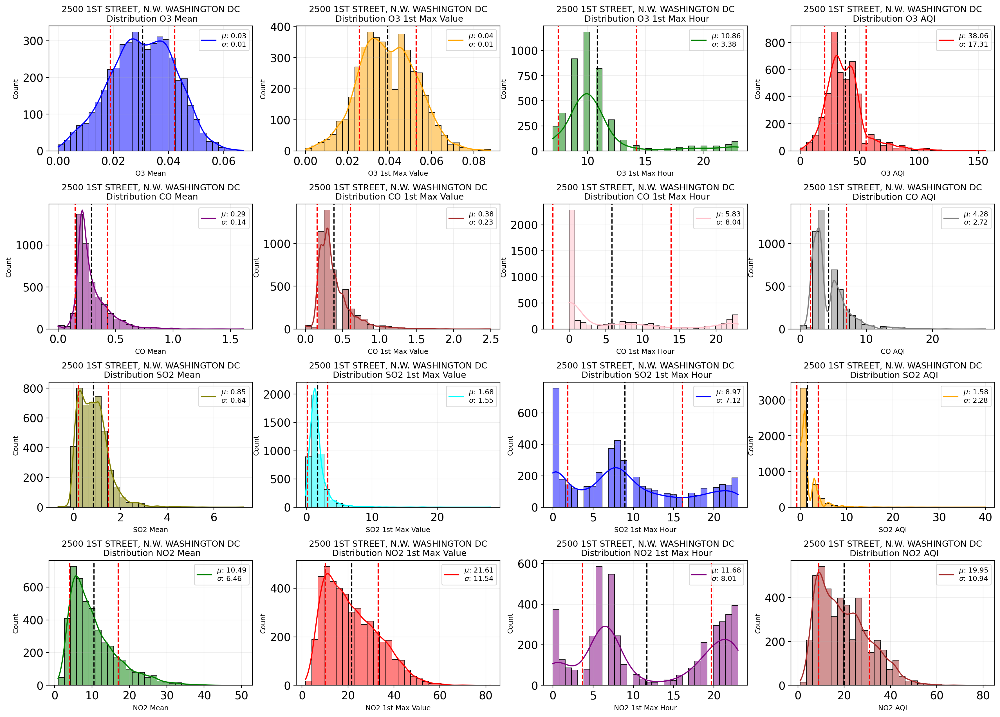

In [37]:
# DC distributions of gases
histo_plotter(df_dc, numeric_columns, title=f'{dc_address}\n')
plt.tight_layout(h_pad=0.5, w_pad=0)
plt.show()

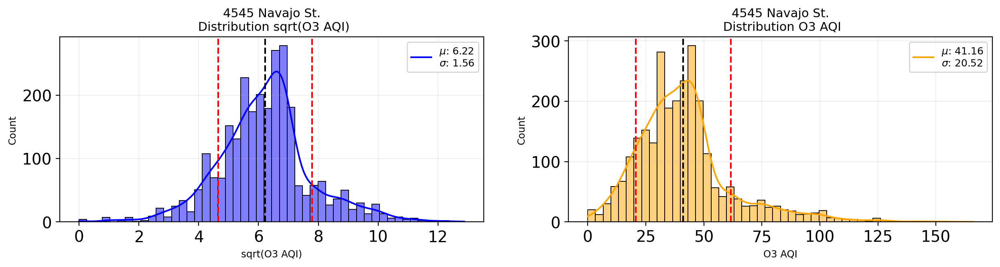

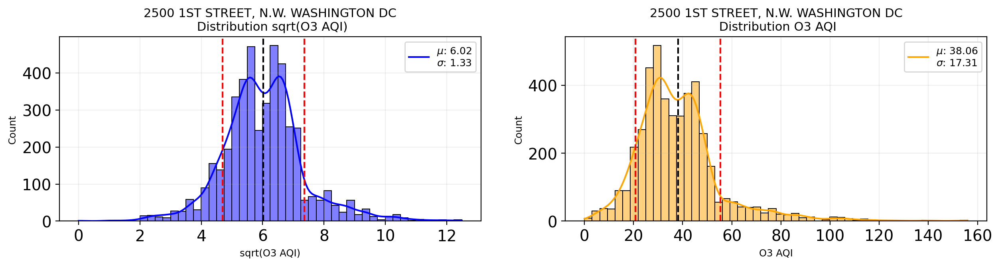

In [38]:
# Transforming data for ML models latter on for normality assumption
df_co['sqrt(O3 AQI)'] = np.sqrt(df_co['O3 AQI'])
df_dc['sqrt(O3 AQI)'] = np.sqrt(df_dc['O3 AQI'])

histo_plotter(df_co, ['sqrt(O3 AQI)', 'O3 AQI'], title=f'{co_address}\n', bins=50, nrow_cols=(1, 2), figsize=(15, 3))
plt.show()

histo_plotter(df_dc, ['sqrt(O3 AQI)', 'O3 AQI'], title=f'{dc_address}\n', bins=50,  nrow_cols=(1, 2), figsize=(15, 3))
plt.show()

### <b> 5.3.2 <span style='border-left: 4px solid #A4D4D6; padding-left: 10px;'> Analysis of Distributions for CO and DC Addresses <b>


**Similarities**

1. **Central Tendency**: For most of the pollutants, both CO and DC addresses have similar central tendencies (mean values), as indicated by the vertical black dashed lines.
2. **Spread**: The spread (standard deviation) of the distributions, marked by the red dashed lines, is fairly consistent for both addresses, especially for features like `O3 Mean`, `O3 AQI`, and `NO2 Mean`.
3. **Skewness**: Both locations show right-skewness in features like `CO AQI`, `SO2 AQI`, and `NO2 AQI`, indicating that higher readings are less frequent but possible.

**Differences**
1. **Outliers**: The CO address has more noticeable outliers in features like `CO AQI`, `SO2 AQI`, and `NO2 AQI`.
2. **Variability**: The CO address shows higher variability in `SO2 Mean` and `SO2 AQI`, compared to the DC address, which could be indicative of different sources or factors affecting the levels of SO2.  
3. **NO2 Levels**: The DC address shows higher levels of 'NO2 Mean' and 'NO2 AQI', suggesting that NO2 pollution could be a more significant concern there.

**Insights for Model Building**
1. **Feature Selection**: Given the similarities and differences in distributions, features like `O3 Mean`, `O3 AQI`, and `NO2 Mean` could be valuable for both addresses. However, for the DC address, features related to NO2 might be more critical.
2. **Transformation**: Right-skewed features may benefit from transformations like logarithms to normalize the data, improving model performance.
3. **Outlier Handling**: The presence of outliers, especially in the CO address, suggests that robust models or outlier-handling techniques may be beneficial.

**Transformations**
- For the most normally distribtued data transformation, the function $f(x) = \sqrt{x}$ was applied to our target variable in our time series data set. We will be using this when buidling our machine learning models latter on.

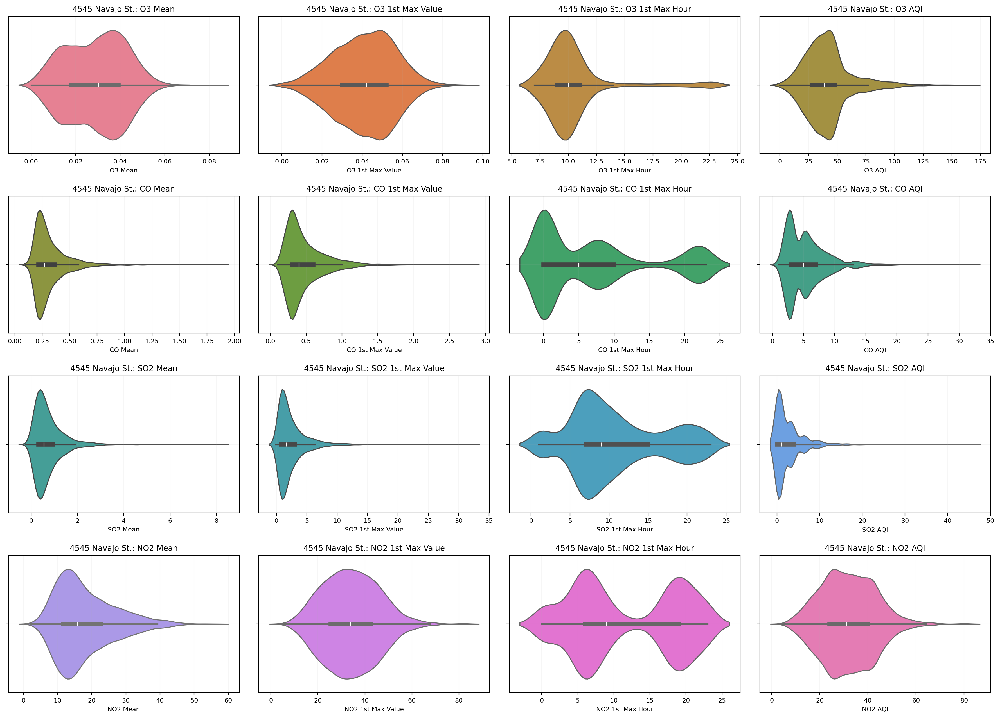

In [40]:
# Plotting for Colorado address
plot_violinplots(df_co, numeric_columns, title=co_address, violin=True)

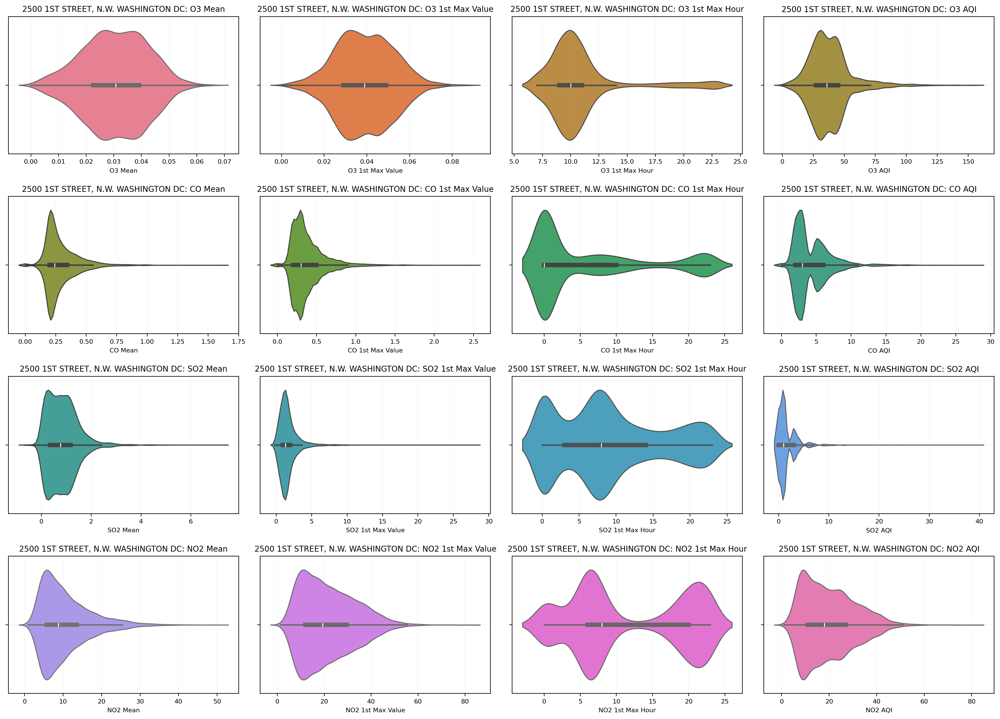

In [41]:
# Plotting for Washington DC address
plot_violinplots(df_dc, numeric_columns, title=dc_address, violin=True)


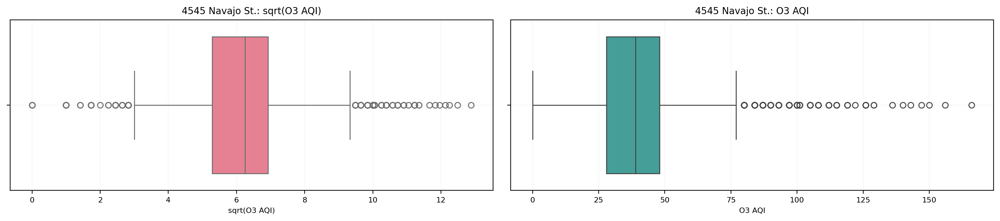

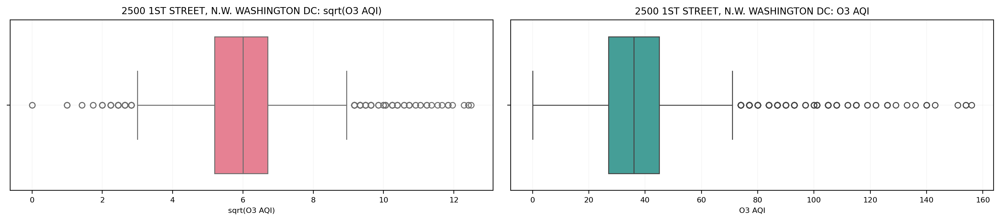

In [42]:
# Plotting for Washington DC address
plot_violinplots(df_co, ['sqrt(O3 AQI)', 'O3 AQI'], title=co_address, figsize=(15, 3.5), nrow_cols=(1, 2), violin=False)

# Plotting for Washington DC address
plot_violinplots(df_dc, ['sqrt(O3 AQI)', 'O3 AQI'], title=dc_address, figsize=(15, 3.5), nrow_cols=(1, 2), violin=False)

### <b> 5.3.3 <span style='border-left: 4px solid #A4D4D6; padding-left: 10px;'> Analysis of Violin Plots for CO and DC Addresses <b>

**Similarities:**
1. **Central Tendency**: The central tendency, usually represented by the median in the violin plots, appears quite similar for most gases and their respective metrics (Mean, AQI, Max Value, Max Hour) across both CO and DC addresses. The white dot in each "violin" marks this central value.
2. **Data Density**: The width of the violins gives us an idea of the data density. For several gases and their metrics, such as `O3 Mean` and `NO2 Mean`, both addresses show a similar density profile.
3. **Spread**: The overall spread of the data, as represented by the extent of the violins, is somewhat consistent across both addresses. This is particularly noticeable for features like `O3 Mean` and `NO2 Mean`.
4. **Skewness**: Both locations show a right skewness in features like `CO AQI`, `SO2 AQI`, and `NO2 AQI`, indicating that higher readings are less frequent but possible.

**Differences:**
1. **Outliers**: The CO address tends to show more outliers, especially in features like `CO AQI` and `SO2 AQI`. This is depicted by the extended "whiskers" of the violin plot.
2. **Variability**: The width of the violin plot for `SO2 Mean` and `SO2 AQI` is more variable in the CO address, suggesting more variability in SO2 levels.
3. **NO2 Levels**: The DC address shows a broader spread in `NO2 Mean` and `NO2 AQI`, suggesting that NO2 pollution might be a more significant concern there.

**Insights for Model Building:**
1. **Feature Selection**: Given the similarities and differences in the distributions, features like `O3 Mean`, `O3 AQI`, and `NO2 Mean` could be valuable for both addresses. For the DC address, features related to NO2 might be more critical.
2. **Transformation**: The right-skewed features may benefit from transformations like logarithms or square roots to make the data more ***normal***, which could improve model performance. 
3. **Outlier Handling**: The presence of outliers, especially in the CO address, suggests that robust models or outlier-handling techniques may be beneficial.

**Transformations**
- Here we have some outliers in our transformed variable `O3 AQI` $\rightarrow \sqrt{\text{O3 AQI}}$, this could lead to potential difficulties in modeling our data later on.

---

<a name='EDAYEAR'>
    
# <b> 6 <span style='border-left: 4px solid #A4D4D6; padding-left: 10px;'> Exploratory Data Analysis By Year <b>
    
- Since the data set was updated we will look at the entire time-span on the USA map

In [45]:
# Using above function to get yearly means per state
aggregation_func = 'max'
time_frame = 'Q'
JUST_DC_CO = False

if JUST_DC_CO:
    state_agg = compute_aggregations(df=df_whole[(df_whole['Address'] == co_address) | (df_whole['Address'] == dc_address)], 
                                     value_columns=numeric_columns, 
                                     group_by_column='State', 
                                     time_frame=time_frame,
                                     aggregation_func='max')
else:
    state_agg = compute_aggregations(df=df_whole, 
                                     value_columns=numeric_columns, 
                                     group_by_column='State', 
                                     time_frame=time_frame,
                                     aggregation_func='max')
display(state_agg)

,Date,State,O3 Mean,O3 1st Max Value,O3 1st Max Hour,O3 AQI,CO Mean,CO 1st Max Value,CO 1st Max Hour,CO AQI,SO2 Mean,SO2 1st Max Value,SO2 1st Max Hour,SO2 AQI,NO2 Mean,NO2 1st Max Value,NO2 1st Max Hour,NO2 AQI
0,2000-03-31,AZ,0.0515,0.078,23,126,3.5750,5.3,23,59.0,19.3750,29.0,23,41.0,139.5417,267.0,23,132
1,2000-03-31,CA,0.0606,0.086,23,151,5.6333,11.0,23,126.0,29.1000,107.0,23,115.0,68.6087,185.0,23,117
2,2000-03-31,CO,0.0420,0.054,23,50,2.1292,2.9,23,33.0,11.0000,52.0,22,71.0,53.4783,120.0,22,105
3,2000-03-31,DC,0.0339,0.041,23,38,3.3792,5.2,23,58.0,20.7368,68.0,22,91.0,49.8000,141.0,23,109
4,2000-03-31,FL,0.0508,0.067,23,90,1.4500,2.2,23,25.0,5.2917,24.0,23,34.0,41.8333,73.0,23,71
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
3058,2023-09-30,NY,0.0602,0.079,23,129,0.6917,0.8,23,9.0,0.6458,2.5,23,3.0,21.3000,39.5,23,37
3059,2023-09-30,OH,0.0549,0.075,19,115,0.5083,0.7,23,8.0,2.5909,22.0,23,31.0,14.3043,46.8,23,43
3060,2023-09-30,OK,0.0621,0.077,22,122,0.4792,0.7,23,8.0,1.1667,4.0,23,6.0,9.3958,23.2,23,22
3061,2023-09-30,TN,0.0578,0.063,23,77,0.4167,0.5,19,6.0,0.1500,0.8,23,0.0,1.0083,1.9,23,1


<a name='usaheatmap'>
    
## <b> 6.1 <span style='border-left: 4px solid #A4D4D6; padding-left: 10px;'> Max USA Heatmap <b>

- I've opted to plot the maximum AQI value per state over time instead of the mean. This is because max captures the worst air quality levels faced in each state, which is critical for public health measures. Averaging AQI across different regions within a state can dilute high-risk areas, making the situation seem less severe than it actually is. Using the max value ensures that the most extreme conditions are represented.


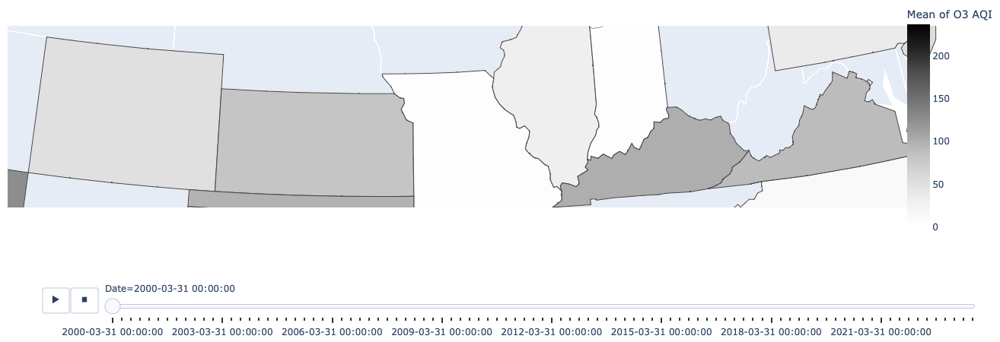

In [47]:
# Observation column
column = 'O3 AQI'
fig = px.choropleth(
    state_agg, 
    locations=state_agg['State'],
    locationmode='USA-states', 
    color=column,
    projection='albers usa',
    animation_frame='Date',
    color_continuous_scale='greys', 
    range_color=[state_agg['O3 AQI'].min(), state_agg['O3 AQI'].max()]
)

# Updating region
fig.update_geos(
    scope='usa',
    lataxis=dict(range=[39, 39.5]),
    lonaxis=dict(range=[-100, -35]),
    center=dict(lon=-91.5, lat=39.25),
)

fig.update_layout(
    height=450,
    width=1350,
    autosize=True,
    margin=dict(l=10, r=0, b=0, t=0, pad=0, autoexpand=True),
    coloraxis_colorbar=dict(title=f'Mean of {column}', xanchor='right', titleside='top')
)

fig.show()


### <b> 6.1.1 <span style='border-left: 4px solid #A4D4D6; padding-left: 10px;'>  Analysis of Quarterly Maximum Ozone AQI for Colorado and Washington, D.C. <b>

**Observations**
1. **Temporal Changes**: The animation across quarters indicates that there are seasonal variations in the `O3 AQI` for both Colorado and Washington, D.C. 
2. **Colorado Specifics**: In Colorado, the `O3 AQI` seems to be consistently within a particular range across the quarters. The state does not show extreme spikes or drops, indicating relatively stable ozone levels when compared to DC.
3. **Washington D.C. Specifics**: Unlike Colorado, Washington D.C. shows more variation in `O3 AQI` over time. There are quarters where the AQI peaks noticeably.

**Insights for Further Analysis**
1. **Seasonal Trends**: The seasonal variation observed calls for a more in-depth time-series analysis to understand the underlying patterns. 
2. **Geographical Factors**: The stability in Colorado's `O3 AQI` could be influenced by geographical or meteorological factors that warrant further investigation.

---

<a name='TS'>
    
# <b> 7 <span style='border-left: 4px solid #A4D4D6; padding-left: 10px;'> Time Series Analysis <b>

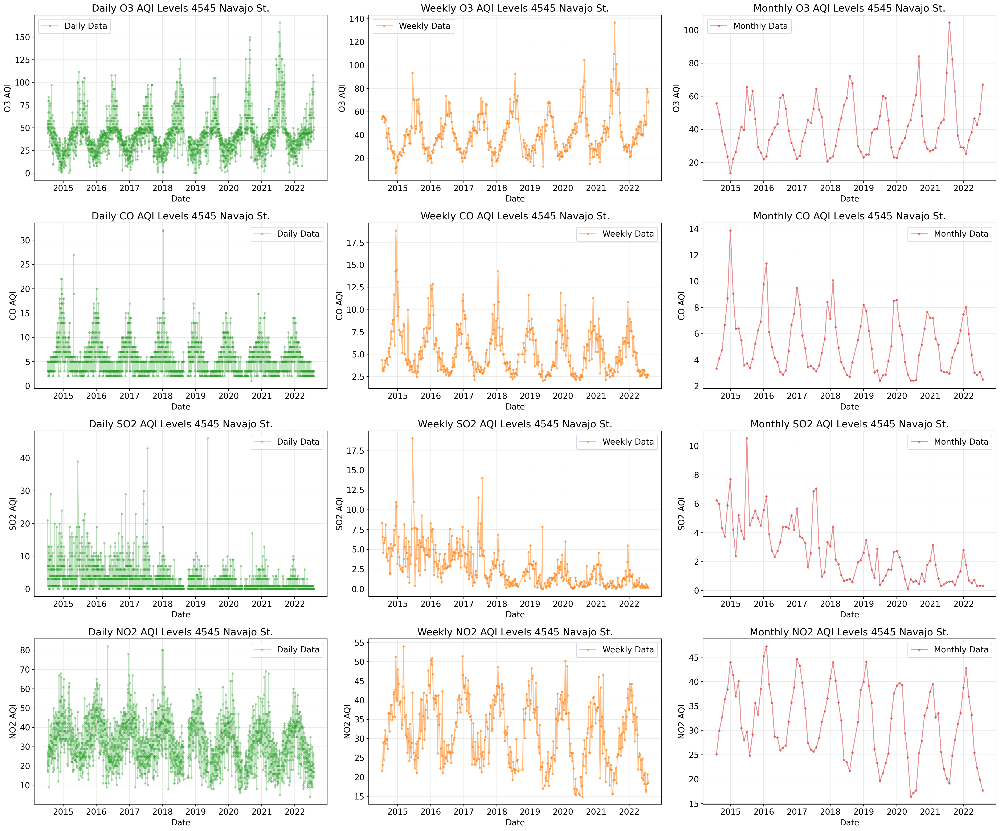

In [50]:
# Plotting aggregation of CO data
time_frame_plotter(df_co, 
                   columns=aqi_columns[5:],
                   title=f'{co_address}',
                   aggregation_func='mean', 
                   time_frames={'Weekly': 'W', 'Monthly': 'M'})


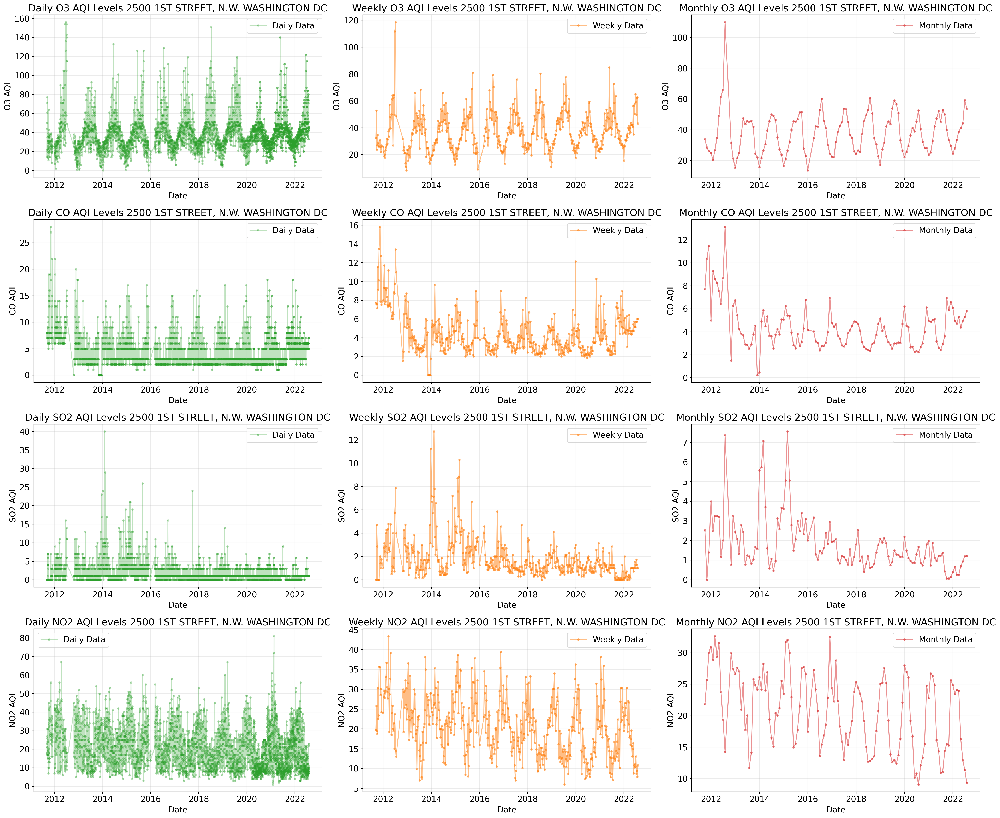

In [51]:
# Plotting aggregation of DC data
time_frame_plotter(df_dc, 
                   columns=aqi_columns[5:],
                   title=f'{dc_address}',
                   aggregation_func='mean', 
                   time_frames={'Weekly': 'W', 'Monthly': 'M'})

<a name='missvalues'>
    
## <b> 7.1 <span style='border-left: 4px solid #A4D4D6; padding-left: 10px;'> Time Series Missing Recorded Values <b>

- In the time series dataset utilized for ARIMA modeling, there are observed instances of missing daily records. Such gaps can present challenges in parameter estimation, potentially affect the model's understanding of underlying patterns, and impact the accuracy of forecasts. The ARIMA model assumes a continuous time series, and hence, missing values could lead to suboptimal parameter estimation and prediction errors. Despite these challenges, there are several strategies to mitigate the
impact of missing data, such as data imputation (e.g., forward-fill, interpolation) or leveraging state-space models that inherently accommodate missing observations.

In [53]:
# Number of missing values for CO data
print('Missing recorded days for dc_co')
print(missing_measurements(df_co))

# Number of missing values for DC data
print('\nMissing recorded days for dc_dc')
print(missing_measurements(df_dc))

Missing recorded days for dc_co
DatetimeIndex(['2014-08-02', '2014-08-03', '2015-02-01', '2015-02-02',
               '2015-02-03', '2015-02-04', '2015-02-05', '2015-02-06',
               '2015-02-07', '2015-02-08',
               ...
               '2022-04-03', '2022-04-23', '2022-04-24', '2022-05-18',
               '2022-06-15', '2022-07-09', '2022-07-10', '2022-07-19',
               '2022-07-20', '2022-07-21'],
              dtype='datetime64[ns]', length=246, freq=None)

Missing recorded days for dc_dc
DatetimeIndex(['2011-09-17', '2011-09-18', '2011-10-28', '2011-10-29',
               '2011-10-30', '2011-10-31', '2011-11-01', '2011-11-02',
               '2011-11-03', '2011-11-04',
               ...
               '2018-08-05', '2019-07-21', '2019-10-15', '2019-10-16',
               '2019-11-10', '2019-11-11', '2019-11-12', '2019-11-13',
               '2019-11-14', '2022-04-24'],
              dtype='datetime64[ns]', length=384, freq=None)


In [54]:
# Monthly
df_co_time = compute_aggregations(df_co, value_columns=numeric_columns, time_frame='M')[['Date', 'O3 AQI']]
df_dc_time = compute_aggregations(df_dc, value_columns=numeric_columns, time_frame='M')[['Date', 'O3 AQI']]

# Number of missing values for CO data
print('Missing recorded months for dc_co')
print(missing_measurements(df_co_time, freq='M'), end='\n\n')

# Number of missing values for DC data
print('Missing recorded months for dc_dc')
print(missing_measurements(df_dc_time,  freq='M'))

Missing recorded months for dc_co
DatetimeIndex(['2018-09-30'], dtype='datetime64[ns]', freq=None)

Missing recorded months for dc_dc
DatetimeIndex(['2012-08-31', '2012-09-30', '2016-01-31', '2016-02-29'], dtype='datetime64[ns]', freq=None)


### <b> 7.1.1 <span style='border-left: 4px solid #A4D4D6; padding-left: 10px;'> Time Series Missing Recorded Values - Solution </b>

- For **daily** recordings, we observe over 200 missing values out of 2,767 observations (approximately 7%) for CO, and 383 missing values for NO2 out of 4,447 observations (roughly 8%).
- For **monthly** recordings, the number of missing values has greatly decreased, but there are still a few issues. Therefore, for our analysis, we will proceed with caution.
- In this analysis, `interpolation` was used to address the discontinuities in the data, aiming to maintain the rigor of the model's predictive capabilities.


In [56]:
# Updating numeric_columns
numeric_columns = numeric_columns + ['sqrt(O3 AQI)']

# Filling with mean of post/pre day
missing_dates_co, df_co_filled = fill_dates_interpolate(df_co, value_cols=['Date'] + numeric_columns)
missing_dates_dc, df_dc_filled = fill_dates_interpolate(df_dc, value_cols=['Date'] + numeric_columns)

# Number of missing values for CO data
print('Missing recorded days for dc_co')
print(missing_dates_co)

# Number of missing values for DC data
print('\nMissing recorded days for dc_dc')
print(missing_dates_dc)

Missing recorded days for dc_co
           Date
22   2014-08-02
23   2014-08-03
205  2015-02-01
206  2015-02-02
207  2015-02-03
...         ...
2920 2022-07-09
2921 2022-07-10
2930 2022-07-19
2931 2022-07-20
2932 2022-07-21

[246 rows x 1 columns]

Missing recorded days for dc_dc
           Date
9    2011-09-17
10   2011-09-18
50   2011-10-28
51   2011-10-29
52   2011-10-30
...         ...
2986 2019-11-11
2987 2019-11-12
2988 2019-11-13
2989 2019-11-14
3881 2022-04-24

[384 rows x 1 columns]


<a name='transformation'>

## <b> 7.2 <span style='border-left: 4px solid #A4D4D6; padding-left: 10px;'> Time Series Analysis of $\sqrt{\text{O3 AQI}}$ <b>

- With the missing time steps now filled we will move forward with our analysis.
- We will now use the trasnformed variable for O3 AQI $\longrightarrow \sqrt{\text{O3 AQI}}$, for a more normal distribution of the data and analyze it over time.

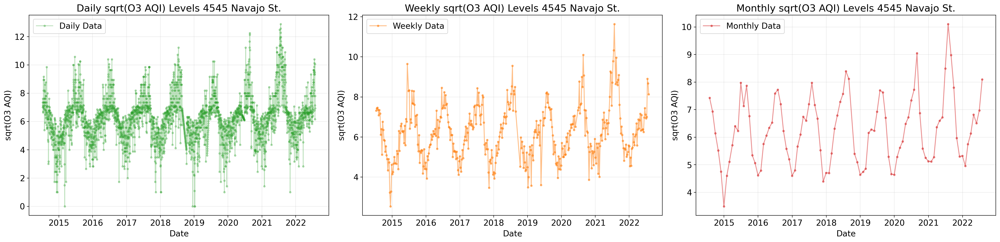

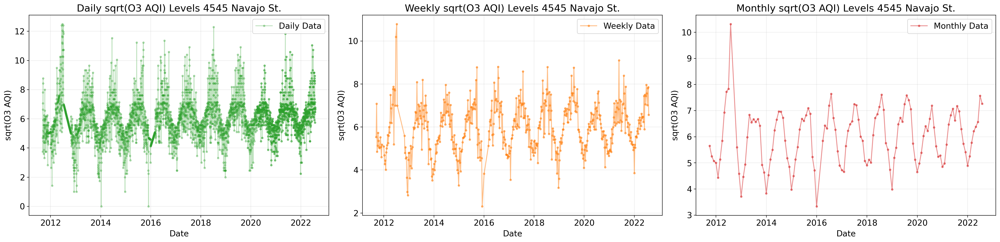

In [58]:
# Plotting aggregation of CO
time_frame_plotter(df_co_filled, 
                   columns=['sqrt(O3 AQI)'],
                   title=f'{co_address}',
                   aggregation_func='mean', 
                   time_frames={'Weekly': 'W', 'Monthly': 'M'}, figsize=(24, 6))

# Plotting aggregation of DC
time_frame_plotter(df_dc_filled, 
                   columns=['sqrt(O3 AQI)'],
                   title=f'{co_address}',
                   aggregation_func='mean', 
                   time_frames={'Weekly': 'W', 'Monthly': 'M'}, figsize=(24, 6))

- Here it seems that the trend repeats yearly and are similar to the previous time series plots of the data.

### <b> 7.2.1 <span style='border-left: 4px solid #A4D4D6; padding-left: 10px;'> Decomposition, Autocorrelation & Partial Autocorrelation Function Analysis <b>



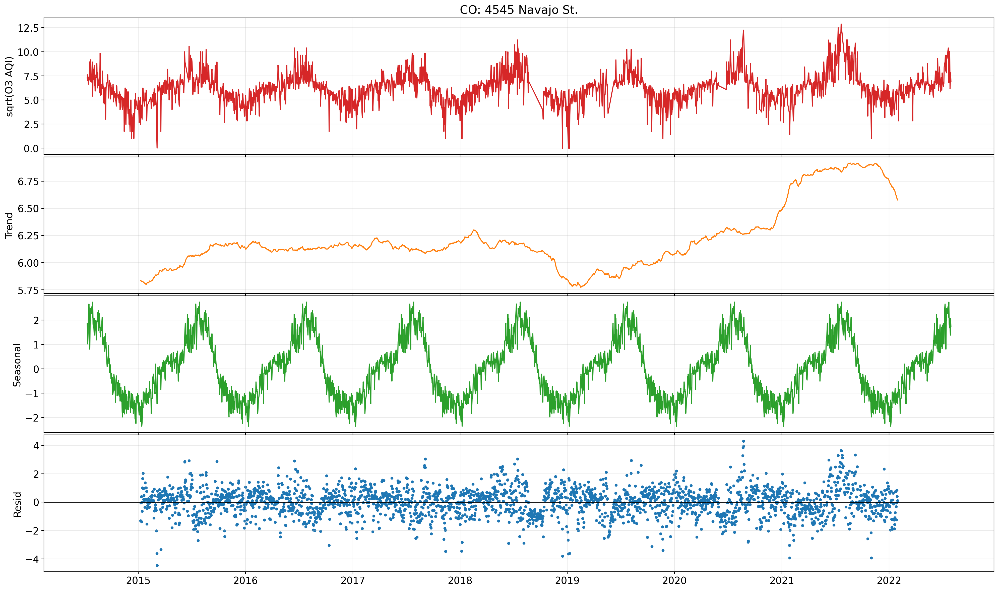

In [61]:
# CO time series decomposition
_ = seasonal_decompose_plotter(df_co_filled, period=365, col='sqrt(O3 AQI)', title=f'CO: {co_address}')

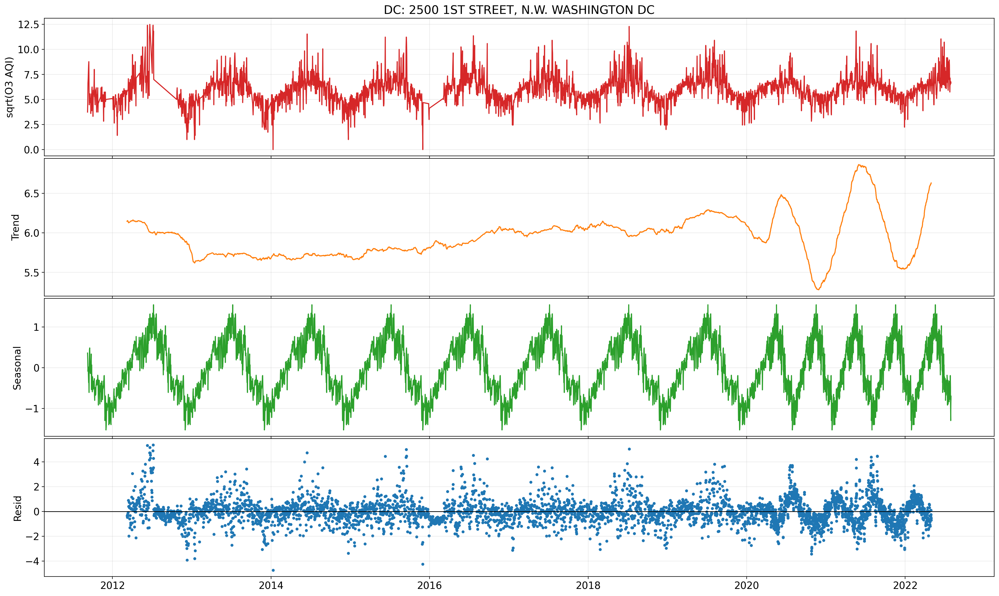

In [62]:
# DC time series decomposition
_ = seasonal_decompose_plotter(df_dc_filled, period=365, col='sqrt(O3 AQI)', title=f'DC: {dc_address}')

### <b>7.2.2 <span style='border-left: 4px solid #A4D4D6; padding-left: 10px;'>Decomposition, Autocorrelation & Partial Autocorrelation Analysis</span></b>

**Observations for 4545 Navajo St., CO**

1. **Trend Component**: The trend component of the data shows general stability over time, with a slight upward trend from the start of the dataset until around 2019, where it peaks. After 2019, the trend displays a slight decline but appears to stabilize around 2021, with no significant deviations up to 2023.

2. **Seasonal Component**: A clear seasonal pattern is evident in the data, with regular peaks and troughs. The seasonal swings do not exhibit significant changes in amplitude over time, indicating consistent seasonal effects throughout the observed period. The peaks may indicate higher values at specific times of the year, potentially related to temperature changes affecting the $\sqrt{\text{O3 AQI}}$.

3. **Residuals**: The residuals, representing the noise or the unexplained variance after accounting for the trend and seasonal components, seem to center around zero with no discernible pattern. There are no obvious trends or seasonal effects in the residuals, implying that the model has captured most of the systematic information. The spread of the residuals appears consistent over time, suggesting homoscedasticity, meaning the variance of the residuals is constant across time.

**Observations for 2500 1st Street, N.W., Washington DC**

1. **Trend Component**: The trend component data indicates a small increase over time, starting from around 2013 until approximately 2020. From there, the trend exhibits fluctuations up to 2022.

2. **Seasonal Component**: The seasonal component shows a pronounced and regular pattern, with clear peaks and troughs each year, indicating a strong seasonal influence on the $\sqrt{\text{O3 AQI}}$ values. The seasonal fluctuations appear consistent in frequency over the years, with variations in amplitude, especially around 2018 and 2021, where seasonal peaks are more pronounced.

3. **Residuals**: The residuals scatter plot indicates that most data points cluster around the zero line, suggesting that the model has accounted for much of the data's variability. Some outliers may result from unusual or unaccounted-for events. The spread of the residuals is relatively even over the years, though towards the end, there seems to be convergence and an oscillatory pattern.

**Insights for Further Analysis**

1. **Data Interval Adjustment**: Analysis on a **weekly scale** could reduce residual noise, providing clearer insights into trends and seasonality.
2. **Location-Specific Modeling**: The distinct seasonal patterns at each location suggest the need for bespoke modeling for O3 Mean level forecasting.

---
<a name='weekly'>
    
## <b> 7.3 <span style='border-left: 4px solid #A4D4D6; padding-left: 10px;'> Decomposition - Time Frame Weekly <b>


In [64]:
# Weekly grouping
df_co_filled_W = compute_aggregations(df_co_filled, value_columns=numeric_columns, time_frame='W')
df_dc_filled_W = compute_aggregations(df_dc_filled, value_columns=numeric_columns, time_frame='W')

display(df_co_filled_W.tail(),
        df_dc_filled_W.tail())

,Date,State,O3 Mean,O3 1st Max Value,O3 1st Max Hour,O3 AQI,CO Mean,CO 1st Max Value,CO 1st Max Hour,CO AQI,SO2 Mean,SO2 1st Max Value,SO2 1st Max Hour,SO2 AQI,NO2 Mean,NO2 1st Max Value,NO2 1st Max Hour,NO2 AQI,sqrt(O3 AQI)
402,2022-07-03,CO,0.0395,0.0507,9.5714,48.2857,0.1869,0.2571,2.5714,2.7143,0.1734,0.7429,13.0000,0.1429,7.6535,18.0857,7.7143,16.7143,6.9258
403,2022-07-10,CO,0.0384,0.0504,9.6000,49.6000,0.1650,0.2400,3.2000,2.4000,0.1951,0.9400,9.6000,0.6000,8.1446,17.6600,11.4000,16.2000,7.0053
404,2022-07-17,CO,0.0489,0.0639,9.7143,79.7143,0.1952,0.2429,3.0000,2.4286,0.2056,0.9000,8.5714,0.4286,8.5182,19.8286,12.7143,18.1429,8.9005
405,2022-07-24,CO,0.0460,0.0622,9.0000,77.0000,0.2156,0.2750,7.2500,2.7500,0.2173,0.6750,8.2500,0.2500,9.4325,22.3500,7.5000,20.7500,8.6718
406,2022-07-31,CO,0.0469,0.0586,10.2857,68.0000,0.2095,0.2714,4.7143,2.7143,0.2052,0.5714,9.4286,0.1429,9.1494,20.0714,6.8571,18.4286,8.1298


,Date,State,O3 Mean,O3 1st Max Value,O3 1st Max Hour,O3 AQI,CO Mean,CO 1st Max Value,CO 1st Max Hour,CO AQI,SO2 Mean,SO2 1st Max Value,SO2 1st Max Hour,SO2 AQI,NO2 Mean,NO2 1st Max Value,NO2 1st Max Hour,NO2 AQI,sqrt(O3 AQI)
531,2022-07-03,DC,0.0437,0.0550,10.4286,59.1429,0.4109,0.4714,5.2857,5.7143,0.9504,1.3429,11.1429,1.0000,5.4438,14.3429,12.2857,13.0714,7.5622
532,2022-07-10,DC,0.0412,0.0509,9.7143,49.7143,0.4220,0.4714,1.8571,5.7143,1.0827,1.7286,9.8571,1.7143,4.7880,9.6786,11.1429,8.7143,7.0132
533,2022-07-17,DC,0.0447,0.0564,9.2857,62.1429,0.4274,0.4714,3.0000,5.7143,1.0495,1.5000,10.7143,1.2857,4.9918,10.5714,12.0000,9.4286,7.8075
534,2022-07-24,DC,0.0439,0.0567,9.2857,62.8571,0.4446,0.5000,4.0000,6.0000,1.0972,1.3143,9.7143,1.0000,4.2697,8.5643,12.2857,7.9286,7.8589
535,2022-07-31,DC,0.0357,0.0469,9.2857,43.2857,0.4440,0.5000,3.8571,6.0000,1.0761,1.3286,9.7143,1.0000,5.8519,12.1286,11.7143,10.8571,6.5673


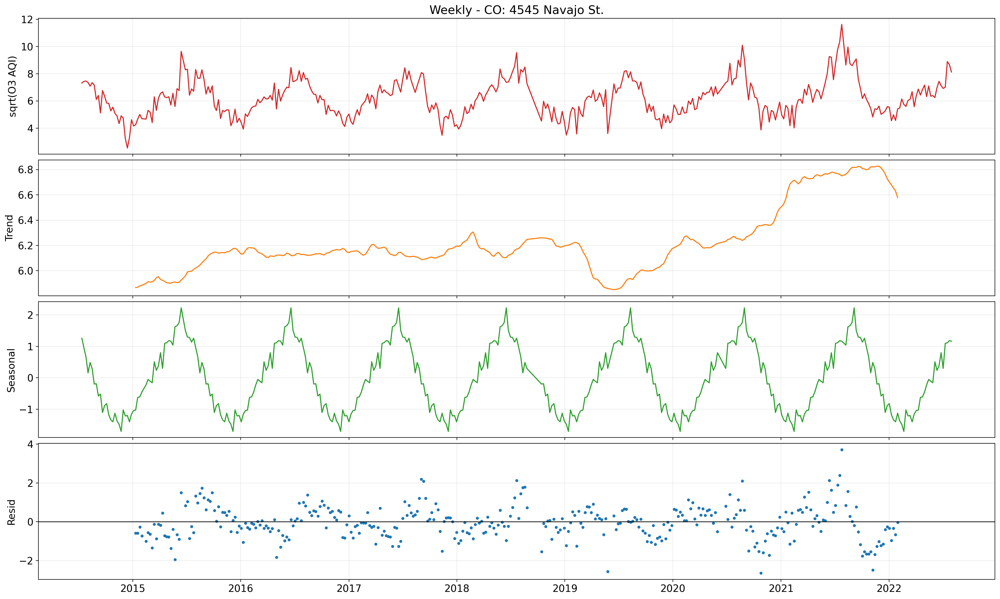

In [65]:
# CO time series decomposition
_ = seasonal_decompose_plotter(df_co_filled_W, period=365//7, title=f'Weekly - CO: {co_address}')

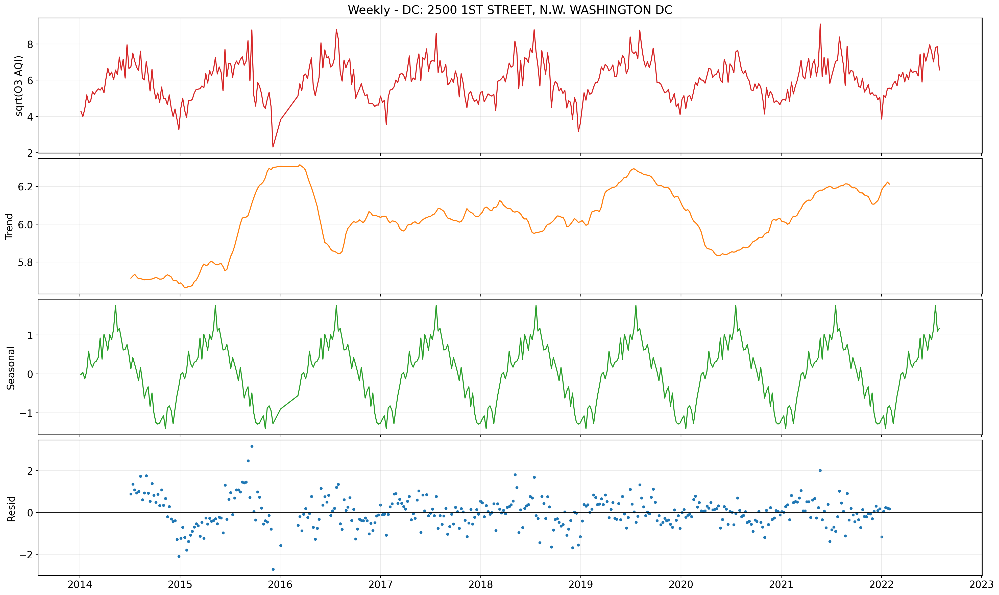

In [66]:
#### DC time series decomposition
_ = seasonal_decompose_plotter(df_dc_filled_W[df_dc_filled_W['Date'] > '2014'], period=365//7, title=f'Weekly - DC: {dc_address}')

### <b> 7.3.1 <span style='border-left: 4px solid #A4D4D6; padding-left: 10px;'> Decomposition Analysis for $\sqrt{\text{O3 AQI}}$ Levels<b>

**Observations for 2500 1st Street, N.W., Washington DC**
1. **Observed Data $\sqrt{\text{O3 AQI}}$**: Exhibits weekly variations, highlighting the effectiveness of the square root transformation in stabilizing variance and elucidating patterns.
2. **Trend**: Initial stability followed by increasing fluctuations suggests non-seasonal changes in O3 levels over time.
3. **Seasonal**: Reveals a consistent weekly pattern, potentially reflecting regular changes in emissions or atmospheric conditions.
4. **Residuals**: Mostly random fluctuations around zero, indicating good model fit with some outliers suggesting possible anomalies or unexpected events.

**Observations for 4545 Navajo St., CO**
1. **Observed Data $\sqrt{\text{O3 AQI}}$**: Shows weekly variability, supporting the use of square root transformation for variance reduction.
2. **Trend**: More pronounced oscillations in the trend may imply significant environmental or regulatory influences on O3 levels.
3. **Seasonal**: Consistent with the DC location, indicating similar weekly cyclical behavior in O3 levels.
4. **Residuals**: Scatter around the zero line with deviations, similar to the DC location, suggesting effective capture of the main influences on O3 levels.


<a name='stationarity'>
    
## <b> 7.4 <span style='border-left: 4px solid #A4D4D6; padding-left: 10px;'> Stationarity Test on Columns <b>


In [69]:
# Green or red depending on is Stationary
color_values = lambda val: f'color: green' if val == 'Yes' else  f'color: red'

# Perform the stationarity test
test_stationarity(df_co_filled_W[numeric_columns], significance_level=0.01).style.map(color_values, subset=['Is Stationary'])

,Test Statistic,p-value,Is Stationary,Critical Value 1%,Critical Value 5%,Critical Value 10%
O3 Mean,-5.870365,0.000000,Yes,-3.446888,-2.868829,-2.570653
O3 1st Max Value,-6.652607,0.000000,Yes,-3.447273,-2.868999,-2.570743
O3 1st Max Hour,-10.539018,0.000000,Yes,-3.446600,-2.868703,-2.570586
O3 AQI,-5.770256,0.000001,Yes,-3.446888,-2.868829,-2.570653
CO Mean,-6.104596,0.000000,Yes,-3.447057,-2.868904,-2.570693
CO 1st Max Value,-6.234156,0.000000,Yes,-3.447057,-2.868904,-2.570693
CO 1st Max Hour,-5.663628,0.000001,Yes,-3.447317,-2.869018,-2.570754
CO AQI,-6.655110,0.000000,Yes,-3.447186,-2.868960,-2.570723
SO2 Mean,-5.246129,0.000007,Yes,-3.446640,-2.868721,-2.570595
SO2 1st Max Value,-3.608634,0.005598,Yes,-3.446763,-2.868775,-2.570624


In [70]:
# Stationarity of columns of DC data
test_stationarity(df_dc_filled_W[numeric_columns], significance_level=0.01).style.map(color_values, subset=['Is Stationary'])

,Test Statistic,p-value,Is Stationary,Critical Value 1%,Critical Value 5%,Critical Value 10%
O3 Mean,-7.837274,0.000000,Yes,-3.443013,-2.867125,-2.569745
O3 1st Max Value,-7.867476,0.000000,Yes,-3.443013,-2.867125,-2.569745
O3 1st Max Hour,-5.427599,0.000003,Yes,-3.443087,-2.867158,-2.569762
O3 AQI,-7.560184,0.000000,Yes,-3.443037,-2.867136,-2.569750
CO Mean,-3.915246,0.001925,Yes,-3.442749,-2.867009,-2.569683
CO 1st Max Value,-4.277425,0.000486,Yes,-3.442749,-2.867009,-2.569683
CO 1st Max Hour,-6.984228,0.000000,Yes,-3.442725,-2.866998,-2.569677
CO AQI,-4.140832,0.000828,Yes,-3.442749,-2.867009,-2.569683
SO2 Mean,-5.662614,0.000001,Yes,-3.442867,-2.867061,-2.569710
SO2 1st Max Value,-5.099517,0.000014,Yes,-3.442867,-2.867061,-2.569710


### <b> 7.4.1 <span style='border-left: 4px solid #A4D4D6; padding-left: 10px;'> Autocorrelation & Partial Autocorrelation Function <b>

Having established the stationarity of our dataset, particularly for Ozone (O3) Air Quality Index (AQI) levels and its square root transformation, we now move to understanding the Autocorrelation Function (ACF) and the Partial Autocorrelation Function (PACF). These functions are important for identifying the appropriate lag values for forecasting models.

- **Autocorrelation Function (ACF)**: This tool helps in measuring the correlation between observations at different time lags; It shows how a data point in a time series is related to its past values. 

- **Partial Autocorrelation Function (PACF)**: While ACF considers all lagged correlations collectively, PACF isolates the correlation between observations at a particular lag, discounting the influence of correlations at shorter lags. This is crucial to distinguish between the direct effect of past values on the current value from indirect effects mediated through intermediate values.


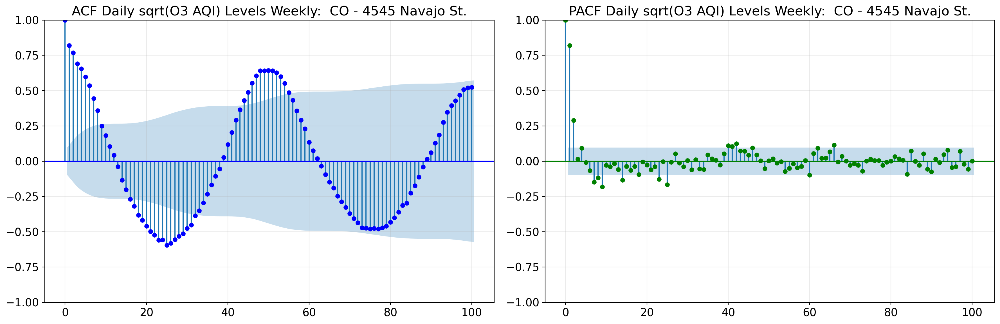

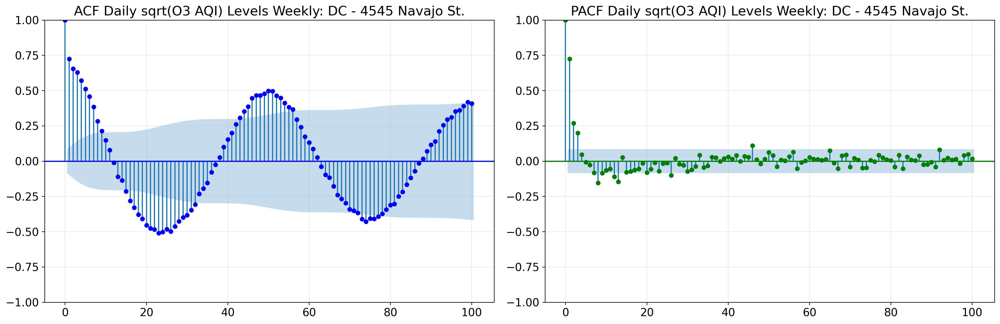

In [72]:
# Plotting aggregation of CO data
ACF_frame_plotter(df_co_filled_W, 
                  columns=['sqrt(O3 AQI)'],
                  lags=100,
                  title=f'Weekly:  CO - {co_address}',
                  figsize=(18, 6))


# Plotting aggregation of CO data
ACF_frame_plotter(df_dc_filled_W, 
                  columns=['sqrt(O3 AQI)'],
                  lags=100,
                  title=f'Weekly: DC - {co_address}',
                  figsize=(18, 6))


### <b> 7.4.2 <span style='border-left: 4px solid #A4D4D6; padding-left: 10px;'>Autocorrelation and Partial Autocorrelation Analysis<b>

**Observations for 4545 Navajo St., CO**
1. **ACF Analysis**: Shows a gradual decline with lags, indicative of a trending time series, and occasional spikes suggesting seasonality.
2. **PACF Analysis**: A significant spike at the first lag and sharp cut-off thereafter imply an AR(1), possbily AR(2), model might be fitting.

**Observations for 2500 1ST STREET, N.W. WASHINGTON DC**
1. **ACF Analysis**: A declining trend with lags is observed here too, but without the clear seasonal spikes seen in the Colorado data.
2. **PACF Analysis**: A strong initial correlation followed by a cut-off also suggests an AR(1) or AR(2), possibly AR(3), model may be appropriate.

**Insights for Further Analysis**
1. **Modeling**: Both locations potentially follow an AR(1) orAR(2), indicating that using an autoregressive model of order 1 or 2 could be beneficial for forecasting.
2. **Trend and Seasonality**: The presence of trends and differing strengths in seasonality between the two locations should be considered when modeling.

---


<a name='TSCO'>


# <b> 8 <span style='border-left: 4px solid #A4D4D6; padding-left: 10px;'> Time Series Modeling - `4545 Navajo St., CO` </b>

- This section explores the use of Seasonal Autoregressive Integrated Moving Average (SARIMA) models to forecast ozone levels at `4545 Navajo St., Colorado`. Our goal is to determine the most accurate forecasting model through a train-test split approach, focusing on models that minimize the Mean Squared Error (MSE) on test data.

- The SARIMA models are evaluated based on their non-seasonal and seasonal parameters, with the seasonal period set to 52 weeks. Model selection is informed by both MSE and information criteria—AIC and BIC—which balance fit quality against complexity. The best-performing model will provide a robust forecast while avoiding overfitting.

- Note that a weekly mean with $s=52$ corresponds to a seasonal term that is annual, equating to 364 days.

- In the cell below, various trials were conducted to assess the best values for the ARIMA base model. The optimal values found were $(p, d, q) = (1, 0, 1)$. From this, we will proceed to assess the best $(P, D, Q)_s$ values.

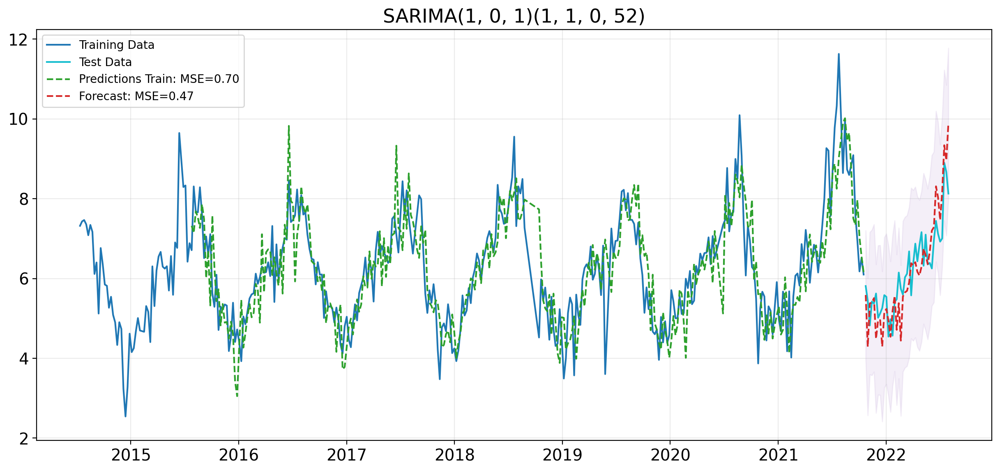

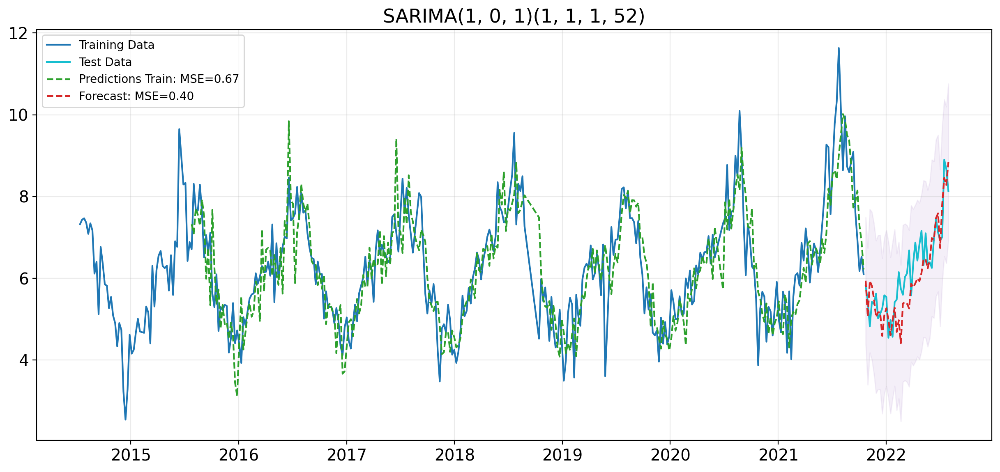

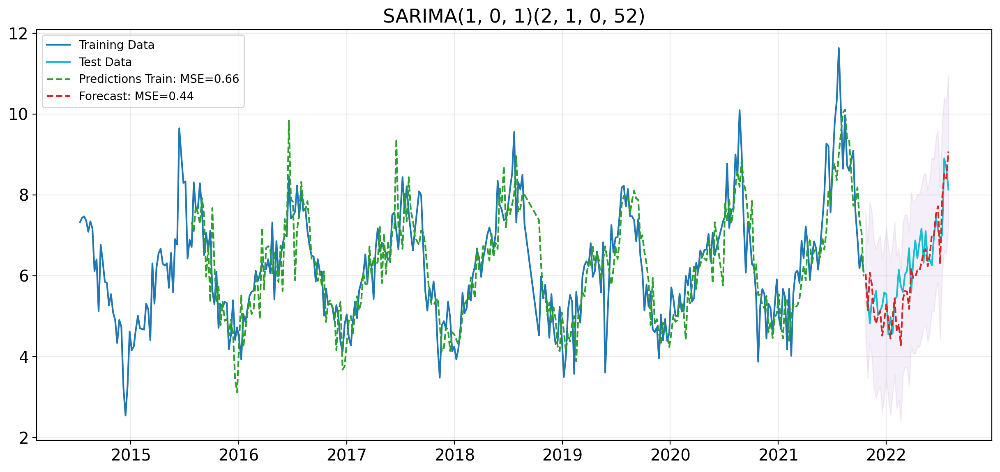

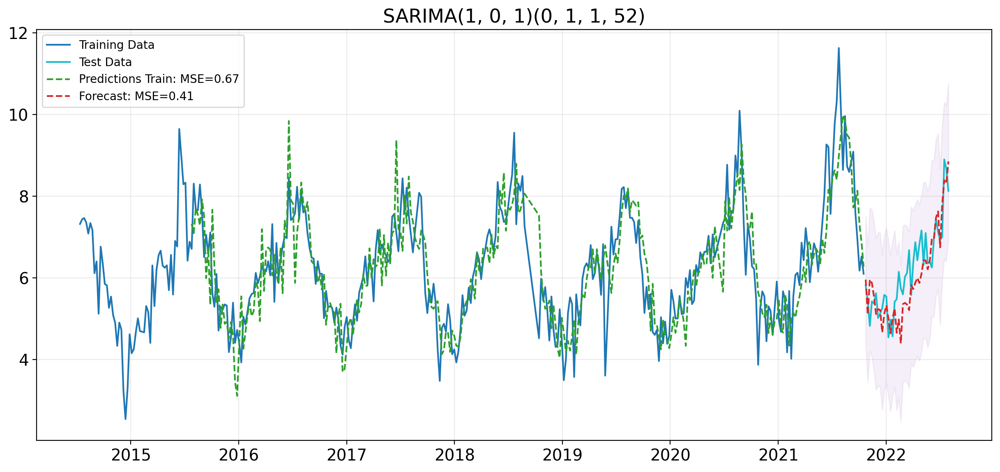

/Users/gassanyacteen/anaconda3/envs/Deep_Learning/lib/python3.11/site-packages/statsmodels/tsa/statespace/sarimax.py:1009: UserWarning:

Non-invertible starting seasonal moving average Using zeros as starting parameters.



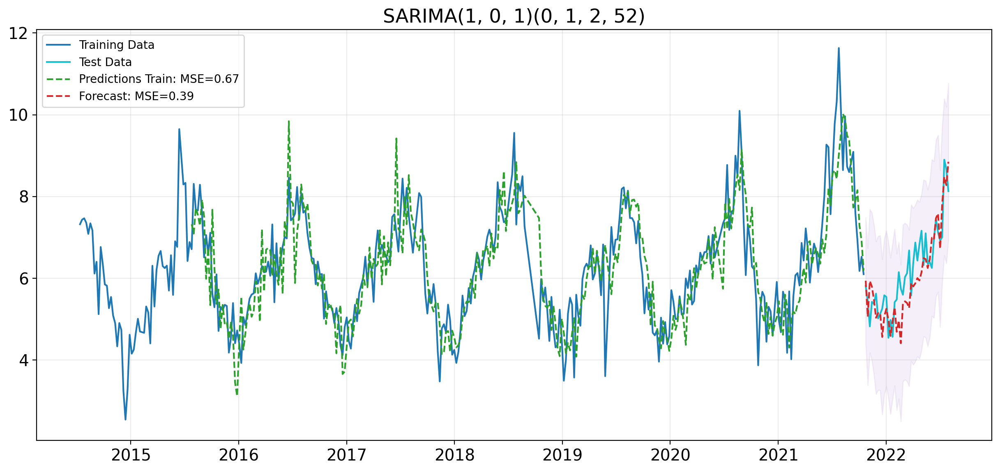

,Model,MSE Train,MSE Test,AIC,BIC
0,"SARIMA(1, 0, 1)(1, 1, 0, 52)",0.7029,0.4690,789.2855,804.2830
1,"SARIMA(1, 0, 1)(1, 1, 1, 52)",0.6652,0.3956,775.3755,794.1225
2,"SARIMA(1, 0, 1)(2, 1, 0, 52)",0.6594,0.4368,772.6699,791.4169
3,"SARIMA(1, 0, 1)(0, 1, 1, 52)",0.6657,0.4090,773.8882,788.8858
4,"SARIMA(1, 0, 1)(0, 1, 2, 52)",0.6650,0.3931,775.2367,793.9837


In [75]:
# ORDER, SEASONALITY
s = 52
model_specs = [
    ((1, 0, 1), (1, 1, 0, s)),
    ((1, 0, 1), (1, 1, 1, s)),
    ((1, 0, 1), (2, 1, 0, s)),
    ((1, 0, 1), (0, 1, 1, s)),
    ((1, 0, 1), (0, 1, 2, s)),
]

# Evaluate SARIMA models
results = []
for order, seasonal_order in model_specs:

    # Making evaluation
    title = f"SARIMA{order}{seasonal_order}"
    mse_train, mse_test, model_fit = train_test_SARIMA_evaluate(df_co_filled_W,
                                                                order, 
                                                                seasonal_order,
                                                                val_col='sqrt(O3 AQI)',
                                                                title=title)
    results.append((title, mse_train, mse_test, model_fit.aic, model_fit.bic))

# DataFrame compare models
comparison_df = pd.DataFrame(results, columns=['Model', 'MSE Train', 'MSE Test', 'AIC', 'BIC'])
display(comparison_df)

### <b> $\nabla$ <span style='border-left: 4px solid #A4D4D6; padding-left: 10px;'> SARIMA Model Parameters - `4545 Navajo St., CO` </b>

This section presents the evaluation of SARIMA models fitted on square root-transformed Ozone Air Quality Index (O3 AQI) data in Colorado. The model SARIMA(1, 0, 1)(2, 1, 0, 52) is chosen based on its performance metrics, showcasing an optimal balance in model fit and predictive ability.

|   | Model                        | MSE Train | MSE Test | AIC        | BIC        |
|---|------------------------------|-----------|----------|------------|------------|
| 0 | SARIMA(1, 0, 1)(1, 1, 0, 52) | 0.703     | 0.469    | 789.286    | 804.283    |
| 1 | SARIMA(1, 0, 1)(1, 1, 1, 52) | 0.665     | 0.396    | 775.376    | 794.123    |
| 2 | SARIMA(1, 0, 1)(2, 1, 0, 52) | 0.659     | 0.437    | 772.670    | 791.417    |
| 3 | SARIMA(1, 0, 1)(0, 1, 1, 52) | 0.666     | 0.409    | 773.888    | 788.886    |
| 4 | SARIMA(1, 0, 1)(0, 1, 2, 52) | 0.665     | 0.393    | 775.237    | 793.984    |

- **Model Selection**: The SARIMA(1, 0, 1)(2, 1, 0, 52) model is selected for its relatively low MSE in testing ($\text{MSE} = 0.437$) and training, alongside its favorable AIC and BIC scores. Though this had higher AIC values and mean squared error than SARIMA(1, 0, 1)(0, 1, 1, 52), this model was chosen to compare with the DC model later. Also note a few more data points were added on to this CO address, with the updated data for 2023, this slightly changed the results which prior agreed more with the SARIMA(1, 0, 1)(2, 1, 0, 52) model.
  
- **Model Performance**: This model demonstrates a strong balance between training accuracy and generalizability to unseen data, a key consideration in time-series forecasting.
- **Comparative Analysis**: While other models like SARIMA(1, 0, 1)(1, 1, 1, 52) exhibit lower MSE in testing, the chosen model achieves a better balance with its AIC and BIC, indicating a more efficient model in terms of complexity and fit.
- **Implementation Decision**: We will proceed with the $\text{ARIMA}(1, 0, 1)(2, 1, 0)_{52}$ model, as it provides a comprehensive understanding of seasonal trends in the O3 AQI data for Colorado.

<class 'statsmodels.iolib.summary.Summary'>
"""
                                     SARIMAX Results                                     
=========================================================================================
Dep. Variable:                      sqrt(O3 AQI)   No. Observations:                  366
Model:             ARIMA(1, 0, 1)x(2, 1, [], 52)   Log Likelihood                -381.335
Date:                           Sun, 10 Dec 2023   AIC                            772.670
Time:                                   17:39:59   BIC                            791.417
Sample:                                        0   HQIC                           780.161
                                           - 366                                         
Covariance Type:                             opg                                         
==============================================================================
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
ar.L1          0.8115      0.050     16.179      0.000       0.713       0.910
ma.L1         -0.3991      0.084     -4.751      0.000      -0.564      -0.234
ar.S.L52      -0.5873      0.053    -11.100      0.000      -0.691      -0.484
ar.S.L104     -0.3054      0.069     -4.402      0.000      -0.441      -0.169
sigma2         0.6186      0.043     14.426      0.000       0.535       0.703
===================================================================================
Ljung-Box (L1) (Q):                   0.01   Jarque-Bera (JB):                23.49
Prob(Q):                              0.91   Prob(JB):                         0.00
Heteroskedasticity (H):               1.60   Skew:                            -0.26
Prob(H) (two-sided):                  0.02   Kurtosis:                         4.23
===================================================================================

Warnings:
[1] Covariance matrix calculated using the outer product of gradients (complex-step).
"""

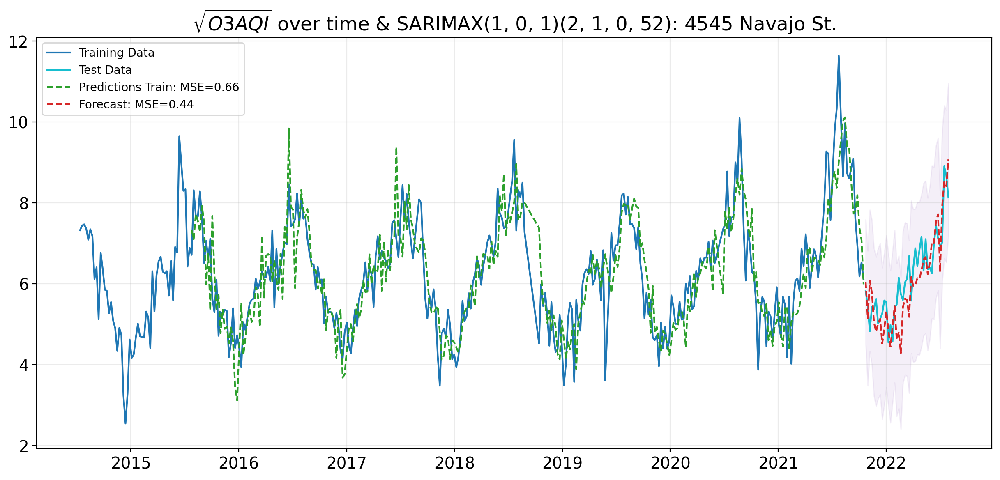

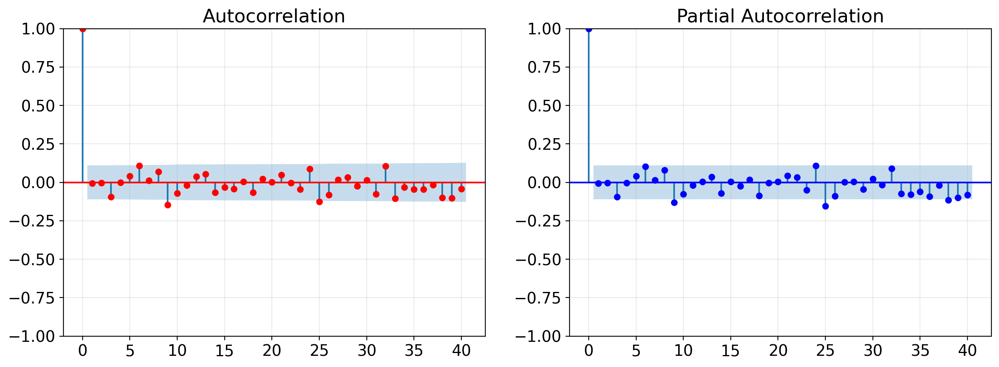

In [77]:
# Train test split starts at the end of 2021
order = (1, 0, 1)
seasonal_order = (2, 1, 0, 52)
title = f'$\sqrt{{O3 AQI}}$ over time & SARIMAX{order}{seasonal_order}: {co_address}'

mse_train, mse_test, model_fit = train_test_SARIMA_evaluate(df_co_filled_W, 
                                                            order, 
                                                            seasonal_order, 
                                                            val_col='sqrt(O3 AQI)',
                                                            title=title,
                                                            show_summary=True, 
                                                            lags=40)


### <b> $\nabla$ <span style='border-left: 4px solid #A4D4D6; padding-left: 10px;'> Summary of SARIMA Model Fitting: `4545 Navajo St., CO`</b>

- **Model Coefficients**: The autoregressive term at lag 1, AR(1), is positive and statistically significant, indicating a strong relationship with the immediate past value. The moving average term at lag 1, MA(1), suggests an inverse relationship with the past error. This finding is interesting as one might have expected the past error to have a positive correlation with the environment's O3 AQI values. The seasonal autoregressive terms at lags 52 and 104 are negative, reflecting an annual seasonal effect.

- **Model Diagnostics**: The model has a Log Likelihood of -389.379. The Ljung-Box test indicates no autocorrelation in residuals, suggesting that the model captures the data's autocorrelation structure well. However, the Jarque-Bera test result indicates non-normality in residuals, which could affect the model’s predictive accuracy, and the significant result of the heteroskedasticity test suggests a changing variance in residuals over time.

- **Residual ACF & PACF**: The autocorrelation and partial autocorrelation plots of residuals indicate that the model has accounted for most of the autocorrelation, but some points fall outside the confidence interval, which could signal model misspecifications.

<a name='sarimaxallco'>
    
## <b> 8.1 <span style='border-left: 4px solid #A4D4D6; padding-left: 10px;'> SARIMAX Model Trained On All $\sqrt{\text{O3 AQI}}$ Data - `4545 Navajo St., CO` </b>

<class 'statsmodels.iolib.summary.Summary'>
"""
                                     SARIMAX Results                                     
=========================================================================================
Dep. Variable:                      sqrt(O3 AQI)   No. Observations:                  407
Model:             ARIMA(1, 0, 1)x(2, 1, [], 52)   Log Likelihood                -422.375
Date:                           Sun, 10 Dec 2023   AIC                            854.751
Time:                                   17:40:13   BIC                            874.111
Sample:                                        0   HQIC                           862.453
                                           - 407                                         
Covariance Type:                             opg                                         
==============================================================================
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
ar.L1          0.8201      0.046     17.704      0.000       0.729       0.911
ma.L1         -0.4308      0.078     -5.502      0.000      -0.584      -0.277
ar.S.L52      -0.5961      0.048    -12.369      0.000      -0.691      -0.502
ar.S.L104     -0.2544      0.059     -4.307      0.000      -0.370      -0.139
sigma2         0.5965      0.038     15.672      0.000       0.522       0.671
===================================================================================
Ljung-Box (L1) (Q):                   0.02   Jarque-Bera (JB):                29.47
Prob(Q):                              0.89   Prob(JB):                         0.00
Heteroskedasticity (H):               1.41   Skew:                            -0.29
Prob(H) (two-sided):                  0.06   Kurtosis:                         4.29
===================================================================================

Warnings:
[1] Covariance matrix calculated using the outer product of gradients (complex-step).
"""

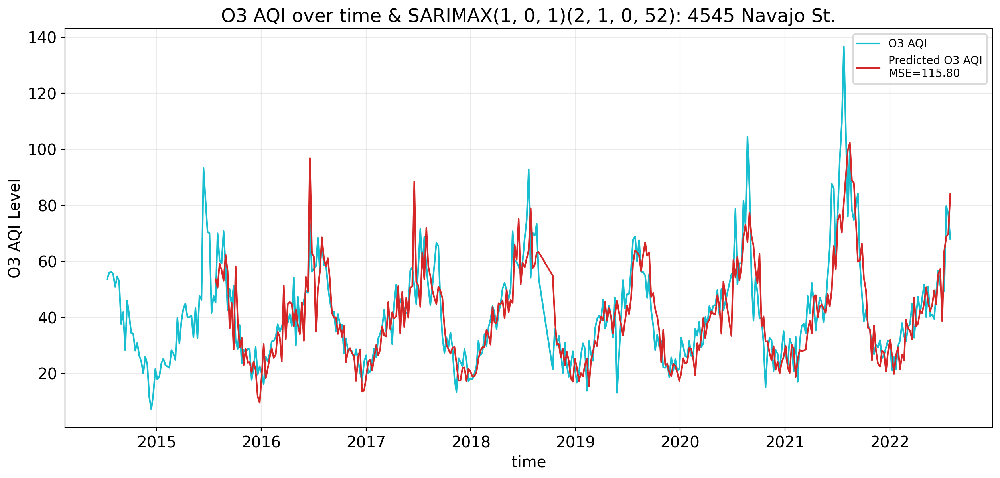

The model is causal.
The model is invertible.


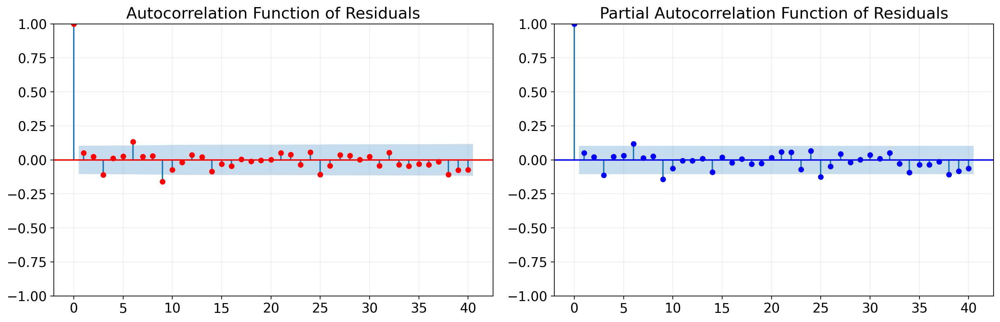

In [80]:
# Building custom ARIMA model for all data points
order = (1, 0, 1)
seasonal_order = (2, 1, 0, 52)

# Fitting model
model_co = ARIMA(df_co_filled_W['sqrt(O3 AQI)'], order=order, seasonal_order=seasonal_order)
model_fit_co = model_co.fit()

# Getting fitted values
index_start = max(order[1], seasonal_order[1] * seasonal_order[3])
fitted_values = model_fit_co.fittedvalues[index_start:]
    
# Model summary
display(model_fit_co.summary())

# Transforming to original units & plotting
mse_co, transformed_predicted_co = transform_data(df=df_co_filled_W, 
                                                  predicted=fitted_values, 
                                                  index_start=index_start,
                                                  title=f'O3 AQI over time & SARIMAX{order}{seasonal_order}: {co_address}',
                                                  ylabel='O3 AQI Level',
                                                  lags=40)


# Checking for causality and invertibility
is_causal, is_invertible = check_causality_invertibility(model_fit_co)
print(f"The model is {'causal' if is_causal else 'non-causal'}.")
print(f"The model is {'invertible' if is_invertible else 'non-invertible'}.")

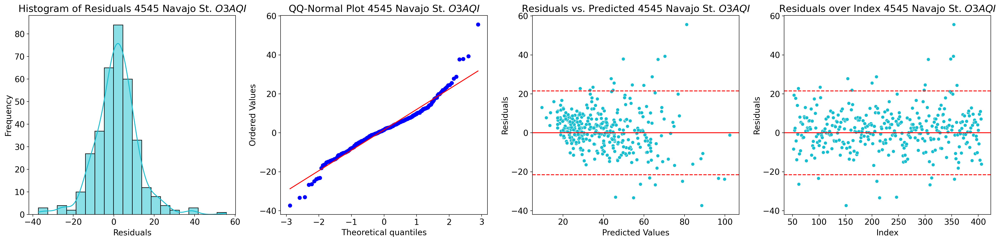

Fitted Data CO RMSE = 10.76


In [81]:
# Error Analysis of CO O3 AQI
co_rmse = model_error_analysis(df_co_filled_W['O3 AQI'][index_start:],
                               transformed_predicted_co,
                               title=f'{co_address} $O3 AQI$',
                               color='C9')

print(f'Fitted Data CO RMSE = {co_rmse:0.2f}')

### <b> 8.1.1 <span style='border-left: 4px solid #A4D4D6; padding-left: 10px;'> Model Evaluation for Full 03 AQI Data - `4545 Navajo St., CO`</span></b>

**Model Performance Insights:**
- **Significance of Coefficients**: The AR term at 0.82 and the MA term at -0.43 are significant, confirming the patterns observed in previous analyses. The negative seasonal AR coefficients align with the identified seasonal variations.

- **Predictive Accuracy**: An MSE of 116 reflects the model's level of predictive error, which appears reasonable considering the extensive variations and oscillations in the time series data.

- **Residual Behaviors**: The Ljung-Box test result (Prob(Q) = 0.89) suggests no significant autocorrelation in the residuals, indicating a well-fitting model. However, the Jarque-Bera test signifies non-normality in the residuals, and the Prob(H) value of 0.06 points to residual heteroskedasticity, highlighting potential areas for model enhancement.

- **Correlation Analysis**: The ACF and PACF plots show that the model captures the residuals adequately, with only sporadic deviations beyond the confidence intervals.

- **Error Analysis**: The histogram closely resembles a normal distribution. The QQ plot largely matches the expected normal values, albeit with some deviations at the extremes. The plot of Residuals versus Predicted Values indicates signs of heteroskedasticity. The Residuals versus Index plot shows a random distribution of errors relative to the time series model, which is positive; however, a significant spike around index 350—coinciding with a major `O3 AQI` emission event—warrants additional examination.


<a name='coforecast'>
    
## <b> 8.2 <span style='border-left: 4px solid #A4D4D6; padding-left: 10px;'> SARIMA Model Forecasting - `4545 Navajo St., CO` </b>


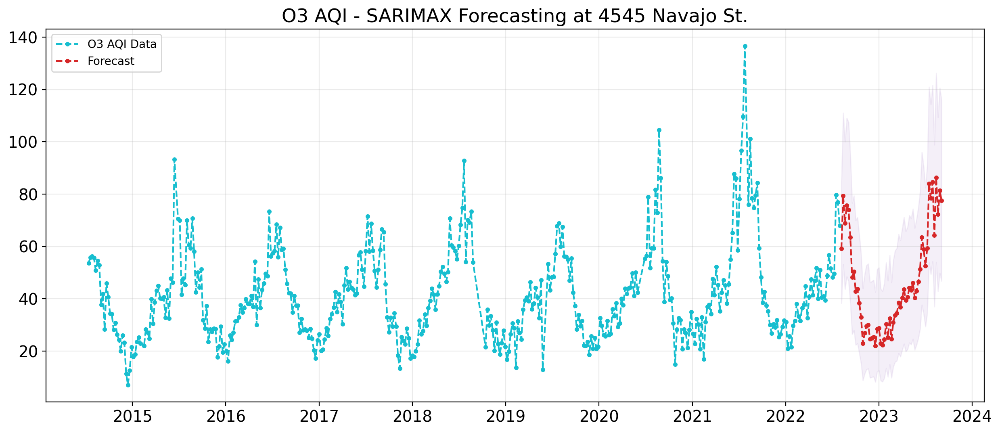

In [84]:
df_forecast_co = forcast_SARIMAX(model_fit_co,
                                 df_co_filled_W, 
                                 steps=57, 
                                 val_col='O3 AQI',
                                 title=f'O3 AQI - SARIMAX Forecasting at {co_address}')
# display(df_forecast_co.style.background_gradient('gray_r'))

### <b> 8.2.1 <span style='border-left: 4px solid #A4D4D6; padding-left: 10px;'> Forecast Analysis for O3 AQI Levels - `4545 Navajo St., CO`</span></b>
The SARIMA model's forecasts for future `O3 AQI` levels in Washington DC provide insights into potential air quality trends. Here is a summary of the findings based on the forecasted values:

- **Short-term Outlook**: The immediate forecast indicates a decrease in `O3 AQI` levels, suggesting better air quality in the near future. The confidence intervals, although showing some uncertainty, support this positive outlook.

- **Mid-term Trend**: The model predicts a rise in `O3 AQI` from January through August, consistent with expected seasonal effects due to higher temperatures, which often correlate with increased ozone formation.

- **Long-term Concerns**: Forecasts for summer months show a considerable rise in `O3 AQI`, with levels potentially affecting sensitive groups. The widening confidence intervals hint at higher uncertainty but also the possibility of even greater ozone concentrations. In addition to this people usually spend more time outside during the summer months which can contribute to the local populations health.

- **Regulatory Considerations**: The anticipated seasonal increase in ozone highlights the need for scrutiny of existing air quality controls and potential preemptive measures to safeguard public health.

- **Policy Implications**: Given the sporadic nature of the peaks and the lack of a worsening trend, it may not be necessary to impose stricter pollution regulations immediately. However, policymakers should remain vigilant, especially during the predicted peak periods, and consider short-term measures to mitigate any potential impacts on public health.


<a name='conewdata'>
    
## <b> 8.3 <span style='border-left: 4px solid #A4D4D6; padding-left: 10px;'> Forecast With Newly Updated Goverment Data - `4545 Navajo St., CO`</span></b>

- Below I added a quick addition due to the newly added 2023 data set! I'd say not too bad!

In [87]:
def forecast_new_data(data: pd.DataFrame, forecast: pd.DataFrame, figsize=(15, 8)) -> pd.DataFrame:
    """
    Plot the actual and forecasted O3 AQI values and calculate RMSE.

    This function takes actual data and forecast data, calculates the Root Mean 
    Square Error (RMSE) between the actual and forecasted values, and plots 
    both sets of data for comparison. It also plots the confidence interval 
    for the forecast.

    Parameters:
    - data (pd.DataFrame): DataFrame with actual O3 AQI values and dates.
                           Expected to have columns 'Date' and 'O3 AQI'.
    - forecast (pd.DataFrame): DataFrame with forecasted O3 AQI values, dates,
                               and confidence intervals. Expected to have columns
                               'Date', 'Forecast_O3 AQI', 'CI Lower', and 'CI Upper'.
    - figsize (tuple): Size of the figure (width, height) in inches.

    Returns:
    - pd.DataFrame: DataFrame with actual values, forecasted values, and error.

    Raises:
    - ValueError: If 'Date' column is not found in either DataFrame.
    """

    # Check for 'Date' column in both dataframes
    if 'Date' not in data.columns or 'Date' not in forecast.columns:
        raise ValueError("Both data and forecast must have a 'Date' column")

    # Combine and calculate error
    df_updated = pd.concat([data.set_index('Date'), forecast.set_index('Date')], axis=1)
    df_updated['error'] = df_updated['O3 AQI'] - df_updated['Forecast_O3 AQI']
    rmse = np.sqrt(np.mean(df_updated['error']**2))

    # Filter data for overlap with forecast
    date_min = forecast['Date'].min()
    data = data[data['Date'] >= date_min][['Date', 'O3 AQI']]

    # Plotting data and forecast
    plt.figure(figsize=figsize)
    plt.plot(data['Date'], data['O3 AQI'], color='green', marker='.', label='O3 AQI Data')
    plt.fill_between(forecast['Date'], forecast['CI Lower'], forecast['CI Upper'], color='skyblue', alpha=0.35)
    plt.plot(forecast['Date'], forecast['Forecast_O3 AQI'], color='blue', marker='.', label=f'Forecast - RMSE={rmse:.2f}')
    plt.title('Forecast of Ozone Air Quality Index (O3 AQI)')
    plt.ylabel('O3 AQI')
    plt.xlabel('Date')
    plt.xticks(rotation=45)
    plt.legend(fontsize=10)
    plt.grid(alpha=0.25)
    plt.tight_layout()
    plt.show()

    return df_updated


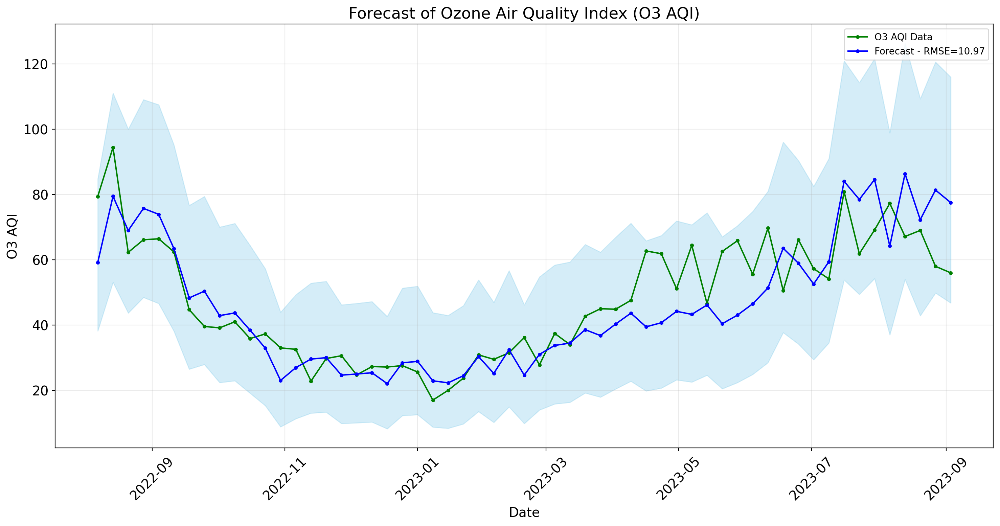

,State,O3 AQI,Forecast_O3 AQI,CI Lower,CI Upper,error
Date,,,,,,
2022-08-07 00:00:00,CO,79.428571,59.208388,38.204113,84.795549,20.220183
2022-08-14 00:00:00,CO,94.428571,79.444433,53.125991,111.040245,14.984138
2022-08-21 00:00:00,CO,62.285714,68.982268,43.702643,100.006311,-6.696554
2022-08-28 00:00:00,CO,66.142857,75.749816,48.482832,109.075311,-9.606959
2022-09-04 00:00:00,CO,66.428571,73.934124,46.620747,107.517242,-7.505552
2022-09-11 00:00:00,CO,62.428571,63.438825,38.122560,95.166887,-1.010253
2022-09-18 00:00:00,CO,44.714286,48.318067,26.494984,76.648481,-3.603782
2022-09-25 00:00:00,CO,39.571429,50.381668,27.934712,79.400202,-10.810239
2022-10-02 00:00:00,CO,39.142857,42.896810,22.381810,70.026595,-3.753953


In [88]:
# Plotting the forecast with the new updated 2023 data set for CO
df_co_test_W = compute_aggregations(df_test[df_test['Address'] == co_address], value_columns=['O3 AQI'], time_frame='W')
new_data_df_co = forecast_new_data(df_co_test_W, df_forecast_co)
display(new_data_df_co.style.background_gradient('gray_r'))

<a name='TSDC'>

---

# <b> 9 <span style='border-left: 4px solid #A4D4D6; padding-left: 10px;'> Time Series Modeling - 2500 1ST STREET, N.W. WASHINGTON DC </b>

- This section explores the use of Seasonal Autoregressive Integrated Moving Average (SARIMA) models to forecast ozone levels at `2500 1st Street, N.W., Washington DC`. Our goal is to determine the most accurate forecasting model through a train-test split approach, focusing on models that minimize the Mean Squared Error (MSE) on test data.

- The SARIMA models are evaluated based on their non-seasonal and seasonal parameters, with the seasonal period set to 52 weeks. Model selection is guided by both MSE and information criteria—AIC and BIC—which balance fit quality against complexity. The best-performing model will provide a robust forecast while avoiding overfitting.

- Note that a weekly mean with $ s=52 $ corresponds to a seasonal term that is annual, equating to 364 days.

- In the cell below, various trials were conducted to assess the best values for the ARIMA base model. The optimal values found were $ (p, d, q) = (1, 0, 1) $ From this point, we will proceed to assess the best $ (P, D, Q)_s $ values.

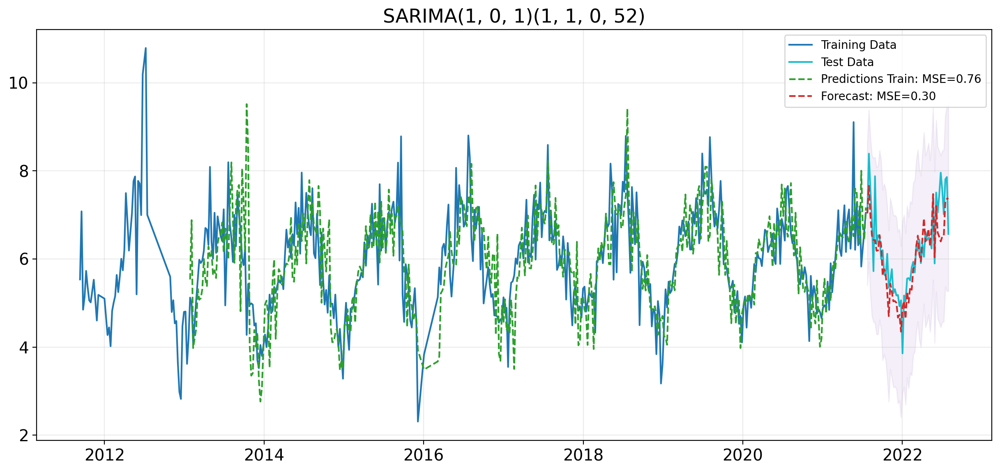

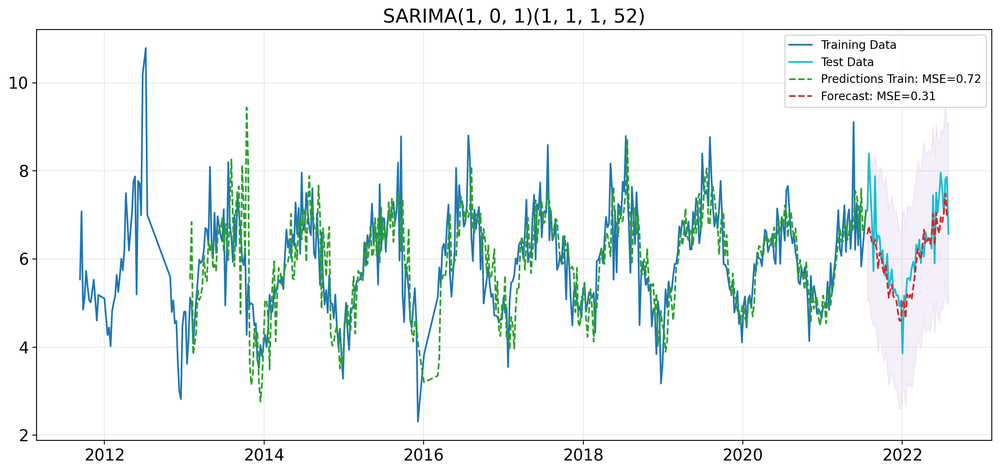

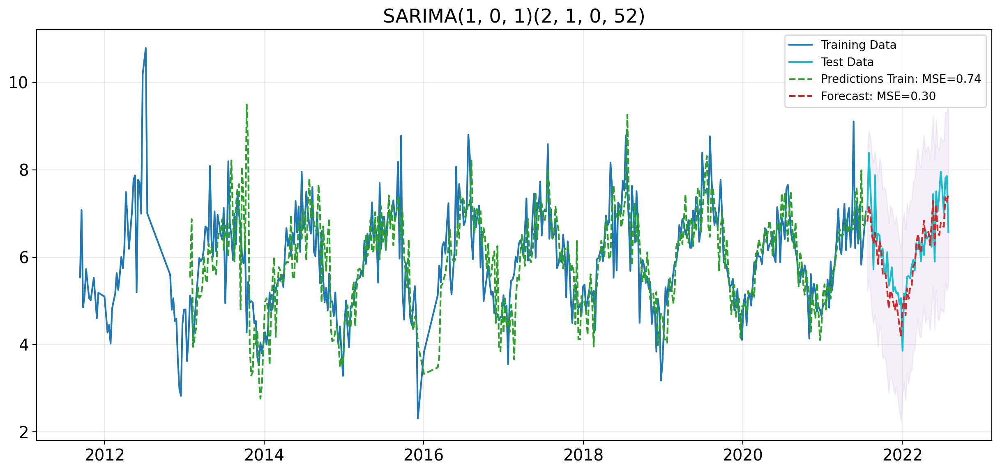

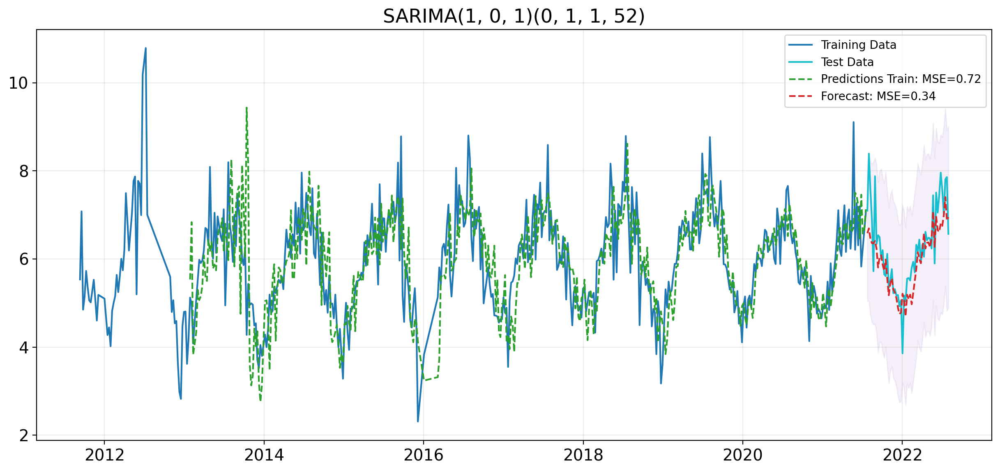

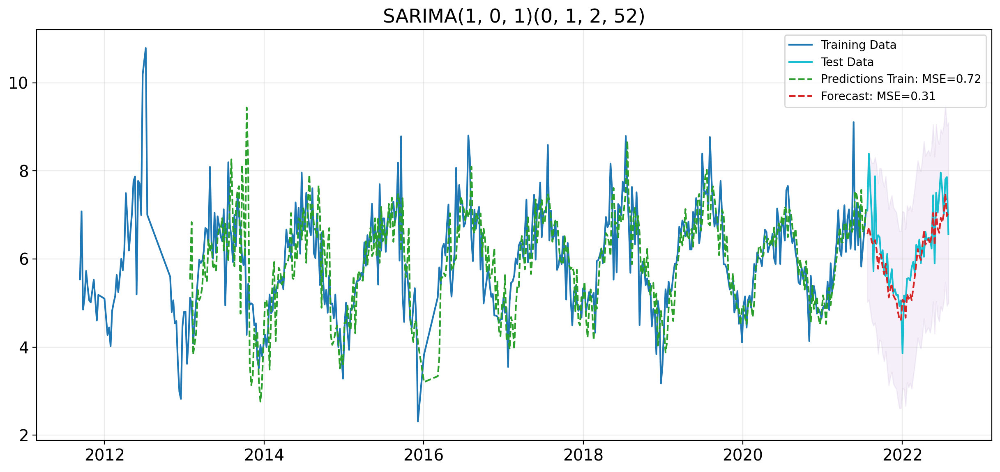

,Model,MSE Train,MSE Test,AIC,BIC
0,"SARIMA(1, 0, 1)(1, 1, 0, 52)",0.7552,0.2977,1089.6410,1105.8961
1,"SARIMA(1, 0, 1)(1, 1, 1, 52)",0.7203,0.3082,1063.5428,1083.8617
2,"SARIMA(1, 0, 1)(2, 1, 0, 52)",0.7406,0.2959,1080.7822,1101.1011
3,"SARIMA(1, 0, 1)(0, 1, 1, 52)",0.7205,0.3374,1063.2462,1079.5013
4,"SARIMA(1, 0, 1)(0, 1, 2, 52)",0.7203,0.3130,1063.9130,1084.2319


In [90]:
# ORDER, SEASONALITY
s = 52
model_specs = [
    ((1, 0, 1), (1, 1, 0, s)),
    ((1, 0, 1), (1, 1, 1, s)),
    ((1, 0, 1), (2, 1, 0, s)),
    ((1, 0, 1), (0, 1, 1, s)),
    ((1, 0, 1), (0, 1, 2, s)),
]

# Evaluate SARIMA models
results = []
for order, seasonal_order in model_specs:

    # Making evaluation
    title = f"SARIMA{order}{seasonal_order}"
    mse_train, mse_test, model_fit = train_test_SARIMA_evaluate(df_dc_filled_W,
                                                                order, 
                                                                seasonal_order,
                                                                val_col='sqrt(O3 AQI)',
                                                                title=title)
    results.append((title, mse_train, mse_test, model_fit.aic, model_fit.bic))

# DataFrame compare models
comparison_df = pd.DataFrame(results, columns=['Model', 'MSE Train', 'MSE Test', 'AIC', 'BIC'])
display(comparison_df)

### <b> $\nabla$ <span style='border-left: 4px solid #A4D4D6; padding-left: 10px;'> SARIMA Model Parameters - `2500 1ST STREET, N.W. WASHINGTON DC` </b>

The table below summarizes the results of SARIMA model fitting for two datasets: square root-transformed Ozone Air Quality Index (O3 AQI) data for Washington DC. The SARIMA(1, 0, 1)(2, 1, 0, 52) model configuration was found to provide the best balance between fit and complexity, as indicated by its low MSE values and favorable AIC and BIC scores. This suggests a consistent seasonal pattern in air quality data that is captured well by this specific SARIMA model.

|     | Model                        | MSE Train | MSE Test | AIC       | BIC       |
|-----|------------------------------|-----------|----------|-----------|-----------|
| 0   | SARIMA(1, 0, 1)(1, 1, 0, 52) | 0.755     | 0.298    | 1089.641  | 1105.896  |
| 1   | SARIMA(1, 0, 1)(1, 1, 1, 52) | 0.720     | 0.308    | 1063.543  | 1083.862  |
| 2   | SARIMA(1, 0, 1)(2, 1, 0, 52) | 0.741     | 0.296    | 1080.782  | 1101.101  |
| 3   | SARIMA(1, 0, 1)(0, 1, 1, 52) | 0.721     | 0.339    | 1063.246  | 1079.501  |
| 4   | SARIMA(1, 0, 1)(0, 1, 2, 52) | 0.720     | 0.314    | 1063.913  | 1084.232  |

- **Model Selection**: The chosen model should ideally show the lowest MSE on test data, as it reflects the model's ability to forecast accurately on unseen data. In this case, the SARIMA(1, 0, 1)(2, 1, 0, 52) model shows the lowest MSE on the test set with a value of `0.296`, which makes it the preferred model in terms of prediction. 
- **Model Performance**: Interestingly, the SARIMA(1, 0, 1)(1, 1, 0, 52) model has a slightly higher MSE on the test data compared to SARIMA(1, 0, 1)(2, 1, 0, 52), but a significantly lower AIC and BIC. This suggests that while it may not be the best model for prediction, it has a better balance between model fit and complexity.
- **Information Criteria**: The AIC and BIC are lower for the SARIMA(1, 0, 1)(1, 1, 1, 52) model, indicating that it provides a better fit to the data with fewer parameters. Lower AIC and BIC values generally suggest a more parsimonious model.
- **Moving Forward**: we will use $\text{ARIMA}(p, d, q)(P, D, Q)_s$ = **$\text{ARIMA}(1, 0, 1)(2, 1, 0)_{52}$**.


<class 'statsmodels.iolib.summary.Summary'>
"""
                                     SARIMAX Results                                     
=========================================================================================
Dep. Variable:                      sqrt(O3 AQI)   No. Observations:                  482
Model:             ARIMA(1, 0, 1)x(2, 1, [], 52)   Log Likelihood                -535.391
Date:                           Sun, 10 Dec 2023   AIC                           1080.782
Time:                                   17:42:09   BIC                           1101.101
Sample:                                        0   HQIC                          1088.806
                                           - 482                                         
Covariance Type:                             opg                                         
==============================================================================
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
ar.L1          0.8731      0.038     23.007      0.000       0.799       0.947
ma.L1         -0.5361      0.060     -8.892      0.000      -0.654      -0.418
ar.S.L52      -0.6344      0.042    -15.147      0.000      -0.717      -0.552
ar.S.L104     -0.1857      0.050     -3.705      0.000      -0.284      -0.087
sigma2         0.6715      0.038     17.812      0.000       0.598       0.745
===================================================================================
Ljung-Box (L1) (Q):                   0.32   Jarque-Bera (JB):                71.01
Prob(Q):                              0.57   Prob(JB):                         0.00
Heteroskedasticity (H):               0.51   Skew:                            -0.33
Prob(H) (two-sided):                  0.00   Kurtosis:                         4.88
===================================================================================

Warnings:
[1] Covariance matrix calculated using the outer product of gradients (complex-step).
"""

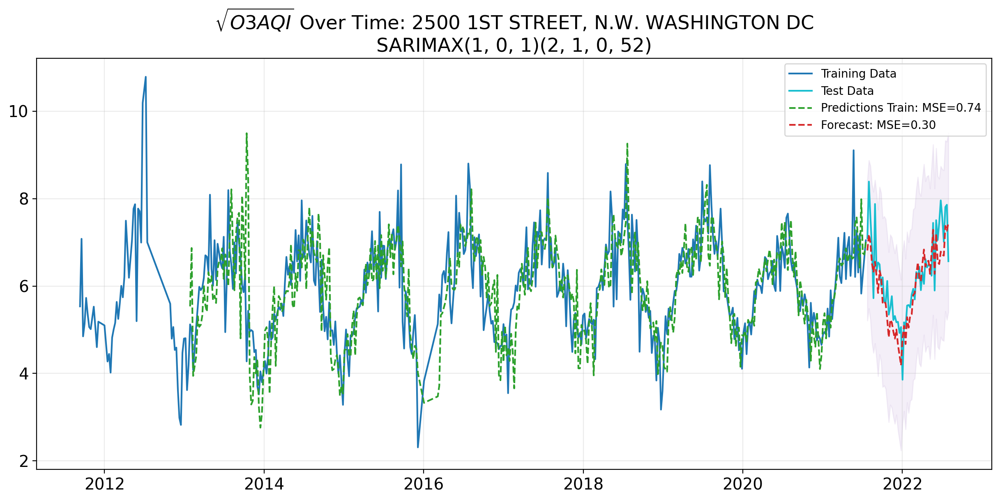

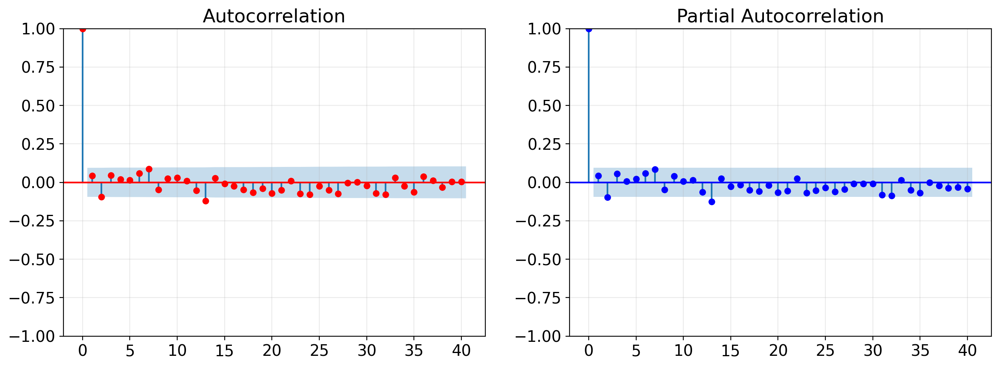

In [92]:
# Train test split starts at the end of 2021
order = (1, 0, 1)
seasonal_order = (2, 1, 0, 52)
title = f'$\sqrt{{O3 AQI}}$ Over Time: {dc_address}\nSARIMAX{order}{seasonal_order}'
mse_train, mse_test, model_fit = train_test_SARIMA_evaluate(df_dc_filled_W, 
                                                            order, 
                                                            seasonal_order, 
                                                            val_col='sqrt(O3 AQI)',
                                                            title=title,
                                                            show_summary=True, 
                                                            lags=40)


### <b> $\nabla$ <span style='border-left: 4px solid #A4D4D6; padding-left: 10px;'> Summary of SARIMA Model Fitting: `2500 1ST STREET, N.W. WASHINGTON DC`<b>

- **Model Coefficients**: The autoregressive term at lag 1, AR(1), is positive and statistically significant, which indicates a strong relationship with the immediate past value. The moving average term at lag 1, MA(1), suggests an inverse relationship with the past error. This is an interesting finding as I would have thought the past error would have caused a postive correlation with the envirnments O3 AQI values. The seasonal autoregressive terms at lags 52 and 104 are negative, which reflects an annual seasonal effect. ***Results very similar to CO model***
  
- **Model Diagnostics**: The model has a Log Likelihood of -535.391. The Ljung-Box test indicates no autocorrelation in residuals, suggesting that the model captures the data's autocorrelation structure well, though slightly less than CO model. However, the Jarque-Bera test result points to non-normality in residuals, which could affect the model’s predictive accuracy, though slightly more so than CO model. The significant result of the heteroskedasticity test suggests changing variance in residuals over time. ***Results very similar to CO model***
  
- **Residual ACF & PACF**: The autocorrelation and partial autocorrelation plots of the residuals indicate that most of the autocorrelation has been accounted for by the model, but some points do fall outside the confidence interval, which could signal model misspecifications. ***Results very similar to CO model***

<a name='alldc'>
    
## <b> 9.1 <span style='border-left: 4px solid #A4D4D6; padding-left: 10px;'> SARIMAX Model Trained On All O3 AQI Data - `2500 1ST STREET, N.W. WASHINGTON DC` </b>

<class 'statsmodels.iolib.summary.Summary'>
"""
                                     SARIMAX Results                                     
=========================================================================================
Dep. Variable:                      sqrt(O3 AQI)   No. Observations:                  536
Model:             ARIMA(1, 0, 1)x(2, 1, [], 52)   Log Likelihood                -584.786
Date:                           Sun, 10 Dec 2023   AIC                           1179.572
Time:                                   17:42:26   BIC                           1200.482
Sample:                                        0   HQIC                          1187.788
                                           - 536                                         
Covariance Type:                             opg                                         
==============================================================================
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
ar.L1          0.8694      0.036     24.194      0.000       0.799       0.940
ma.L1         -0.5356      0.057     -9.407      0.000      -0.647      -0.424
ar.S.L52      -0.6513      0.038    -17.196      0.000      -0.726      -0.577
ar.S.L104     -0.1799      0.045     -3.988      0.000      -0.268      -0.091
sigma2         0.6259      0.032     19.407      0.000       0.563       0.689
===================================================================================
Ljung-Box (L1) (Q):                   0.25   Jarque-Bera (JB):                90.92
Prob(Q):                              0.62   Prob(JB):                         0.00
Heteroskedasticity (H):               0.43   Skew:                            -0.35
Prob(H) (two-sided):                  0.00   Kurtosis:                         5.01
===================================================================================

Warnings:
[1] Covariance matrix calculated using the outer product of gradients (complex-step).
"""

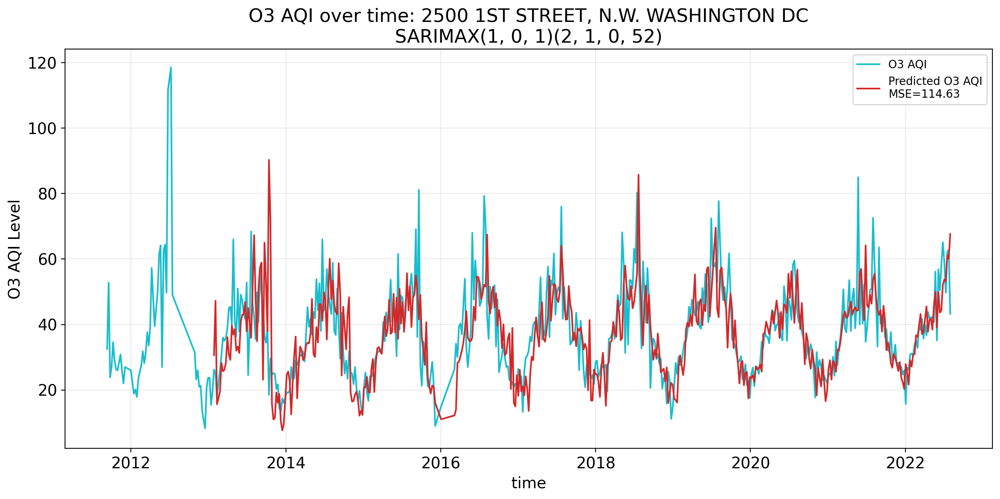

The model is causal.
The model is invertible.


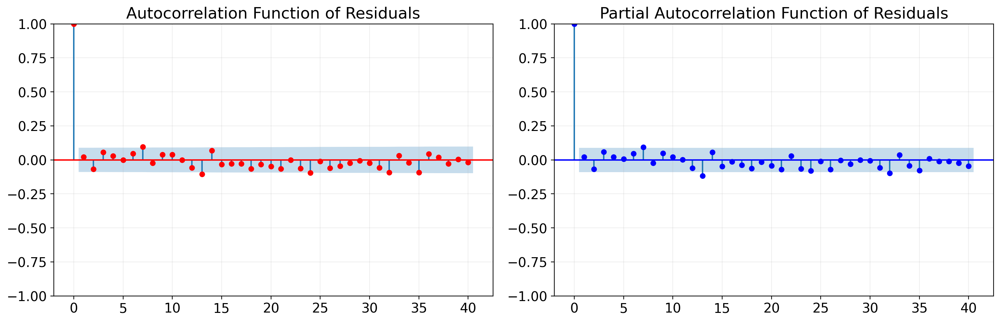

In [95]:
# Building custom ARIMA model for all data points
order = (1, 0, 1)
seasonal_order = (2, 1, 0, 52)
title = f'O3 AQI over time: {dc_address}\nSARIMAX{order}{seasonal_order}'

# Initialize and fit the model
model_dc = ARIMA(df_dc_filled_W['sqrt(O3 AQI)'], order=order, seasonal_order=seasonal_order)
model_fit_dc = model_dc.fit()
    
 # Getting fitted values
index_start_dc = max(order[1], seasonal_order[1] * seasonal_order[3])
fitted_values_dc = model_fit_dc.fittedvalues[index_start_dc:]
    
# Show  model summary
display(model_fit_dc.summary())

# Transforming to oiginal units and plotting
mse_dc, transformed_predicted_dc = transform_data(df=df_dc_filled_W, 
                                                  predicted=fitted_values_dc, 
                                                  index_start=index_start_dc,
                                                  title=title,
                                                  ylabel='O3 AQI Level',
                                                  lags=40)

# Checking for causality and invertibility
is_causal, is_invertible = check_causality_invertibility(model_fit_dc)
print(f"The model is {'causal' if is_causal else 'non-causal'}.")
print(f"The model is {'invertible' if is_invertible else 'non-invertible'}.")

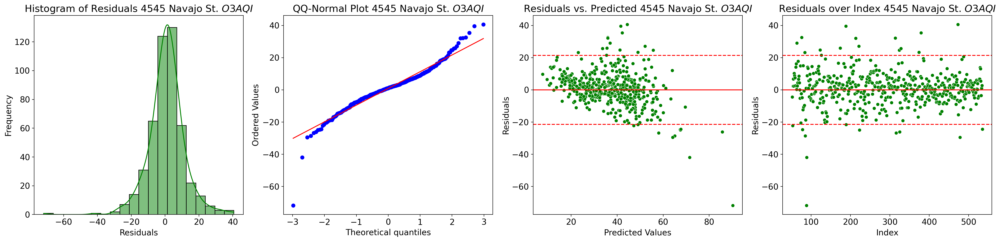

Fitted Data DC RMSE = 10.71


In [96]:
# Error Analysis for DC O3 AQI
df_rmse = model_error_analysis(df_dc_filled_W['O3 AQI'][index_start:],
                               transformed_predicted_dc,
                               title=f'{co_address} $O3 AQI$',
                               color='green')

print(f'Fitted Data DC RMSE = {df_rmse:0.2f}')

### <b> 9.1.1 <span style='border-left: 4px solid #A4D4D6; padding-left: 10px;'> Model Evaluation for Full 03 AQI Data - `2500 1ST STREET, N.W. WASHINGTON DC` </span></b>

**Model Performance Insights:**
- **Significance of Coefficients**: The AR term at 0.87 and the MA term at -0.54 remain significant, reinforcing the patterns observed in previous analyses. The negative seasonal AR coefficients align with the seasonal variations previously identified.

- **Predictive Accuracy**: An MSE of 115 reflects the model's level of predictive error, which seems reasonable considering the significant variations and oscillations in the time series data.

- **Residual Behaviors**: The Ljung-Box test result (Prob(Q) = 0.61) suggests there is no significant autocorrelation in the residuals, indicating a well-fitted model. However, the Jarque-Bera test indicates non-normality in the residuals, and a Prob(H) value of 0 signals residual heteroskedasticity, highlighting areas for potential model improvement.

- **Correlation Analysis**: The ACF and PACF plots show that the model captures the residuals adequately, with only occasional deviations beyond the confidence intervals.

- **Error Analysis**: The histogram closely resembles a normal distribution, albeit with some outliers to the left. The QQ plot generally aligns with the expected normal values, notwithstanding some divergence at the extremes. The Residuals versus Predicted Values plot exhibits signs of heteroskedasticity. In the Residuals versus Index plot, the random distribution of errors in relation to the time series model is promising, but a significant spike around index 100—which coincides with a notable `O3 AQI` emission event—warrants further investigation.

**Interesting Findings**: There is a noticeable similarity between this model's coefficients and those of the CO model, implying a general trend in modeling `O3 AQI` values over time.

<a name='dcforecast'>
    
## <b> 9.2 <span style='border-left: 4px solid #A4D4D6; padding-left: 10px;'> SARIMA Model Forecasting - `2500 1ST STREET, N.W. WASHINGTON DC` </b>


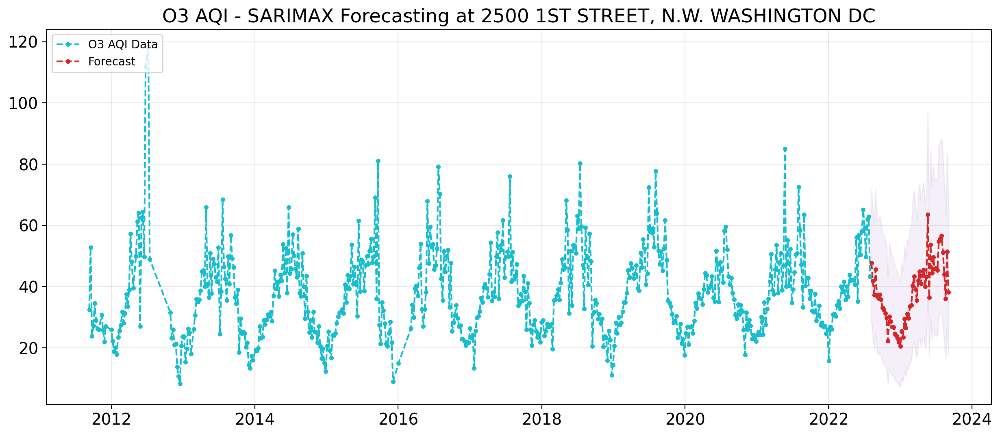

In [99]:
df_forecast_dc = forcast_SARIMAX(model_fit_dc,
                                 df_dc_filled_W, 
                                 steps=57, 
                                 val_col='O3 AQI',
                                 title=f'O3 AQI - SARIMAX Forecasting at {dc_address}',
                                 transformation=np.square
)
# display(df_forecast_dc.style.background_gradient('gray'))

### <b> 9.3.1 <span style='border-left: 4px solid #A4D4D6; padding-left: 10px;'> Forecast Analysis - `2500 1ST STREET, N.W. WASHINGTON DC` </b>

The SARIMA model's forecasts for future `O3 AQI` levels in Washington DC provide insights into potential air quality trends. Here is a summary of the findings based on the forecasted values:

- **Short-term Outlook**: The forecasted `O3 AQI` levels remain fairly stable in the short term, with occasional peaks that align with expected seasonal variations. The confidence intervals suggest that, despite uncertainty in the exact values, the overall pattern is consistent.

- **Seasonal Peaks**: The model predicts some notable peaks, particularly in the months of May through July 2023. These may correspond with seasonal factors such as temperature increases, which can lead to higher ozone formation.

- **Long-term Outlook**: The model does not show a clear worsening trend in `O3 AQI` levels over the forecast period. Instead, the levels oscillate within a range, indicating that current regulations might be adequate to maintain air quality, though continued monitoring is essential.

- **Regulatory Considerations**: Forecasted values mostly stay below thresholds typically prompting air quality warnings or regulatory actions. Nonetheless, the peaks, especially one predicted in May 2023 with an `O3 AQI` exceeding 60, could raise concerns due to the health risks associated with prolonged exposure to higher ozone levels, particularly for sensitive groups.

- **Policy Implications**: Considering the sporadic nature of the peaks and the absence of a deteriorating trend, imposing stricter pollution regulations may not be necessary at this time. However, policymakers should stay alert, particularly during anticipated peak periods, and consider temporary measures to mitigate potential public health impacts.


<a name='dcnewdata'>

## <b> 9.3 <span style='border-left: 4px solid #A4D4D6; padding-left: 10px;'> Forecast With Newly Updated Goverment Data - `2500 1ST STREET, N.W. WASHINGTON DC`</span></b>

- Below I added a quick addition due to the newly added 2023 data set!

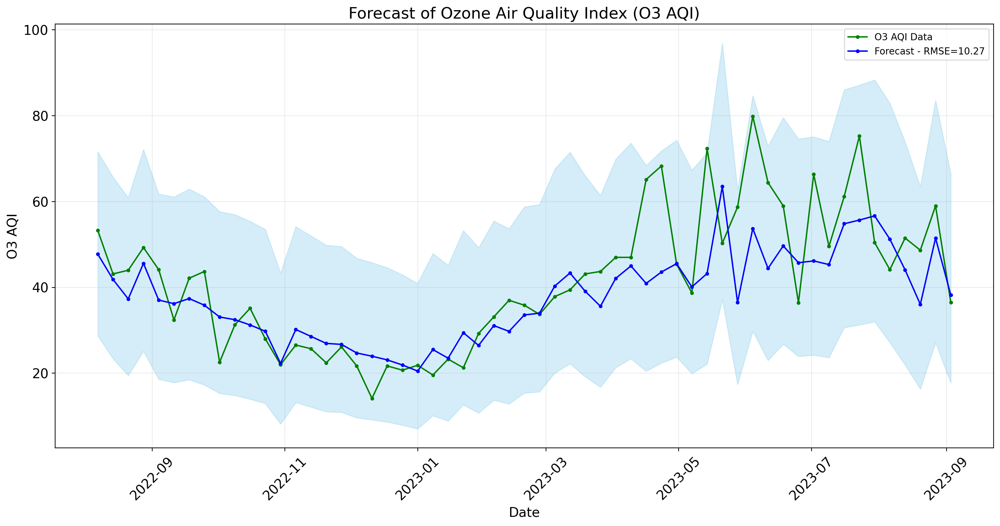

,State,O3 AQI,Forecast_O3 AQI,CI Lower,CI Upper,error
Date,,,,,,
2022-08-07 00:00:00,DC,53.285714,47.764795,28.735800,71.602693,5.520920
2022-08-14 00:00:00,DC,43.142857,41.858026,23.377922,65.682655,1.284831
2022-08-21 00:00:00,DC,44.000000,37.316696,19.476815,60.905914,6.683304
2022-08-28 00:00:00,DC,49.285714,45.602174,25.129425,72.130209,3.683541
2022-09-04 00:00:00,DC,44.142857,37.049892,18.610068,61.776233,7.092965
2022-09-11 00:00:00,DC,32.428571,36.214336,17.812093,61.077853,-3.785764
2022-09-18 00:00:00,DC,42.142857,37.399357,18.488505,62.903561,4.743500
2022-09-25 00:00:00,DC,43.714286,35.850715,17.290449,61.104157,7.863570
2022-10-02 00:00:00,DC,22.571429,33.103351,15.318628,57.656692,-10.531922


In [102]:
# Plotting the forecast with the new updated 2023 data set for CO
df_dc_test_W = compute_aggregations(df_test[df_test['Address'] == dc_address], value_columns=['O3 AQI'], time_frame='W')
new_data_df_dc = forecast_new_data(df_dc_test_W, df_forecast_dc)
display(new_data_df_dc.style.background_gradient(cmap='gray_r'))

---

<a name='HW'>
    
# <b> 10 <span style='border-left: 4px solid #A4D4D6; padding-left: 10px;'>  Holt-Winters Model Verification </b>
### <b> 10.1.1 <span style='border-left: 4px solid #A4D4D6; padding-left: 10px;'>  Mathematical Foundation of Holt-Winters Method </b>
The Holt-Winters method, also known as Triple Exponential Smoothing, extends Holt’s method by adding a seasonal component. It is designed to forecast time series data with trends and seasonal patterns. The method comprises three components: level, trend, and seasonality.

**1. Components of the Model**
- **Level ($l_t$)**: Represents the baseline value of the series.
- **Trend ($b_t$)**: Captures the direction and rate of change in the time series.
- **Seasonal ($s_t$)**: Represents the seasonal fluctuations.

**2. Equations of the Model**
The model updates these components at each time step $t$. The equations for the additive model (suitable for series where seasonal variations are roughly constant) are:

- **Level Equation**: $ l_t = \alpha (y_t - s_{t-L}) + (1 - \alpha)(l_{t-1} + b_{t-1}) $
- **Trend Equation**: $ b_t =\beta^* (l_t - l_{t-1}) + (1 -\beta^*)b_{t-1} $
- **Seasonal Equation**: $ s_t = \gamma (y_t - l_{t-1} - b_{t-1}) + (1 - \gamma)s_{t-L} $
- **Forecast Equation**: $ \hat{y}_{t+m} = l_t + mb_t + s_{t-L+1+(m-1)modL} $

Where:
- $ y_t $: Actual value at time $t$.
- $ \hat{y}_{t+m} $: Forecasted value $m$ periods ahead.
- $ \alpha, \beta^*, \gamma $: Smoothing parameters for level, trend, and seasonality, respectively.
- $ L $: Length of the seasonal cycle.

For the multiplicative model (used when seasonal variations change proportionally with the level of the series), the equations are slightly different, particularly in how the seasonal component is treated.

**3. Model Inputs and Initialization**
- **Smoothing Parameters ($\alpha \beta^*, \gamma$)**: These parameters control the rate at which the influence of the observations and estimated components decay over time. They typically range between 0 and 1.
- **Initial Estimates**: For $l_0$, $b_0$, and $s_0, s_{-1}, ..., s_{-L+1}$ (initial level, trend, and seasonal components). Proper initialization is crucial for the model's accuracy, especially for short time series.
- **Seasonal Period ($L$)**: Defines the length of the seasonal cycle, e.g., 12 for monthly data with yearly seasonality.

**4. Optimization and Model Fitting**
- **Loss Function**: Often, the Sum of Squared Errors (SSE) is used as the loss function to optimize the smoothing parameters.
- **Fitting Process**: The model fitting involves optimizing the smoothing parameters and initial estimates to minimize the loss function, typically using numerical optimization techniques.

**5. Model Assumptions and Considerations**
- **Stationarity**: Holt-Winters does not require the data to be stationary. However, the presence of a stable seasonal pattern and trend is assumed.
- **Data Frequency and Granularity**: The method requires consistent frequency and granularity (e.g., daily, monthly).
- **Outliers and Irregularities**: The model might be sensitive to outliers and abrupt changes in the time series, which can affect the accuracy of the forecasts.

[11]. Forecasting: Principles&nbsp;and&nbsp;practice (2nd&nbsp;ed). 7.3 Holt-Winters’ seasonal method. (n.d.). https://otexts.com/fpp2/holt-winters.html 

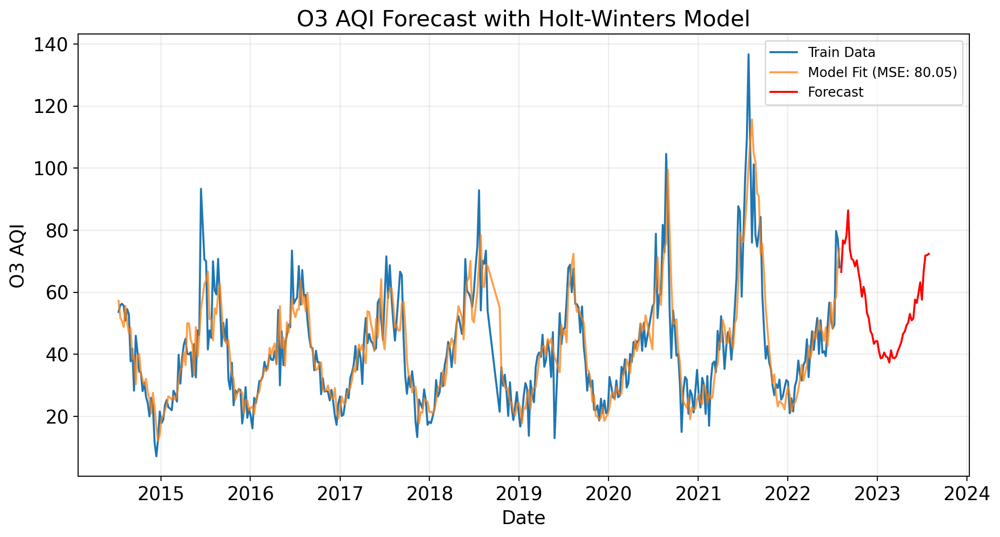

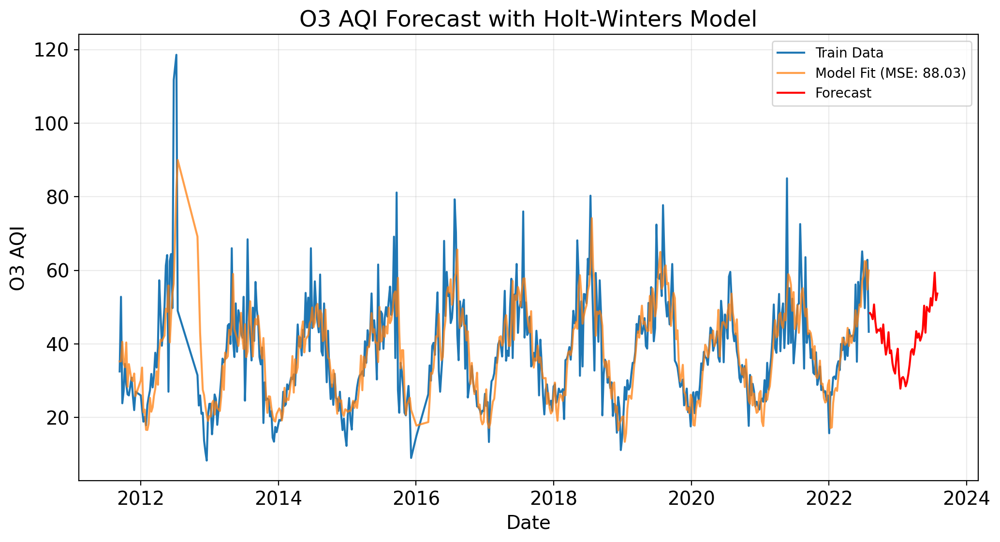

In [104]:
# For CO
model_co, mse_co, = holt_winters_forecast(df_co_filled_W,
                                          trend='add',
                                          seasonal='add',
                                          seasonal_periods=52)

# For DC
model_dc, mse_dc, = holt_winters_forecast(df_dc_filled_W,
                                          trend='add',
                                          seasonal='add',
                                          seasonal_periods=52)


### <b> 10.1.2 <span style='border-left: 4px solid #A4D4D6; padding-left: 10px;'> Holt-Winters Analysis </b>

Here, we observe that the plots, aligning with the SARIMAX plots in their overall implications that O3 AQI levels are subsiding and no immediate regulations need to be imposed, indicate a decreasing trend in the coming year. It should be noted, however, that these models were less effective on the unseen data, where a train-test split was incorporated to identify the optimal model parameters.

---

<a name='C'>
    
# <b> 11 <span style='border-left: 4px solid #A4D4D6; padding-left: 10px;'> Conclusion </b>

The focus of this project proposal is to examine changes in the Air Quality Index (AQI) levels of ground-level ozone (O3). The study's goal is to target specific addresses within regions that have experienced significant and recent increases in pollutant emissions, especially in the O3 AQI metric.


This project's analysis of the ground-level ozone O3 Air Quality Index levels, has provided insights into the air quality dynamics at two critical addresses: `4545 Navajo St., CO` and `2500 1ST STREET, N.W. WASHINGTON DC`. The study has highlighted these locations as significant areas of interest due to their marked average increase in O3 levels over the years, which could present a pressing environmental and public health concern.

<a name='findings'>
    
## <b> 11.1 <span style='border-left: 4px solid #A4D4D6; padding-left: 10px;'> Summary of Findings </b>

### <b> 11.1.1 <span style='border-left: 4px solid #A4D4D6; padding-left: 10px;'> Colorado - `4545 Navajo St.` </b>
For Colorado, the SARIMA model fitting and forecast analysis have illuminated a clear seasonal pattern, with higher `O3 AQI` levels anticipated during the warmer months. The model’s diagnostic checks suggested a good fit, capturing the seasonal effects accurately. However, the presence of heteroskedasticity in the residuals indicates that the volatility of ozone levels is not constant, necessitating further investigation and potential refinement of the model to enhance predictive capabilities. It is important to note, that the spikes that are causing this are difficult to caputure due to the randomness and largve values. Despite these concerns, the forecasts do not indicate an alarming long-term increase in `O3 AQI` levels, suggesting that while current regulations may be generally effective, a focus on seasonal peaks is critical for maintaining air quality and safeguarding health.

### <b> 11.1.2 <span style='border-left: 4px solid #A4D4D6; padding-left: 10px;'> Washington D.C. - `2500 1ST STREET, N.W.` </b>
For Washington D.C., the SARIMA model forecasts reveal a pattern of stability in `O3 AQI` levels with notable seasonal peaks, particularly in the warmer months. While the model accurately captures these seasonal trends, it does highlight some unpredictability in the volatility of ozone levels. Although no alarming long-term increase in `O3 AQI` levels is predicted, the occasional peaks, especially one significant rise anticipated in May 2023, underscore the need for continuous monitoring and targeted policies to address potential health risks during these periods. This suggests that while existing regulations are largely effective, particular attention should be given to managing these seasonal fluctuations in air quality.

<a name='compare'>
    
## <b> 11.2 <span style='border-left: 4px solid #A4D4D6; padding-left: 10px;'> Comparative Analysis </b>

### <b> 11.2.1 <span style='border-left: 4px solid #A4D4D6; padding-left: 10px;'> CO Model SARIMAX Results </b>
- Dependent Variable: `sqrt(O3 AQI)`
- Log Likelihood: -431.943, AIC: 873.887,  BIC: 893.372

| ARIMA(1, 0, 1)(2, 1, 0, 52)$_{52}$ | Coef    | Std Err | z       | P>\|z\| | [0.025 | 0.975] |
|-------------|---------|---------|---------|---------|--------|--------|
| ar.L1       | 0.8203  | 0.046   | 17.704  | 0.000   | 0.730  | 0.911  |
| ma.L1       | -0.4308 | 0.078   | -5.501  | 0.000   | -0.587 | -0.283 |
| ar.S.L52    | -0.5961 | 0.048   | -12.369 | 0.000   | -0.687 | -0.502 |
| ar.S.L104   | -0.2544 | 0.058   | -4.307  | 0.000   | -0.374 | -0.147 |
| sigma2      | 0.5934  | 0.038   | 15.672  | 0.000   | 0.520  | 0.667  |

### <b> 11.2.2 <span style='border-left: 4px solid #A4D4D6; padding-left: 10px;'> DC Model SARIMAX Results </b>
- Dependent Variable: `sqrt(O3 AQI)`
- Log Likelihood: -584.831, AIC: 1179.662, BIC: 1200.573

| ARIMA(1, 0, 1)(2, 1, 0)$_{52}$ | Coef    | Std Err | z       | P>\|z\| | [0.025 | 0.975] |
|-------------|---------|---------|---------|---------|--------|--------|
| ar.L1       | 0.8693  | 0.036   | 24.188  | 0.000   | 0.799  | 0.940  |
| ma.L1       | -0.5357 | 0.057   | -9.406  | 0.000   | -0.647 | -0.424 |
| ar.S.L52    | -0.6512 | 0.038   | -17.184 | 0.000   | -0.725 | -0.577 |
| ar.S.L104   | -0.1802 | 0.045   | -3.996  | 0.000   | -0.269 | -0.092 |
| sigma2      | 0.6260  | 0.032   | 19.401  | 0.000   | 0.563  | 0.689  |

### <b> 11.2.3 <span style='border-left: 4px solid #A4D4D6; padding-left: 10px;'> Interesting Findings </b>
The SARIMAX models for CO and DC demonstrate strikingly similar coefficient values, with those for DC being slightly higher, indicating that similar atmospheric processes may be influencing `O3 AQI` levels in both areas. Both models share a positive autoregressive term and a negative moving average term, reflecting comparable relationships between current and past `O3 AQI` values. Notably, the seasonal autoregressive terms at lags 52 and 104 are more pronounced in the DC model, hinting at a stronger seasonal impact on `O3 AQI` in Washington D.C. These consistent dynamics across different locations suggest the feasibility of a standardized approach in AQI forecasting, which can be tailored to account for local variations.

<a name='oimpact'>
    
## <b> 11.3 <span style='border-left: 4px solid #A4D4D6; padding-left: 10px;'> Overall Project Impact </b>

The project points to the importance of ongoing air quality monitoring and analysis to preemptively address health hazards associated with ozone levels. The correlation between O3 and NO2 levels emphasizes the necessity of a comprehensive approach to air quality management. The selection of the addresses was based on their significant O3 trends and the robustness of the data, which enabled a thorough analysis.

The insights gained point to the critical need for seasonal air quality monitoring and the readiness for interventions. While there may not be an immediate need for stricter regulations, the project's findings provide a data-informed basis for shaping air quality regulations and public health advisories. Reflecting on the project's conclusion, the application of SARIMA modeling has proven valuable, contributing to the broader efforts to understand and enhance air quality, ultimately promoting healthier environments for communities in both Colorado and Washington D.C.


**References**<br>
[1]: Impact of wildfires on O3 pollution. [Science.org](https://www.science.org/doi/10.1126/sciadv.abi4892)  
[2]: Predicted changes in ground-level ozone in the US. [PubMed Central](https://www.ncbi.nlm.nih.gov/pmc/)  
[3]: Source: U.S. Environmental Protection Agency. "National Ambient Air Quality Standards (NAAQS)." [Ambient Air Quality](https://www.epa.gov/criteria-air-pollutants/naaqs-table)  
[4]: Health effects of ozone in the general population. [Health effects of ozone](https://www.epa.gov/ozone-pollution-and-your-patients-health/health-effects-ozone-general-population)  
[5]: Ozone Pollution Trends. [American Lung Association](https://www.lung.org/research/sota/city-rankings/most-polluted-cities)  
[6]: Ground-level Ozone Basics. [Ground-level Ozone](https://www.epa.gov/ground-level-ozone-pollution/ground-level-ozone-basics)  
[7]: AQI Basics. [AirNow.gov](https://www.airnow.gov/aqi/aqi-basics/)
[8]: Impact of wildfires on O3 pollution. [Science.org](https://www.science.org/doi/10.1126/sciadv.abi4892)  
[9]: Health effects of ozone in the general population. [ Health effects of ozone](https://www.epa.gov/ozone-pollution-and-your-patients-health/health-effects-ozone-general-population)  
[10]: Ground-level Ozone Basics. [Ground-level Ozone](https://www.epa.gov/ground-level-ozone-pollution/ground-level-ozone-basics) <br>
[11]: Forecasting: Principles&nbsp;and&nbsp;practice (2nd&nbsp;ed). 7.3 Holt-Winters’ seasonal method. (n.d.). https://otexts.com/fpp2/holt-winters.html 

---

<a name='B'>

# $\nabla$ <span style='border-left: 4px solid #A4D4D6; padding-left: 10px;'> Table of Contents </span>
1. [`Introduction`](#ES)
   * 1.1 [`Study Importance`](#studyimportance)
   * 1.2 [`Problem Statement`](#problemstatement)
   * 1.3 [`Focus & Objectives`](#focus)
   * 1.4 [`Summary & Main Findings`](#summaryfindings)
2. [`About The Data`](#data)
   * 2.1 [`Column Descriptions`](#columndescriptions)
   * 2.2 [`Monitoring Air Quality`](#sigmon)
   * 2.3 [`Focus & Objectives`](#focus)
   * 2.4 [`Health Impact of Pollutants`](#healthimpace)
3. [`Imports & Setup`](#imports)
    * 3.1 [`Data Manipulation Functions`](#DMF)
    * 3.2 [`Data Visualization Functions`](#DVF)
    * 3.3 [`Time Series Visualization Functions`](#TSAF)
    * 3.4 [`Machine Learning Model Functions`](#MLF)
    * 3.5 [`Importing Data`](#gettingdata)
4. [`Polution Slope Analysis`](#SA)
5. [`Address-Specific Data Analysis`](#ASEDA)
    * 5.1 [`Correlation on Addresses`](#coradd)
    * 5.2 [` Distributions of Pollutants at Addresse`](#distpopadd)
6. [`Exploratory Data Analysis By Year`](#EDAYEAR)
    * 6.1 [`Max USA Heatmap`](#usaheatmap)
7. [`Time Series Analysis`](#TS)
    * 7.1 [`Time Series Missing Recorded Values`](#missvalues)
    * 7.2 [`Time Series Analysis of Transformation`](#transformation)
    * 7.3 [`Decomposition - Time Frame Weekly`](#weekly)
    * 7.4 [`Stationarity Test on Columns`](#stationarity)
8. [`Time Series Modeling CO`](#TSCO)
    * 8.1 [`Modeling on All Data`](#sarimaxallco)
    * 8.2 [`Forecasting`](#coforecast)
    * 8.3 [`Forecast Against New Data`](#conewdata)
9. [`Time Series Modeling DC`](#TSDC)
    * 9.1 [`Modeling on All Data`](#alldc)
    * 9.2 [`Forecasting`](#dcforecast)
    * 9.3 [`Forecast Against New Data`](#dcnewdata)
10. [`Holt-Winters Verification`](#HW)
11. [`Conclusions`](#C)
    * 11.1 [`Summary of Findings`](#findings)
    * 11.2 [`Comparative Analysis`](#compare)
    * 11.3 [`Overall Project Impact`](#oimpact)
13. [`Top`](#T)

Author: [Math & Physics Fun with Gus](https://mathphysicsfunwithgus.square.site)

---